# Make plots for paper

## Import relevant modules

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
import matplotlib.lines as mlines
import matplotlib.gridspec as gridspec
import pandas as pd
import seaborn as sns

# from ltsfit.ltsfit import ltsfit
from sklearn.metrics import r2_score
from scipy.stats import norm

from astropy.io import fits
from ppxf.ppxf import ppxf
import ppxf.ppxf_util as util
import ppxf.sps_util as lib

from pathlib import Path
from urllib import request
from os.path import exists
from copy import copy

from scripts.ned_calculator import NedCalculator

## Functions that I need

In [2]:
def read_fits_summary(fitsfile):
    
    hdu = fits.open(fitsfile)

    age_grid = hdu['age_grid'].data
    weights = hdu['pp_weights'].data.reshape(hdu['reg_dim'].data)

    name = hdu[0].header['name']
    z = hdu[0].header['z']
    hdu.close()
    del hdu

    wei1 = weights.sum(axis=1)
    wei1/=wei1.sum()

    wei1_rev = copy(wei1[::-1])

    ages = age_grid[:,0]

    weiplot = np.cumsum(wei1_rev)

    nedcalc = NedCalculator([z])
    univ_age = nedcalc.zage_Gyr

    ages1 = univ_age - ages

    agesplot = np.concatenate([np.array([univ_age]), ages1, np.array([0.])])
    weiplot = np.concatenate([np.array([0.]), weiplot, np.array([weiplot[-1]])])

    agesplot = copy(agesplot[::-1])
    
    return name,z,agesplot,weiplot,univ_age

In [3]:
def read_fits_summary_metal(fitsfile):
    
    hdu = fits.open(fitsfile)

    age_grid = hdu['age_grid'].data
    metal_grid = hdu['metal_grid'].data
    weights = hdu['pp_weights'].data.reshape(hdu['reg_dim'].data)

    name = hdu[0].header['name']
    z = hdu[0].header['z']
    hdu.close()
    del hdu

    ages = age_grid[:,0]
    metals = metal_grid[0,:]

    weights_rev = copy(weights[::-1,:])

    wei1 = []
    weiplot = []

    for i in range(len(ages)):
        x = np.sum([weights_rev[i,j]*metals[j] for j in range(len(metals))], axis=0)
        wei1.append(x)
        if np.sum(weights_rev[:i+1,:]) != 0:
            weiplot.append(np.sum(wei1)/np.sum(weights_rev[:i+1,:])) 
        else:
            weiplot.append(np.nan)

    nedcalc = NedCalculator([z])
    univ_age = nedcalc.zage_Gyr

    ages1 = univ_age - ages

    agesplot = np.concatenate([np.array([univ_age]), ages1])
    weiplot = np.concatenate([weiplot, np.array([weiplot[-1]])])

    agesplot = copy(agesplot[::-1])
    
    return name,z,agesplot,weiplot,univ_age

In [4]:
def plot_sfh(ax,fitsfile,col_line,legend_on=False, linestyle='-'):
    
    name,z,agesplot,weiplot,univ_age = read_fits_summary(fitsfile)

    # ax.set_title(name,fontsize=18,weight='bold')
    ax.set_xlim(0,13.5)
    ax.set_ylim(-0.05,1.05)
    ax.set_xlabel('Time since BB (Gyr)',fontsize=15)
    ax.set_ylabel(r'Cumulative mass \%',fontsize=15)
    ax.minorticks_on()
    ax.tick_params(axis='both',which='both',direction='in',labelsize=15)
    
    ax.axhline(0.75,color='gray',alpha=0.2)
    ax.text(12,0.76,r'75\%',style='italic',color='gray')
    ax.axhline(0.95,color='gray',alpha=0.2)
    ax.text(12,0.96,r'95\%',style='italic',color='gray')
    ax.axvline(3.,color='gray',alpha=0.2,linestyle='-.',linewidth=2.)
    ax.axvline(univ_age,color='gray',linestyle='-.',linewidth=2.)
    
    ax.plot(agesplot,weiplot,color=col_line,linewidth=3.,linestyle=linestyle)
    
    ax.text(univ_age-0.1,0.,'today',color='gray',style='italic',rotation=90,horizontalalignment='right')
    ax.text(2.9,0.,r'z$\sim$2',style='italic',color='gray',rotation=90,horizontalalignment='right')
    ax.set_xticks([0.,2.,4.,6.,8.,10.,12.])
    
    if legend_on==True:
        ax.legend(frameon=False,bbox_to_anchor=(univ_age/ax.get_xlim()[1], -0.05),loc='lower right',prop={'size':12,'weight':'bold'},labelspacing=0.1,labelcolor='linecolor')
        
    return agesplot,weiplot

In [5]:
def plot_meh(ax,fitsfile,col_line,legend_on=False, linestyle='-'):

    name,z,agesplot,weiplot,univ_age = read_fits_summary_metal(fitsfile)

    # ax.set_title(name,fontsize=18,weight='bold')
    ax.set_xlim(0,13.5)
    ax.set_xlabel('Time since BB (Gyr)',fontsize=15)
    ax.set_ylabel('Metallicity',fontsize=15)
    ax.minorticks_on()
    ax.tick_params(axis='both',which='both',direction='in',labelsize=15)

    ax.axvline(univ_age,color='gray',linestyle='-.',linewidth=2.)
    ax.axvspan(0.,0.5,color='0.3')

    ax.plot(agesplot,weiplot,color=col_line,linewidth=3.,linestyle=linestyle)
    
    # ax.text(univ_age-0.1,0.4,'today',color='gray',style='italic',rotation=90,horizontalalignment='right')
    ax.set_xticks([0.,2.,4.,6.,8.,10.,12.])

    if legend_on==True:
        ax.legend(frameon=False,bbox_to_anchor=(univ_age/ax.get_xlim()[1], -0.05),loc='lower right',prop={'size':12,'weight':'bold'},labelspacing=0.1,labelcolor='linecolor')

    return agesplot,weiplot

In [6]:
def read_fits_summary2(fitsfile):
    
    hdu = fits.open(fitsfile)
    
    age_grid = hdu['age_grid'].data
    weights = hdu['pp_weights'].data.reshape(hdu['reg_dim'].data)
    
    name = hdu[0].header['name']
    z = hdu[0].header['z']
    hdu.close()
    del hdu
    
    wei1 = weights.sum(axis=1)
    wei1/=wei1.sum()
    
    wei1_rev = copy(wei1[::-1])
    
    ages = age_grid[:,0]
    ages1 = (ages[-1]-ages)[::-1]+(ages[1]-ages[0])
    
    agesplot = np.concatenate([np.array([0.]),ages1])
    weiplot = np.concatenate([np.array([0.]),np.cumsum(wei1_rev)])
    
    agesplot = np.concatenate([agesplot,np.array([agesplot[-1]+(agesplot[-1]-agesplot[-2])])])
    weiplot = np.concatenate([weiplot,np.array([weiplot[-1]])])
    
    nedcalc = NedCalculator([z])
    univ_age = nedcalc.zage_Gyr
    
    agesplot = [a if a<univ_age else univ_age for a in agesplot]
    
    return name,z,agesplot,weiplot,univ_age

In [7]:
def line2p(p1,p2,x):
    
    x1,y1 = p1
    x2,y2 = p2
    
    m = (y2-y1)/(x2-x1)
    q = -(y2-y1)/(x2-x1)*x1+y1
    
    return m*x+q

def line2p_rev(p1,p2,y):
    
    x1,y1 = p1
    x2,y2 = p2
    
    return (y-y1)/(y2-y1)*(x2-x1)+x1 if y2!=y1 else x2
    
def get_values_from_sfh(univ_age,sfh_table,ycol):
    '''
    INPUTS:
        univ_age: the age of the universe at the redshift of the galaxy in Gyr
        sfh_table: the plotted sfh in the form of a pandas DataFrame. It needs to have a column named "time"
        ycol: is the name of the column of the sfh_table we want to use in order to retrieve the different values we want to compute
    
    OUTPUTS:
        y_z2: mass formed at redshift~2
        x_025: time to form 25% of the mass (t_25)
        x_075: time to form 75% of the mass (t_75)
        x_090: time to form 90% of the mass (t_90)
        x_100: time to form 100% of the mass (t_fin)
        dor_90: Degree of Relicness using x_090
        dor_100: : Degree of Relicness using x_100
        
    '''
    
    tt = []
    tt25 = []
    tt90 = []
    tt100 = []

    ii=0
    while sfh_table.iloc[ii][ycol]<0.25:
        tt25.append((ii,sfh_table.iloc[ii][ycol]))
        ii+=1
    tt25.append((ii,sfh_table.iloc[ii][ycol]))
    
    yy25 = sfh_table.iloc[np.array(tt25[-2:])[:,0]]
    
    xx25 = line2p_rev(yy25[['time',ycol]].iloc[0].values,yy25[['time',ycol]].iloc[1].values,0.25)
    
    ii=0
    while sfh_table.iloc[ii][ycol]<0.75:
        tt.append((ii,sfh_table.iloc[ii][ycol]))
        ii+=1
    tt.append((ii,sfh_table.iloc[ii][ycol]))
    
    yy = sfh_table.iloc[np.array(tt[-2:])[:,0]]
    
    xx = line2p_rev(yy[['time',ycol]].iloc[0].values,yy[['time',ycol]].iloc[1].values,0.75)
    
    ii=0
    while sfh_table.iloc[ii][ycol]<0.9 :
        tt90.append((ii,sfh_table.iloc[ii][ycol]))
        ii+=1
    tt90.append((ii,sfh_table.iloc[ii][ycol]))
    
    yy90 = sfh_table.iloc[np.array(tt90[-2:])[:,0]]
    
    xx90 =  line2p_rev(yy90[['time',ycol]].iloc[0].values,yy90[['time',ycol]].iloc[1].values,0.9)
    
    ii=0
    while sfh_table.iloc[ii][ycol]<0.998 :
        tt100.append((ii,sfh_table.iloc[ii][ycol]))
        ii+=1
    tt100.append((ii,sfh_table.iloc[ii][ycol]))
    
    yy100 = sfh_table.iloc[np.array(tt100[-2:])[:,0]]
    
    xx100 =  line2p_rev(yy100[['time',ycol]].iloc[0].values,yy100[['time',ycol]].iloc[1].values,0.998)
    
    tt_rev = [(0,0)]
    
    for i in range(1,len(sfh_table['time'])):
        
        p1 = sfh_table['time'].iloc[i-1],sfh_table[ycol].iloc[i-1]
        p2 = sfh_table['time'].iloc[i],sfh_table[ycol].iloc[i]
        
        xs = np.arange(sfh_table['time'].iloc[i-1],sfh_table['time'].iloc[i]+0.1,0.1)
        ys = line2p(p1,p2,xs)

                
        for x,y in zip(xs,ys):
            tt_rev.append((round(x,2),y))


    tt_rev = np.array(tt_rev)

    # this is the mass formed at redshift ~2
    y_z2 = round(tt_rev[:,1][np.where(tt_rev[:,0]==2.9)[0]][0],5)
    
    # these are the times at 75%, 90%, and 100% formed mass
    x_025 = round(xx25,5)
    x_075 = round(xx,5)
    x_090 = round(xx90,5)
    x_100 = round(xx100,5)
    
    dor_90 = (y_z2+0.5/x_075+(0.7+(univ_age-x_090)/univ_age))/3
    dor_100 = (y_z2+0.5/x_075+(0.7+(univ_age-x_100)/univ_age))/3
    
    return y_z2,x_025,x_075,x_090,x_100,dor_90,dor_100

## Import final catalogue

In [8]:
df = pd.read_csv('/Users/johnmills/Summer project/DoR_fit/ppxf_stel_pop_dor_final.csv')
# df = pd.read_csv('../outputs/stacked_catalogues/CATALOGUE_REGRESSION.csv')
df.head()

,ra,dec,deVRad_r,deVRadErr_r,expRad_r,expRadErr_r,z,zErr,velDisp,velDispErr,...,delta_t_minus,delta_t,delta_t_mean,dor_mean,t_ass_err,dor_99,dor_95,dor_med,meanRad_kids,meanRadkpc_kids
0,155.546223,38.530429,0.855156,0.015557,0.927259,0.006479,0.056291,0.000015,219.8827,6.701266,...,0.74834,0.88442,0.739670,0.734761,0.193405,0.750072,0.779899,0.759521,0.445299,0.502996
1,147.939325,6.002015,0.456404,0.011488,0.570400,0.016483,0.092395,0.000030,212.3334,11.412500,...,1.47966,2.08061,1.328772,0.459554,0.051996,0.473318,0.583442,0.463584,0.251050,0.446138
2,195.890252,19.302545,0.763138,0.011178,0.797237,0.007421,0.063738,0.000019,261.3901,7.754551,...,0.69988,0.87444,0.640537,0.671765,0.265380,0.702579,0.787819,0.660890,0.401239,0.508679
3,160.135430,44.946745,0.488847,0.015895,0.517970,0.013438,0.088387,0.000023,251.5595,10.058470,...,0.52843,0.59399,0.422900,0.790009,0.172266,0.737809,0.783162,0.816906,0.250774,0.428307
4,337.949876,2.630884,0.872284,0.018979,0.804368,0.008254,0.059938,0.000012,231.3389,5.001307,...,0.61388,0.82393,0.631105,0.789603,0.040935,0.741042,0.784542,0.809484,0.452954,0.542446


In [10]:
df['velDisp_ppxf_err'] = df['velDisp_ppxf']*0.1
df['velDisp_ppxf_err_res'] = df['velDisp_ppxf_res']*0.1

df.loc[df['SNR']>30, 'velDisp_ppxf_err'] = df.loc[df['SNR']>30, 'velDisp_ppxf']*0.05
df.loc[df['SNR']>30, 'velDisp_ppxf_err_res'] = df.loc[df['SNR']>30, 'velDisp_ppxf_res']*0.05

In [11]:
df_inspire = pd.read_csv('/Users/johnmills/Summer project/INSPIRE_copy_CATALOGUE_24_06_24.csv')
df_inspire.head()

,ID_INSPIRE,RAJ2000,DECJ2000,DR_INSPIRE,zspec_XSH,ageUni_at_z,Reff_median_KIDS_kpc,Mstar(10^11),Vdisp_XSH,err_Vdisp_XSH,...,err_MgFe_plus,err_MgFe_minus,TiFe,err_TiFe_plus,err_TiFe_minus,NaFe,err_NaFe_plus,err_NaFe_minus,golden,t_ass_err
0,J1438-0127,219.521888,-1.458273,3,0.2861,1.040000e+10,1.201263,0.878203,218,1.9,...,0.04,-0.04,0.19,0.07,-0.15,-0.16,0.08,-0.08,1,0.105769
1,J1412-0020,213.003828,-0.344070,3,0.2783,1.050000e+10,1.424173,1.198007,339,3.7,...,0.03,-0.01,-0.19,0.08,-0.05,0.28,0.01,-0.04,0,0.391221
2,J0224-3143,36.090265,-31.724492,1,0.3839,9.520000e+09,1.548853,2.710026,283,1.0,...,0.05,-0.04,-0.26,0.04,-0.02,0.28,0.01,-0.03,1,0.388248
3,J2356-3332,359.126125,-33.533475,2,0.3389,9.920000e+09,1.058850,0.975350,162,6.0,...,0.05,-0.07,0.09,0.13,-0.19,0.13,0.09,-0.10,1,0.393145
4,J0918+0122,139.644643,1.379478,1,0.3731,9.610000e+09,1.707255,2.262889,242,2.0,...,0.05,-0.05,-0.24,0.08,-0.04,0.21,0.05,-0.04,1,0.415800


## Plots, plots, and more plots...

In [10]:
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "Computer Modern",
    "figure.dpi": 300,
    "font.size": 15,
})

sig_int:     0.0000     -0.7388
No intrinsic scatter or errors overestimated
Repeating at best fitting solution
sig_int:     0.0000     -0.7388

################# Values and formal errors ################

        a =  241.8 +/- 1.1
      b_0 =  1.162 +/- 0.038
  scatter =  0. +/- 0.0
Observed rms scatter: 13.7
y = a + (x_0 - p_0) b_0
   p_0 = 233.0
Adopted clip = 2.60*sigma; Fitted/Clipped = 409/21
Non-clipped Spearman r = 0.88 and p = 4.7e-137
Non-clipped Pearson r = 0.88 and p = 1.7e-141
Execution time 0.88 s

###########################################################

sig_int:     0.0000     -0.9557
No intrinsic scatter or errors overestimated
Repeating at best fitting solution
sig_int:     0.0000     -0.9557

################# Values and formal errors ################

        a =  245.9 +/- 1.5
      b_0 =  1.049 +/- 0.043
  scatter =  0. +/- 0.0
Observed rms scatter: 6.99
y = a + (x_0 - p_0) b_0
   p_0 = 242.0
Adopted clip = 2.60*sigma; Fitted/Clipped = 401/29
Non-clipped Spear

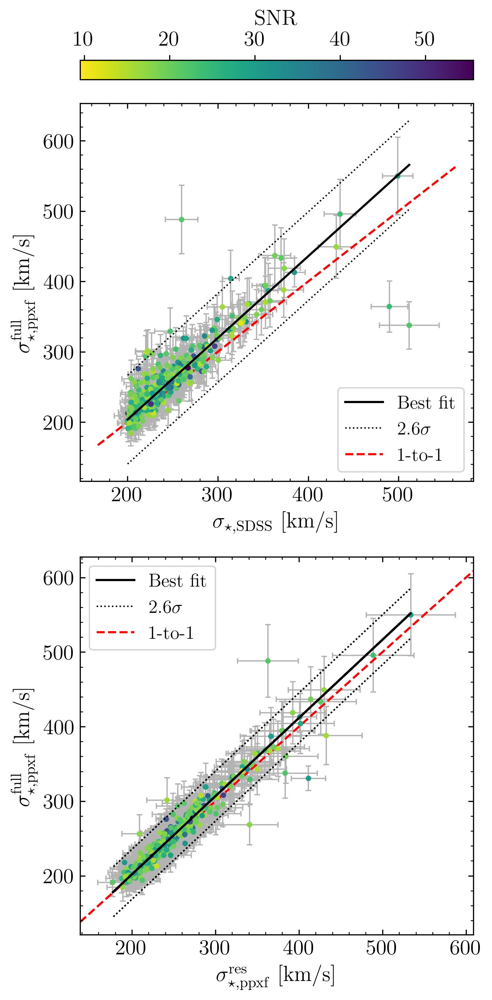

In [13]:
"""fig, axs = plt.subplots(2, 1, figsize=(5,10), height_ratios=[1.25, 1])

axs[0].errorbar(df['velDisp'],df['velDisp_ppxf'], yerr=df['velDisp_ppxf_err'], xerr=df['velDispErr'], 
            fmt='none', c='0.7', zorder=0, capsize=2, elinewidth=0.9, capthick=0.9)
pc = axs[0].scatter(df['velDisp'], df['velDisp_ppxf'],c=df['SNR'], s=8, cmap='viridis_r')

axs[0].set_xlabel(r'$\sigma_{\star,\mathrm{SDSS}}$ [km/s]')
axs[0].set_ylabel(r'$\sigma_{\star,\mathrm{ppxf}}^{\mathrm{full}}$ [km/s]');
axs[0].tick_params(axis='both',which='both',direction='in', right=True, top=True)
axs[0].minorticks_on()


p = ltsfit(df['velDisp'].to_numpy(), df['velDisp_ppxf'].to_numpy(), df['velDispErr'].to_numpy(), df['velDisp_ppxf_err'].to_numpy(),
           clip=2.6, corr=True, epsy=True, frac=0.5, label='Fitted', 
           label_clip='Clipped', legend=True, pivot=np.round(np.median(df['velDisp'].to_numpy())), plot=False, 
           text=True)

a, b = p.coef
y = a + (df['velDisp'] - np.round(np.median(df['velDisp'].to_numpy())))*b
diffs = df['velDisp_ppxf'] - y
std = np.std(diffs)

axs[0].plot([df['velDisp'].min(), df['velDisp'].max()], [y.min(), y.max()], c='k', ls='-', label='Best fit')
axs[0].plot([df['velDisp'].min(), df['velDisp'].max()], [y.min()+2.6*std, y.max()+2.6*std], c='k', ls='dotted', lw=1, label=r'2.6$\sigma$')
axs[0].plot([df['velDisp'].min(), df['velDisp'].max()], [y.min()-2.6*std, y.max()-2.6*std], c='k', ls='dotted', lw=1)

xlim = axs[0].get_xlim()
ylim = axs[0].get_ylim()
lims = [np.max([xlim[0], ylim[0]]), np.min([xlim[1], ylim[1]])]
axs[0].plot(xlim, xlim, 'r--', label='1-to-1', zorder=0)

# axs[0].set_xscale('log')
# axs[0].set_yscale('log')

axs[0].legend(fontsize=13)


###########################################################################################################################

axs[1].errorbar(df['velDisp_ppxf_res'],df['velDisp_ppxf'], yerr=df['velDisp_ppxf_err'], xerr=df['velDisp_ppxf_err_res'], 
            fmt='none', c='0.7', zorder=0, capsize=2, elinewidth=0.9, capthick=0.9)
axs[1].scatter(df['velDisp_ppxf_res'], df['velDisp_ppxf'],c=df['SNR'], s=8, cmap='viridis_r')
#axs[1].axline((200, 200), slope=1, c='k', ls='--')

axs[1].set_xlabel(r'$\sigma_{\star,\mathrm{ppxf}}^{\mathrm{res}}$ [km/s]')
axs[1].set_ylabel(r'$\sigma_{\star,\mathrm{ppxf}}^{\mathrm{full}}$ [km/s]');
axs[1].tick_params(axis='both',which='both',direction='in', right=True, top=True)
axs[1].minorticks_on()

p = ltsfit(df['velDisp_ppxf_res'].to_numpy(), df['velDisp_ppxf'].to_numpy(), df['velDisp_ppxf_err_res'].to_numpy(), df['velDisp_ppxf_err'].to_numpy(),
           clip=2.6, corr=True, epsy=True, frac=0.5, label='Fitted', 
           label_clip='Clipped', legend=True, pivot=np.round(np.median(df['velDisp_ppxf_res'].to_numpy())), plot=False, 
           text=True)

a, b = p.coef
y = a + (df['velDisp_ppxf_res'] - np.round(np.median(df['velDisp_ppxf_res'].to_numpy())))*b
diffs = df['velDisp_ppxf'] - y
std = np.std(diffs)

axs[1].plot(df['velDisp_ppxf_res'], y, c='k', ls='-', label='Best fit')
axs[1].plot(df['velDisp_ppxf_res'], y + 2.6*std, c='k', ls='dotted', lw=1, label=r'2.6$\sigma$')
axs[1].plot(df['velDisp_ppxf_res'], y - 2.6*std, c='k', ls='dotted', lw=1)
axs[1].axline((200, 200), slope=1, c='r', ls='--', label='1-to-1', zorder=0)

axs[1].legend(fontsize=13)
# mask = np.abs(diffs) > 2.6 * std
# axs[1].scatter(df['velDisp_ppxf_res'][mask], df['velDisp_ppxf'][mask], c='r')
# print(df['SNR'][mask])

###########################################################################################################################

fig.colorbar(pc, label='SNR', location='top');
plt.tight_layout()

plt.savefig('/Users/johnmills/Summer project/paper_plots/sigmas2.pdf', bbox_inches='tight', dpi=300)"""

sig_int:     0.0000     -0.7527
No intrinsic scatter or errors overestimated
Repeating at best fitting solution
sig_int:     0.0000     -0.7527

################# Values and formal errors ################

        a =  1.976 +/- 0.013
      b_0 =  1.109 +/- 0.033
  scatter =  0. +/- 0.0
Observed rms scatter: 0.0224
y = a + (x_0 - p_0) b_0
   p_0 = 2.000
Adopted clip = 2.60*sigma; Fitted/Clipped = 404/26
Non-clipped Spearman r = 0.88 and p = 4.7e-137
Non-clipped Pearson r = 0.89 and p = 4.1e-151
Execution time 0.70 s

###########################################################

sig_int:     0.0000     -0.9563
No intrinsic scatter or errors overestimated
Repeating at best fitting solution
sig_int:     0.0000     -0.9563

################# Values and formal errors ################

        a =  1.996 +/- 0.015
      b_0 =  1.029 +/- 0.038
  scatter =  0. +/- 0.0
Observed rms scatter: 0.0118
y = a + (x_0 - p_0) b_0
   p_0 = 2.000
Adopted clip = 2.60*sigma; Fitted/Clipped = 400/30
Non-clipp

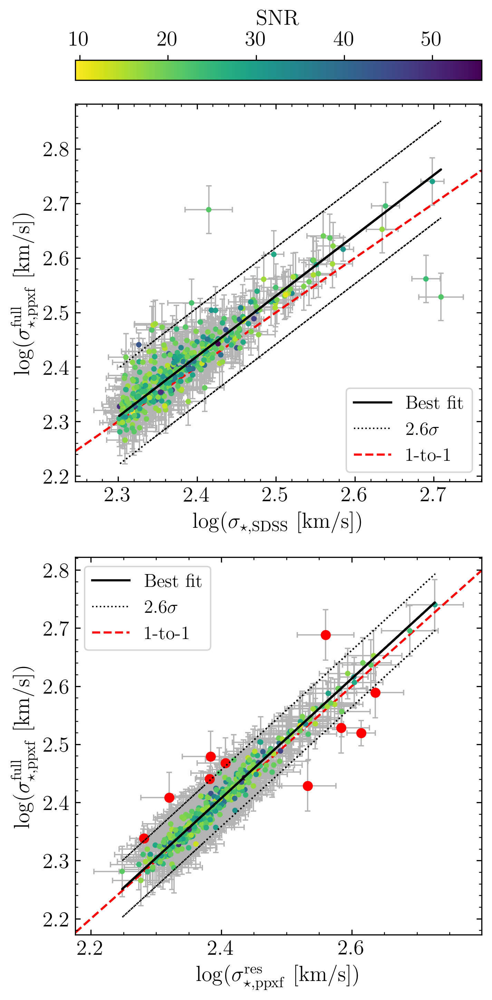

In [14]:
"""fig, axs = plt.subplots(2, 1, figsize=(5,10), height_ratios=[1.25, 1])

clip=2.6

x = np.log10(df['velDisp'])
y = np.log10(df['velDisp_ppxf'])
yerr = (df['velDisp_ppxf_err']/df['velDisp_ppxf'])/np.log(10)
xerr = (df['velDispErr']/df['velDisp'])/np.log(10)

axs[0].errorbar(x,y, yerr=yerr, xerr=xerr, 
            fmt='none', c='0.7', zorder=0, capsize=2, elinewidth=0.9, capthick=0.9)
pc = axs[0].scatter(x, y, c=df['SNR'], s=8, cmap='viridis_r')

axs[0].set_xlabel(r'$\log(\sigma_{\star,\mathrm{SDSS}}$ [km/s])')
axs[0].set_ylabel(r'$\log(\sigma_{\star,\mathrm{ppxf}}^{\mathrm{full}}$ [km/s])');
axs[0].tick_params(axis='both',which='both',direction='in', right=True, top=True)
axs[0].minorticks_on()

p = ltsfit(x.to_numpy(), y.to_numpy(), xerr.to_numpy(), yerr.to_numpy(),
           clip=clip, corr=True, epsy=True, frac=0.5, label='Fitted', 
           label_clip='Clipped', legend=True, pivot=np.round(np.median(x.to_numpy())), plot=False, 
           text=True)

a, b = p.coef
yfit = a + (x - np.round(np.median(x.to_numpy())))*b
diffs = y - yfit
std = np.std(diffs)

axs[0].plot(x, yfit, c='k', ls='-', label='Best fit')
axs[0].plot(x, yfit + clip*std, c='k', ls='dotted', lw=1, label=fr'{clip}$\sigma$')
axs[0].plot(x, yfit - clip*std, c='k', ls='dotted', lw=1)
axs[0].axline((2.6, 2.6), slope=1, c='r', ls='--', label='1-to-1', zorder=0)
# mask = np.abs(diffs) > 2.6 * std
# axs[0].scatter(x[mask], y[mask], c='r')
# print(df['SNR'][mask])

axs[0].legend(fontsize=13)

###########################################################################################################################

x = np.log10(df['velDisp_ppxf_res'])
y = np.log10(df['velDisp_ppxf'])
yerr = (df['velDisp_ppxf_err']/df['velDisp_ppxf'])/np.log(10)
xerr = (df['velDisp_ppxf_err_res']/df['velDisp_ppxf_res'])/np.log(10)

axs[1].errorbar(x,y, yerr=yerr, xerr=xerr, 
            fmt='none', c='0.7', zorder=0, capsize=2, elinewidth=0.9, capthick=0.9)
axs[1].scatter(x, y, c=df['SNR'], s=8, cmap='viridis_r')

axs[1].set_xlabel(r'$\log(\sigma_{\star,\mathrm{ppxf}}^{\mathrm{res}}$ [km/s])')
axs[1].set_ylabel(r'$\log(\sigma_{\star,\mathrm{ppxf}}^{\mathrm{full}}$ [km/s])');
axs[1].tick_params(axis='both',which='both',direction='in', right=True, top=True)
axs[1].minorticks_on()

p = ltsfit(x.to_numpy(), y.to_numpy(), xerr.to_numpy(), yerr.to_numpy(),
           clip=2.6, corr=True, epsy=True, frac=0.5, label='Fitted', 
           label_clip='Clipped', legend=True, pivot=np.round(np.median(x.to_numpy())), plot=False, 
           text=True)

a, b = p.coef
yfit = a + (x - np.round(np.median(x.to_numpy())))*b
diffs = y - yfit
std = np.std(diffs)

axs[1].plot(x, yfit, c='k', ls='-', label='Best fit')
axs[1].plot(x, yfit + 2.6*std, c='k', ls='dotted', lw=1, label=r'2.6$\sigma$')
axs[1].plot(x, yfit - 2.6*std, c='k', ls='dotted', lw=1)
axs[1].axline((2.6, 2.6), slope=1, c='r', ls='--', label='1-to-1', zorder=0)

axs[1].legend(fontsize=13)
mask = np.abs(diffs) > 2.6 * std
axs[1].scatter(x[mask], y[mask], c='r')
print(df['SNR'][mask])

###########################################################################################################################

fig.colorbar(pc, label='SNR', location='top');
plt.tight_layout()

plt.savefig('/Users/johnmills/Summer project/paper_plots/sigmas3.pdf', bbox_inches='tight', dpi=300)"""

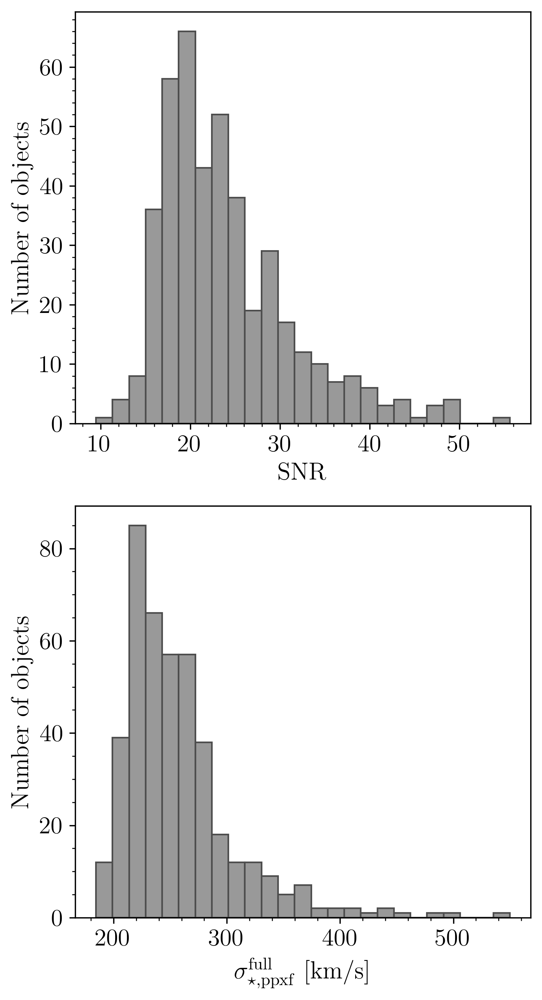

In [14]:
fig, axs = plt.subplots(2, 1 , figsize=(5,10))

axs[0].hist(df['SNR'], bins=25, color='0.6', edgecolor='0.3');
axs[0].set_xlabel('SNR')
axs[0].set_ylabel('Number of objects')
axs[0].minorticks_on()

axs[1].hist(df['velDisp_ppxf'], bins=25, color='0.6', edgecolor='0.3');
axs[1].set_xlabel(r'$\sigma_{\star, \rm ppxf}^{\rm full}$ [km/s]')
axs[1].set_ylabel('Number of objects')
axs[1].minorticks_on()

plt.savefig('/Users/johnmills/Summer project/paper_plots/snr_hist.pdf', bbox_inches='tight', dpi=300)

In [15]:
df.sort_values(by='SNR', inplace=True)

obj_high = df[df['SNR'] == df['SNR'].max()]
obj_med = df[df['SNR'] > df['SNR'].median()]
obj_low = df[df['SNR'] == df['SNR'].min()]
obj_med.head()

,ra,dec,deVRad_r,deVRadErr_r,expRad_r,expRadErr_r,z,zErr,velDisp,velDispErr,...,delta_t_minus,delta_t,delta_t_mean,dor_mean,t_ass_err,dor_99,dor_95,dor_med,meanRad_kids,meanRadkpc_kids
132,207.641481,27.540583,0.575409,0.013851,0.675147,0.013289,0.140002,0.000026,228.9052,10.271350,...,1.07750,1.30185,1.105037,0.519549,0.103144,0.481522,0.509139,0.500434,0.356259,0.908432
234,10.048436,3.549131,0.882175,0.025971,0.808177,0.014176,0.166694,0.000027,271.9322,12.260810,...,0.59844,0.79341,0.465257,0.773846,0.237281,0.687922,0.745058,0.805805,0.445677,1.313270
133,235.126723,14.899100,0.777825,0.016502,0.811283,0.009674,0.113376,0.000025,233.8787,9.583287,...,0.58738,0.86550,0.491490,0.586174,0.022566,0.572383,0.747403,0.550740,0.418097,0.889907
80,228.188970,43.858716,0.536664,0.016175,0.606553,0.008122,0.130004,0.000025,208.5151,10.055290,...,1.09803,1.69897,1.174010,0.429298,0.003025,0.408126,0.426903,0.433627,0.279532,0.669419
389,129.067738,43.300911,1.244100,0.035165,1.148970,0.012953,0.147224,0.000024,262.5194,10.304530,...,0.82746,1.03777,0.717700,0.744241,0.158074,0.621285,0.747890,0.782271,0.606564,1.613308


In [16]:
high_sigma = df[df['velDisp_ppxf'] == df['velDisp_ppxf'].max()]
high_sigma.head()

,ra,dec,deVRad_r,deVRadErr_r,expRad_r,expRadErr_r,z,zErr,velDisp,velDispErr,...,delta_t_minus,delta_t,delta_t_mean,dor_mean,t_ass_err,dor_99,dor_95,dor_med,meanRad_kids,meanRadkpc_kids
419,202.153399,27.957783,1.400873,0.016163,1.154533,0.007253,0.134168,0.000042,499.0596,16.84771,...,0.45451,0.80898,0.48518,0.773987,0.278898,0.64893,0.786971,0.841675,0.667914,1.642966


In [17]:
c = 299792.458                              # speed of light in km/s

sps_name = 'emiles'  # Simple stellar population models by Vazdekis+10

ppxf_dir = Path(util.__file__).parent
basename = f"spectra_{sps_name}_9.0.npz"
filename = ppxf_dir / 'sps_models' / basename
if not filename.is_file():
    url = "https://raw.githubusercontent.com/micappe/ppxf_data/main/" + basename
    request.urlretrieve(url, filename)

lam_range_temp = [1000, 1e4]

vel = 0                 # Spectrum is de-redshifted --> starting guess is zero
start = [vel, 200.]     # (km/s), starting guess for [V, sigma]

In [18]:
row = obj_high.iloc[0]

# Locate fit file for ecah row using plate, mjd, fiberid
plate = row['plate']
mjd = row['mjd']
fiberid = row['fiberid']
txt_name = '/spec-' + f'{plate:04}' + '-' + f'{mjd:05}' + '-' + f'{fiberid:04}' + '.fits'

# Open corresponding fit file
hdu = fits.open('alpha_calculator/fits_shortlist' + txt_name, ignore_missing_simple=True)

# Extract spectrum from fit file
t = hdu['COADD'].data
galaxy = t['flux']/np.median(t['flux'])     # Normalize spectrum to avoid numerical issues
ln_lam_gal = t['loglam']*np.log(10)         # Convert lg --> ln
lam_gal = np.exp(ln_lam_gal)

# Extract redshift from dataframe
redshift_0 = row['z']

# Follow the same steps as in ppxf_example_kinematics_sdss
d_ln_lam_gal = (ln_lam_gal[-1] - ln_lam_gal[0])/(ln_lam_gal.size - 1)  # Use full lam range for accuracy
velscale = c*d_ln_lam_gal                   # Velocity scale in km/s per pixel (eq.8 of Cappellari 2017)
noise = np.full_like(galaxy, 0.0166)        # Assume constant noise per pixel here

dlam_gal = np.gradient(lam_gal)             # Size of every pixel in Angstroms
wdisp = t['wdisp']                          # Intrinsic dispersion of every pixel, in pixels units
fwhm_gal = 2.355*wdisp*dlam_gal             # Resolution FWHM of every pixel, in Angstroms

lam_gal = lam_gal/(1 + redshift_0)      # Compute approximate restframe wavelength
fwhm_gal = fwhm_gal/(1 + redshift_0)    # Adjust resolution in Angstroms

fwhm_gal = {"lam": lam_gal, "fwhm": fwhm_gal}
sps = lib.sps_lib(filename, velscale, fwhm_gal, wave_range=lam_range_temp)
goodpixels = util.determine_goodpixels(np.log(lam_gal), lam_range_temp)

# Run ppxf
pp = ppxf(sps.templates, galaxy, noise, velscale, start,
        goodpixels=goodpixels, plot=False, moments=4, trig=1,
        degree=20, lam=lam_gal, lam_temp=sps.lam_temp, quiet=True,
        mdegree=-1)

# Change noise level such that chi2/DOF  ~ 1
noise = noise*np.sqrt(pp.chi2)

# Rerun ppxf with new noise level and set clean keyword (can only do this once chi2/DOF ~ 1)
pp_high = ppxf(sps.templates, galaxy, noise, velscale, start,
        goodpixels=goodpixels, plot=False, moments=4, trig=1,
        degree=20, lam=lam_gal, lam_temp=sps.lam_temp,
        mdegree=-1, clean=True, quiet=True)

In [19]:
row = obj_med.iloc[0]

# Locate fit file for ecah row using plate, mjd, fiberid
plate = row['plate']
mjd = row['mjd']
fiberid = row['fiberid']
txt_name = '/spec-' + f'{plate:04}' + '-' + f'{mjd:05}' + '-' + f'{fiberid:04}' + '.fits'

# Open corresponding fit file
hdu = fits.open('alpha_calculator/fits_shortlist' + txt_name, ignore_missing_simple=True)

# Extract spectrum from fit file
t = hdu['COADD'].data
galaxy = t['flux']/np.median(t['flux'])     # Normalize spectrum to avoid numerical issues
ln_lam_gal = t['loglam']*np.log(10)         # Convert lg --> ln
lam_gal = np.exp(ln_lam_gal)

# Extract redshift from dataframe
redshift_0 = row['z']

# Follow the same steps as in ppxf_example_kinematics_sdss
d_ln_lam_gal = (ln_lam_gal[-1] - ln_lam_gal[0])/(ln_lam_gal.size - 1)  # Use full lam range for accuracy
velscale = c*d_ln_lam_gal                   # Velocity scale in km/s per pixel (eq.8 of Cappellari 2017)
noise = np.full_like(galaxy, 0.0166)        # Assume constant noise per pixel here

dlam_gal = np.gradient(lam_gal)             # Size of every pixel in Angstroms
wdisp = t['wdisp']                          # Intrinsic dispersion of every pixel, in pixels units
fwhm_gal = 2.355*wdisp*dlam_gal             # Resolution FWHM of every pixel, in Angstroms

lam_gal = lam_gal/(1 + redshift_0)      # Compute approximate restframe wavelength
fwhm_gal = fwhm_gal/(1 + redshift_0)    # Adjust resolution in Angstroms

fwhm_gal = {"lam": lam_gal, "fwhm": fwhm_gal}
sps = lib.sps_lib(filename, velscale, fwhm_gal, wave_range=lam_range_temp)
goodpixels = util.determine_goodpixels(np.log(lam_gal), lam_range_temp)

# Run ppxf
pp = ppxf(sps.templates, galaxy, noise, velscale, start,
        goodpixels=goodpixels, plot=False, moments=4, trig=1,
        degree=20, lam=lam_gal, lam_temp=sps.lam_temp, quiet=True,
        mdegree=-1)

# Change noise level such that chi2/DOF  ~ 1
noise = noise*np.sqrt(pp.chi2)

# Rerun ppxf with new noise level and set clean keyword (can only do this once chi2/DOF ~ 1)
pp_med = ppxf(sps.templates, galaxy, noise, velscale, start,
        goodpixels=goodpixels, plot=False, moments=4, trig=1,
        degree=20, lam=lam_gal, lam_temp=sps.lam_temp,
        mdegree=-1, clean=True, quiet=True)

In [20]:
row = obj_low.iloc[0]

# Locate fit file for ecah row using plate, mjd, fiberid
plate = row['plate']
mjd = row['mjd']
fiberid = row['fiberid']
txt_name = '/spec-' + f'{plate:04}' + '-' + f'{mjd:05}' + '-' + f'{fiberid:04}' + '.fits'

# Open corresponding fit file
hdu = fits.open('alpha_calculator/fits_shortlist' + txt_name, ignore_missing_simple=True)

# Extract spectrum from fit file
t = hdu['COADD'].data
galaxy = t['flux']/np.median(t['flux'])     # Normalize spectrum to avoid numerical issues
ln_lam_gal = t['loglam']*np.log(10)         # Convert lg --> ln
lam_gal = np.exp(ln_lam_gal)

# Extract redshift from dataframe
redshift_0 = row['z']

# Follow the same steps as in ppxf_example_kinematics_sdss
d_ln_lam_gal = (ln_lam_gal[-1] - ln_lam_gal[0])/(ln_lam_gal.size - 1)  # Use full lam range for accuracy
velscale = c*d_ln_lam_gal                   # Velocity scale in km/s per pixel (eq.8 of Cappellari 2017)
noise = np.full_like(galaxy, 0.0166)        # Assume constant noise per pixel here

dlam_gal = np.gradient(lam_gal)             # Size of every pixel in Angstroms
wdisp = t['wdisp']                          # Intrinsic dispersion of every pixel, in pixels units
fwhm_gal = 2.355*wdisp*dlam_gal             # Resolution FWHM of every pixel, in Angstroms

lam_gal = lam_gal/(1 + redshift_0)      # Compute approximate restframe wavelength
fwhm_gal = fwhm_gal/(1 + redshift_0)    # Adjust resolution in Angstroms

fwhm_gal = {"lam": lam_gal, "fwhm": fwhm_gal}
sps = lib.sps_lib(filename, velscale, fwhm_gal, wave_range=lam_range_temp)
goodpixels = util.determine_goodpixels(np.log(lam_gal), lam_range_temp)

# Run ppxf
pp = ppxf(sps.templates, galaxy, noise, velscale, start,
        goodpixels=goodpixels, plot=False, moments=4, trig=1,
        degree=20, lam=lam_gal, lam_temp=sps.lam_temp, quiet=True,
        mdegree=-1)

# Change noise level such that chi2/DOF  ~ 1
noise = noise*np.sqrt(pp.chi2)

# Rerun ppxf with new noise level and set clean keyword (can only do this once chi2/DOF ~ 1)
pp_low = ppxf(sps.templates, galaxy, noise, velscale, start,
        goodpixels=goodpixels, plot=False, moments=4, trig=1,
        degree=20, lam=lam_gal, lam_temp=sps.lam_temp,
        mdegree=-1, clean=True, quiet=True)

In [21]:
row = high_sigma.iloc[0]

# Locate fit file for ecah row using plate, mjd, fiberid
plate = row['plate']
mjd = row['mjd']
fiberid = row['fiberid']
txt_name = '/spec-' + f'{plate:04}' + '-' + f'{mjd:05}' + '-' + f'{fiberid:04}' + '.fits'

# Open corresponding fit file
hdu = fits.open('alpha_calculator/fits_shortlist' + txt_name, ignore_missing_simple=True)

# Extract spectrum from fit file
t = hdu['COADD'].data
galaxy = t['flux']/np.median(t['flux'])     # Normalize spectrum to avoid numerical issues
ln_lam_gal = t['loglam']*np.log(10)         # Convert lg --> ln
lam_gal = np.exp(ln_lam_gal)

# Extract redshift from dataframe
redshift_0 = row['z']

# Follow the same steps as in ppxf_example_kinematics_sdss
d_ln_lam_gal = (ln_lam_gal[-1] - ln_lam_gal[0])/(ln_lam_gal.size - 1)  # Use full lam range for accuracy
velscale = c*d_ln_lam_gal                   # Velocity scale in km/s per pixel (eq.8 of Cappellari 2017)
noise = np.full_like(galaxy, 0.0166)        # Assume constant noise per pixel here

dlam_gal = np.gradient(lam_gal)             # Size of every pixel in Angstroms
wdisp = t['wdisp']                          # Intrinsic dispersion of every pixel, in pixels units
fwhm_gal = 2.355*wdisp*dlam_gal             # Resolution FWHM of every pixel, in Angstroms

lam_gal = lam_gal/(1 + redshift_0)      # Compute approximate restframe wavelength
fwhm_gal = fwhm_gal/(1 + redshift_0)    # Adjust resolution in Angstroms

fwhm_gal = {"lam": lam_gal, "fwhm": fwhm_gal}
sps = lib.sps_lib(filename, velscale, fwhm_gal, wave_range=lam_range_temp)
goodpixels = util.determine_goodpixels(np.log(lam_gal), lam_range_temp)

# Run ppxf
pp = ppxf(sps.templates, galaxy, noise, velscale, start,
        goodpixels=goodpixels, plot=False, moments=4, trig=1,
        degree=20, lam=lam_gal, lam_temp=sps.lam_temp, quiet=True,
        mdegree=-1)

# Change noise level such that chi2/DOF  ~ 1
noise = noise*np.sqrt(pp.chi2)

# Rerun ppxf with new noise level and set clean keyword (can only do this once chi2/DOF ~ 1)
pp_sigma = ppxf(sps.templates, galaxy, noise, velscale, start,
        goodpixels=goodpixels, plot=False, moments=4, trig=1,
        degree=20, lam=lam_gal, lam_temp=sps.lam_temp,
        mdegree=-1, clean=True, quiet=True)

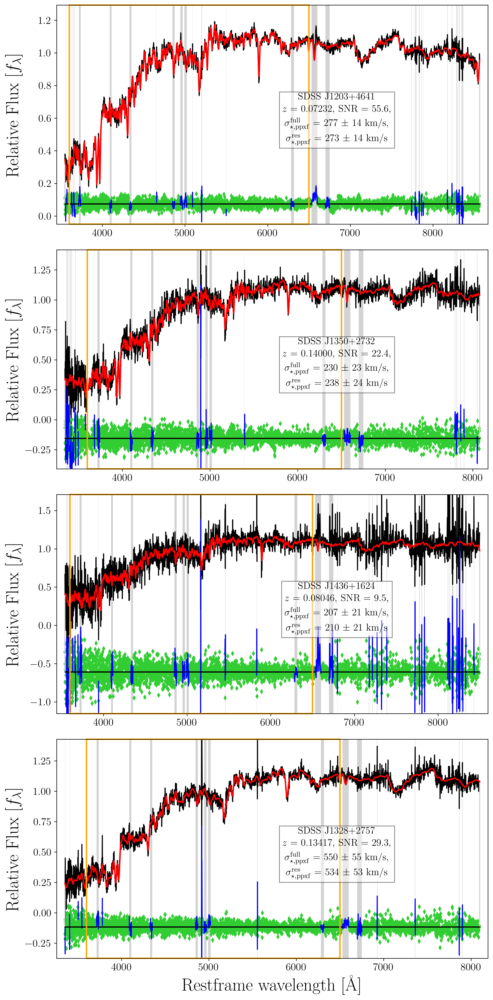

In [22]:
fig = plt.figure(figsize=(10, 20))

hor_align = 0.65
ver_align = 0.6

ax1 = fig.add_subplot(411)
pp_high.plot()
sexa_id = obj_high['sexa_id'].iloc[0]
z = obj_high['z'].iloc[0]
SNR = obj_high['SNR'].iloc[0]
sigma = obj_high['velDisp_ppxf'].iloc[0]
sigma_err = obj_high['velDisp_ppxf_err'].iloc[0]
sigma_res = obj_high['velDisp_ppxf_res'].iloc[0]
sigma_res_err = obj_high['velDisp_ppxf_err_res'].iloc[0]
textstr = '\n'.join((
    f'SDSS {sexa_id}',
    f'$z$ = {z:.5f}, SNR = {SNR:.1f},',
    r'$\sigma_{\star, \rm ppxf}^{\mathrm{full}}$ = ' + f'{sigma:.0f}' + fr' $\pm$ {sigma_err:.0f} km/s,',
    r'$\sigma_{\star, \rm ppxf}^{\mathrm{res}}$ = ' + f'{sigma_res:.0f}' + fr' $\pm$ {sigma_res_err:.0f} km/s'))
props = dict(boxstyle='square', facecolor='white', alpha=0.5, edgecolor='black')
ax1.text(hor_align, ver_align, textstr, transform=ax1.transAxes, fontsize=14,
        verticalalignment='top', bbox=props, ha='center', linespacing=1.5)
ax1.axvspan(3600, 6500, ec='orange', fc='1', fill=False, lw=2, zorder=2, clip_on=False)

ax2 = fig.add_subplot(412)
pp_med.plot()
sexa_id = obj_med['sexa_id'].iloc[0]
z = obj_med['z'].iloc[0]
SNR = obj_med['SNR'].iloc[0]
sigma = obj_med['velDisp_ppxf'].iloc[0]
sigma_err = obj_med['velDisp_ppxf_err'].iloc[0]
sigma_res = obj_med['velDisp_ppxf_res'].iloc[0]
sigma_res_err = obj_med['velDisp_ppxf_err_res'].iloc[0]
textstr = '\n'.join((
    f'SDSS {sexa_id}',
    f'$z$ = {z:.5f}, SNR = {SNR:.1f},',
    r'$\sigma_{\star, \rm ppxf}^{\mathrm{full}}$ = ' + f'{sigma:.0f}' + fr' $\pm$ {sigma_err:.0f} km/s,',
    r'$\sigma_{\star, \rm ppxf}^{\mathrm{res}}$ = ' + f'{sigma_res:.0f}' + fr' $\pm$ {sigma_res_err:.0f} km/s'))
props = dict(boxstyle='square', facecolor='white', alpha=0.5, edgecolor='black')
ax2.text(hor_align, ver_align, textstr, transform=ax2.transAxes, fontsize=14,
        verticalalignment='top', bbox=props, ha='center', linespacing=1.5)
ax2.axvspan(3600, 6500, ec='orange', fc='1', fill=False, lw=2, zorder=2, clip_on=False)

ax3 = fig.add_subplot(413)
pp_low.plot()
sexa_id = obj_low['sexa_id'].iloc[0]
z = obj_low['z'].iloc[0]
SNR = obj_low['SNR'].iloc[0]
sigma = obj_low['velDisp_ppxf'].iloc[0]
sigma_err = obj_low['velDisp_ppxf_err'].iloc[0]
sigma_res = obj_low['velDisp_ppxf_res'].iloc[0]
sigma_res_err = obj_low['velDisp_ppxf_err_res'].iloc[0]
textstr = '\n'.join((
    f'SDSS {sexa_id}',
    f'$z$ = {z:.5f}, SNR = {SNR:.1f},',
    r'$\sigma_{\star, \rm ppxf}^{\mathrm{full}}$ = ' + f'{sigma:.0f}' + fr' $\pm$ {sigma_err:.0f} km/s,',
    r'$\sigma_{\star, \rm ppxf}^{\mathrm{res}}$ = ' + f'{sigma_res:.0f}' + fr' $\pm$ {sigma_res_err:.0f} km/s'))
props = dict(boxstyle='square', facecolor='white', alpha=0.5, edgecolor='black')
ax3.text(hor_align, ver_align, textstr, transform=ax3.transAxes, fontsize=14,
        verticalalignment='top', bbox=props, ha='center', linespacing=1.5)
ax3.axvspan(3600, 6500, ec='orange', fc='1', fill=False, lw=2, zorder=2, clip_on=False)

ax4 = fig.add_subplot(414)
pp_sigma.plot()
sexa_id = high_sigma['sexa_id'].iloc[0]
z = high_sigma['z'].iloc[0]
SNR = high_sigma['SNR'].iloc[0]
sigma = high_sigma['velDisp_ppxf'].iloc[0]
sigma_err = high_sigma['velDisp_ppxf_err'].iloc[0]
sigma_res = high_sigma['velDisp_ppxf_res'].iloc[0]
sigma_res_err = high_sigma['velDisp_ppxf_err_res'].iloc[0]
textstr = '\n'.join((
    f'SDSS {sexa_id}',
    f'$z$ = {z:.5f}, SNR = {SNR:.1f},',
    r'$\sigma_{\star, \rm ppxf}^{\mathrm{full}}$ = ' + f'{sigma:.0f}' + fr' $\pm$ {sigma_err:.0f} km/s,',
    r'$\sigma_{\star, \rm ppxf}^{\mathrm{res}}$ = ' + f'{sigma_res:.0f}' + fr' $\pm$ {sigma_res_err:.0f} km/s'))
props = dict(boxstyle='square', facecolor='white', alpha=0.5, edgecolor='black')
ax4.text(hor_align, ver_align, textstr, transform=ax4.transAxes, fontsize=14,
        verticalalignment='top', bbox=props, ha='center', linespacing=1.5)
ax4.axvspan(3600, 6500, ec='orange', fc='1', fill=False, lw=2, zorder=2, clip_on=False);

ax1.set_xlabel('')
ax2.set_xlabel('')
ax3.set_xlabel('')
fig.align_ylabels()
fig.tight_layout()

plt.savefig('/Users/johnmills/Summer project/paper_plots/ppxf_fits2.pdf', bbox_inches='tight', dpi=300)

In [23]:
Z_match = pd.read_csv('alpha_calculator/MILES_indices2.csv')
Z_match.head()

,file,[M/H],[α/Fe],Age,z,Hbeta_o,Hbeta,Mgb,Fe5270,Fe5335,Fe_avg
0,Mbi1.30Zm0.66T07.5000_Ep0.00.txt,-0.66,0.0,7.5,0.0,3.446309,2.386415,1.530053,2.206248,2.240999,2.223624
1,Mbi1.30Zp0.26T12.0000_Ep0.00.txt,0.26,0.0,12.0,0.0,3.043772,1.813421,4.357432,3.962214,3.956837,3.959525
2,Mbi1.30Zp0.40T05.0000_Ep0.00.txt,0.40,0.0,5.0,0.0,3.542997,2.297674,4.054867,3.662181,3.649247,3.655714
3,Mbi1.30Zp0.06T05.5000_Ep0.00.txt,0.06,0.0,5.5,0.0,3.409005,2.219218,3.353890,3.264997,3.235426,3.250211
4,Mbi1.30Zm0.66T09.0000_Ep0.00.txt,-0.66,0.0,9.0,0.0,3.299094,2.277323,1.593832,2.262156,2.290743,2.276450


In [24]:
age = 11.00

Z_grid = Z_match[Z_match['Age']==age]

age = 2
Z_grid2 = Z_match[Z_match['Age']==age]

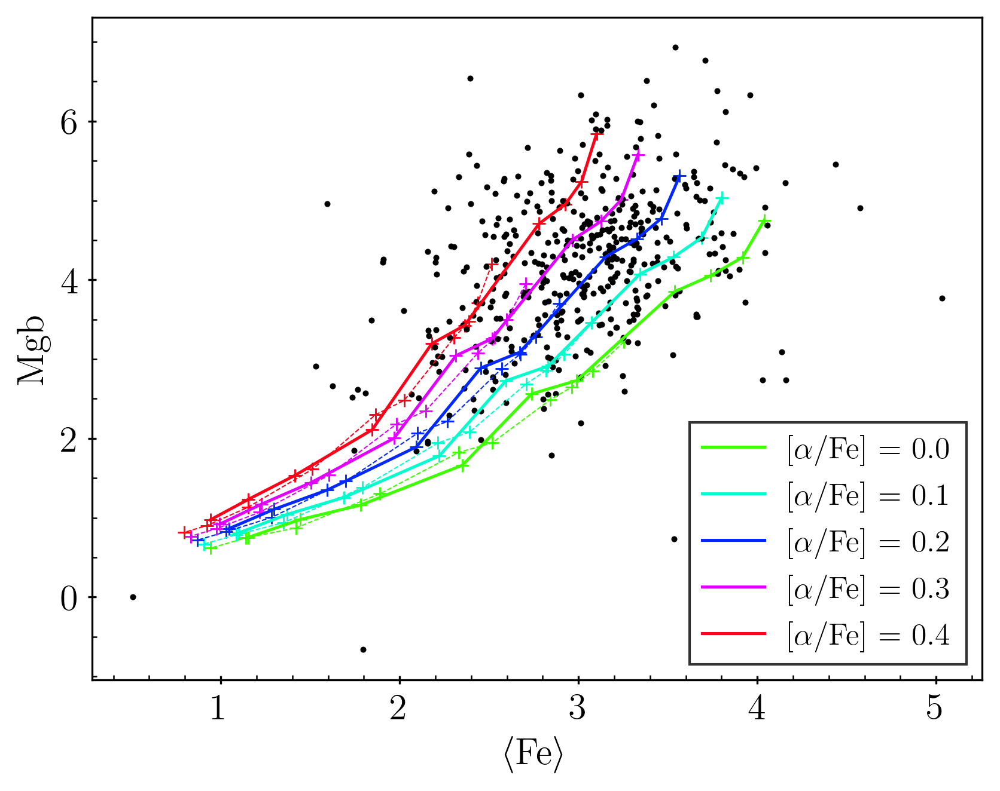

In [25]:
metals = Z_match['[M/H]'].unique()
metals = np.sort(metals)
alphas = Z_match['[α/Fe]'].unique()
alphas = np.sort(alphas)

fig, ax = plt.subplots()

data_x = []
data_y = []
for metal in metals:
    Z_metal = Z_grid[Z_grid['[M/H]']==metal].sort_values(['Fe_avg'])
    x = Z_metal['Fe_avg']
    y = Z_metal['Mgb']
    data_x.extend(x)
    data_y.extend(y)

data_x.reverse()
data_y.reverse()
data_x = np.reshape(data_x, (len(metals), len(alphas)))
data_y = np.reshape(data_y, (len(metals), len(alphas)))

colours = plt.cm.hsv(np.linspace(0.3, 1, len(alphas)))

for i in range(len(alphas)):
    ax.plot(data_x[:,i], data_y[:,i], '-', color=colours[i], lw=1.2)

ax.legend([f'[$\\alpha$/Fe] = {alpha}' for alpha in alphas], fontsize=12.5, fancybox=False, edgecolor='black')

for i in range(len(alphas)):
    ax.scatter(data_x[:,i], data_y[:,i], color=colours[i], s=28, marker='+', linewidths=0.7)

data_x2 = []
data_y2 = []
for metal in metals:
    Z_metal2 = Z_grid2[Z_grid2['[M/H]']==metal].sort_values(['Fe_avg'])
    x2 = Z_metal2['Fe_avg']
    y2 = Z_metal2['Mgb']
    data_x2.extend(x2)
    data_y2.extend(y2)

data_x2.reverse()
data_y2.reverse()
data_x2 = np.reshape(data_x2, (len(metals), len(alphas)))
data_y2 = np.reshape(data_y2, (len(metals), len(alphas)))

colours = plt.cm.hsv(np.linspace(0.3, 1, len(alphas)))

for i in range(len(alphas)):
    ax.plot(data_x2[:,i], data_y2[:,i], '--', color=colours[i], lw=0.5)

for i in range(len(alphas)):
    ax.scatter(data_x2[:,i], data_y2[:,i], color=colours[i], s=28, marker='+', linewidths=0.7)

ax.minorticks_on()
ax.tick_params(axis='both',which='minor',direction='in')
ax.tick_params(axis='both',which='major',direction='inout')

ax.set_xlabel(r'$\langle$Fe$\rangle$')
ax.set_ylabel('Mgb')

ax.scatter(df['Fe_avg_corr'], df['Mgb_corr'], c='k', s=2);

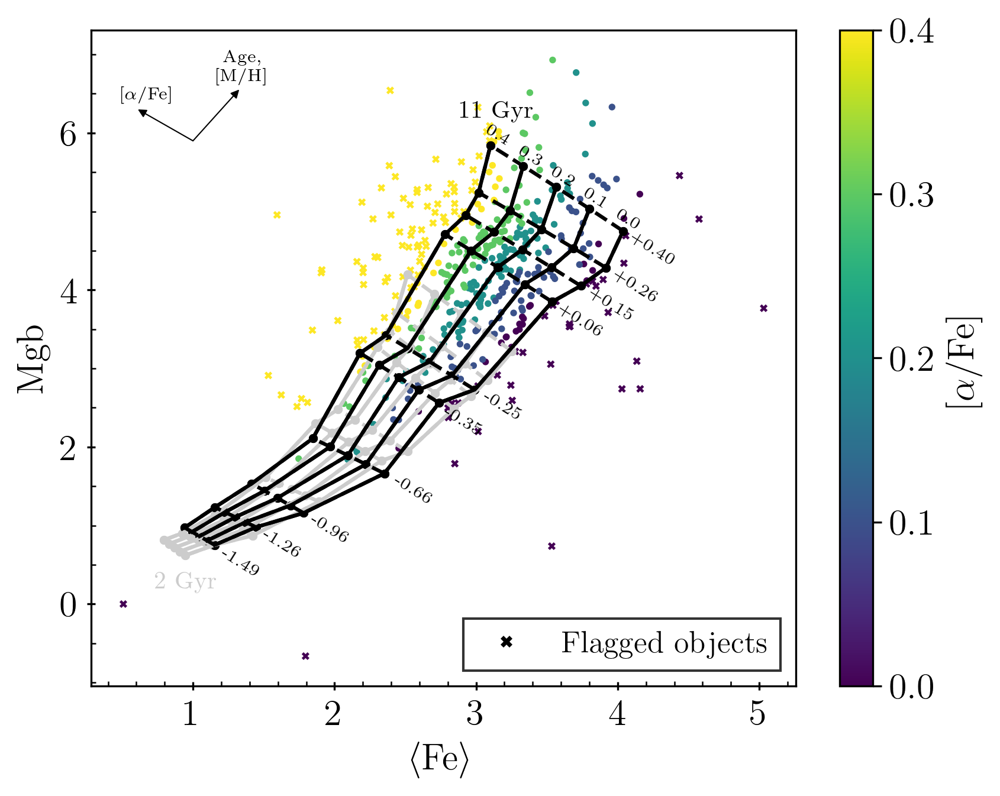

In [26]:
fig, ax = plt.subplots()

pc = ax.scatter(df[df['alpha_flag']==0]['Fe_avg_corr'], df[df['alpha_flag']==0]['Mgb_corr'], c=df['alpha'][df['alpha_flag']==0],
                 s=3, cmap='viridis', label='No flag');

ax.scatter(df[df['alpha_flag']!=0]['Fe_avg_corr'], df[df['alpha_flag']!=0]['Mgb_corr'], c=df['alpha'][df['alpha_flag']!=0],
            s=10, marker='X', edgecolor='none', label='Flag');

# Create custom legend handles
marker_style2 = mlines.Line2D([], [], color='black', marker='X', linestyle='None', markersize=5, label='Flagged objects', markeredgecolor='none')

# Add the custom handles to the legend
ax.legend(handles=[marker_style2], fontsize=12.5, fancybox=False, edgecolor='black', loc='lower right')

ax.scatter(Z_grid2['Fe_avg'], Z_grid2['Mgb'], c='0.8', s=7);

Z_grid2 = Z_grid2.sort_values(['[M/H]'])
for alpha in alphas:
    ax.plot(Z_grid2['Fe_avg'][Z_grid2['[α/Fe]']==alpha], Z_grid2['Mgb'][Z_grid2['[α/Fe]']==alpha], '-', c='0.8')

Z_grid2 = Z_grid2.sort_values(['[α/Fe]'])
for metal in metals:
    ax.plot(Z_grid2['Fe_avg'][Z_grid2['[M/H]']==metal], Z_grid2['Mgb'][Z_grid2['[M/H]']==metal], '--', c='0.8')

data_x = []
data_y = []
for metal in metals:
    Z_metal = Z_grid2[Z_grid2['[M/H]']==metal].sort_values(['Fe_avg'])
    x = Z_metal['Fe_avg']
    y = Z_metal['Mgb']
    ax.scatter(x, y, c='0.8', s=7)
    data_x.extend(x)
    data_y.extend(y)

data_x = np.reshape(data_x, (len(metals), len(alphas)))
data_y = np.reshape(data_y, (len(metals), len(alphas)))
ax.plot(data_x, data_y, '--', c='0.8')

ax.scatter(Z_grid['Fe_avg'], Z_grid['Mgb'], c='k', s=7);

Z_grid = Z_grid.sort_values(['[M/H]'])
for alpha in alphas:
    ax.plot(Z_grid['Fe_avg'][Z_grid['[α/Fe]']==alpha], Z_grid['Mgb'][Z_grid['[α/Fe]']==alpha], 'k-')

Z_grid = Z_grid.sort_values(['[α/Fe]'])
for metal in metals:
    ax.plot(Z_grid['Fe_avg'][Z_grid['[M/H]']==metal], Z_grid['Mgb'][Z_grid['[M/H]']==metal], 'k--')


data_x = []
data_y = []
for metal in metals:
    Z_metal = Z_grid[Z_grid['[M/H]']==metal].sort_values(['Fe_avg'])
    x = Z_metal['Fe_avg']
    y = Z_metal['Mgb']
    ax.scatter(x, y, c='k', s=7)
    data_x.extend(x)
    data_y.extend(y)

data_x = np.reshape(data_x, (len(metals), len(alphas)))
data_y = np.reshape(data_y, (len(metals), len(alphas)))
ax.plot(data_x, data_y, 'k--',)

ax.minorticks_on()
ax.tick_params(axis='both',which='minor',direction='in')
ax.tick_params(axis='both',which='major',direction='inout')

ax.set_xlabel(r'$\langle$Fe$\rangle$')
ax.set_ylabel('Mgb')

fig.colorbar(pc, ax=ax, label='[$\\alpha$/Fe]', ticks=[0.0, 0.1, 0.2, 0.3, 0.4]);

coords = np.array([1, 5.9])
end1 = coords + np.array([0.1,0.2])*3.5
end2 = coords + np.array([-0.35, 0.36])*1.2

ax.annotate('', xy=end1, xytext=coords,
            arrowprops=dict(arrowstyle='-|>', mutation_scale=7, shrinkA=0, color='k', lw=0.5))
ax.annotate('', xy=end2, xytext=coords,
            arrowprops=dict(arrowstyle='-|>', mutation_scale=7, shrinkA=0, color='k', lw=0.5))

ax.text(end1[0], end1[1]+0.23, 'Age, \n[M/H]', fontsize=7, va='center', ha='center')
ax.text(end2[0]+0.1, end2[1]+0.15, r'[$\alpha$/Fe]', fontsize=7, va='center', ha='center')

ax.text(3.05, 5.85, '0.4', fontsize=7, rotation=-32)
ax.text(3.28, 5.58, '0.3', fontsize=7, rotation=-32)
ax.text(3.51, 5.31, '0.2', fontsize=7, rotation=-32)
ax.text(3.74, 5.04, '0.1', fontsize=7, rotation=-32)
ax.text(3.97, 4.77, '0.0', fontsize=7, rotation=-32)

ax.text(4.07, 4.31, '+0.40', fontsize=7, rotation=-32)
ax.text(3.95, 3.83, '+0.26', fontsize=7, rotation=-32)
ax.text(3.78, 3.6, '+0.15', fontsize=7, rotation=-32)
ax.text(3.56, 3.4, '+0.06', fontsize=7, rotation=-32)
ax.text(3.03, 2.35, '-0.25', fontsize=7, rotation=-32)
ax.text(2.75, 2.15, '-0.35', fontsize=7, rotation=-32)
ax.text(2.4, 1.28, '-0.66', fontsize=7, rotation=-32)
ax.text(1.81, 0.78, '-0.96', fontsize=7, rotation=-32)
ax.text(1.47, 0.59, '-1.26', fontsize=7, rotation=-32)
ax.text(1.18, 0.35, '-1.49', fontsize=7, rotation=-32)

ax.text(3.15, 6.2, '11 Gyr', fontsize=10, ha='center')
ax.text(0.95, 0.2, '2 Gyr', fontsize=10, ha='center', color='0.8')

fig.savefig('/Users/johnmills/Summer project/paper_plots/alpha_grid.pdf', bbox_inches='tight', dpi=300)


In [27]:
# df_inspire = pd.read_csv('INSPIRE_CATALOGUE_24_06_24.csv')
# df_inspire.head()

0.9535524197062145


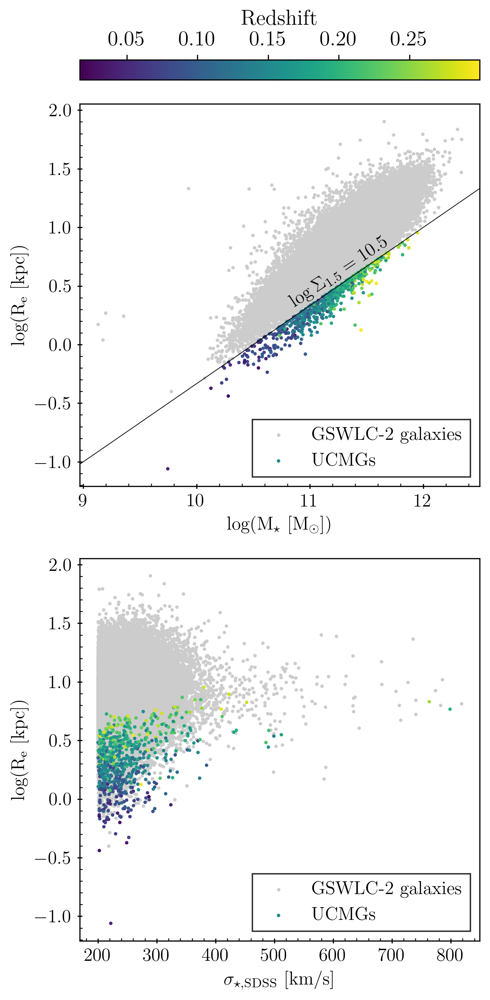

In [15]:
df2 = pd.read_csv('/Users/johnmills/Summer project/Final crossmatches/SDSS_crossmatch_frac_fit.csv')
df2['logMeanRad'] = df2.fracDev_r*np.log10(df2.deVRadkpc_r) + (1-df2.fracDev_r)*np.log10(df2.expRadkpc_r)
df2['compact'] = [x[0] - 1.5*x[1] >10.5 for x in df2[['logM', 'logMeanRad']].values]
print(df2[df2['compact']==1]['logMeanRad'].max())

fig, axs = plt.subplots(2, 1, figsize=(5,10), height_ratios=[1.25, 1])
fig.subplots_adjust(hspace=0.01)

axs[0].scatter(df2[df2.compact == False].logM, df2[df2.compact == False].logMeanRad, s=2, c='0.8', rasterized=True)
pc = axs[0].scatter(df2[df2.compact == True].logM, df2[df2.compact == True].logMeanRad, s=2, c=df2.z[df2.compact == True], rasterized=True)
#ax.scatter(np.log10(df_inspire['Mstar(10^11)']*(10**11)), np.log10(df_inspire['Reff_median_KIDS_kpc']), s=10, marker='D', c=df_inspire['zspec_XSH'])
axs[0].axline((11, 1/3), slope=2/3, c='k', lw=0.5)
axs[0].set_ylabel(r'log($\mathrm{R_e}$ [kpc])', fontsize=13)
axs[0].set_xlabel(r'log(M$_{\star}$ [M$_{\odot}$])', fontsize=13)
axs[0].minorticks_on()
axs[0].tick_params(axis='both',which='minor',direction='in', labelsize=13)
axs[0].tick_params(axis='both',which='major',direction='inout', labelsize=13)
axs[0].legend(['GSWLC-2 galaxies', 'UCMGs'], fontsize=13, fancybox=False, edgecolor='black', loc='lower right');
axs[0].text(10.8, 0.32, r'$\log\Sigma_{1.5}=10.5$', fontsize=13, color='k', rotation=33.7);

axs[1].scatter(df2[df2.compact == False].velDisp, df2[df2.compact == False].logMeanRad, s=2, c='0.8', rasterized=True)
axs[1].scatter(df2[df2.compact == True].velDisp, df2[df2.compact == True].logMeanRad, s=2, c=df2.z[df2.compact == True], rasterized=True)
axs[1].set_ylabel(r'log($\mathrm{R_e}$ [kpc])', fontsize=13)
axs[1].set_xlabel(r'$\sigma_{\star, \mathrm{SDSS}}$ [km/s]', fontsize=13)
axs[1].minorticks_on()
axs[1].tick_params(axis='both',which='minor',direction='in', labelsize=13)
axs[1].tick_params(axis='both',which='major',direction='inout', labelsize=13)
axs[1].legend(['GSWLC-2 galaxies', 'UCMGs'], fontsize=13, fancybox=False, edgecolor='black', loc='lower right');

fig.colorbar(pc, label='Redshift', location='top');

plt.tight_layout()

plt.savefig('/Users/johnmills/Summer project/paper_plots/compact.pdf', bbox_inches='tight', dpi=300)

# Maybe overplot INSPIRE galaxies? with different marker style?

0.9535524197062145


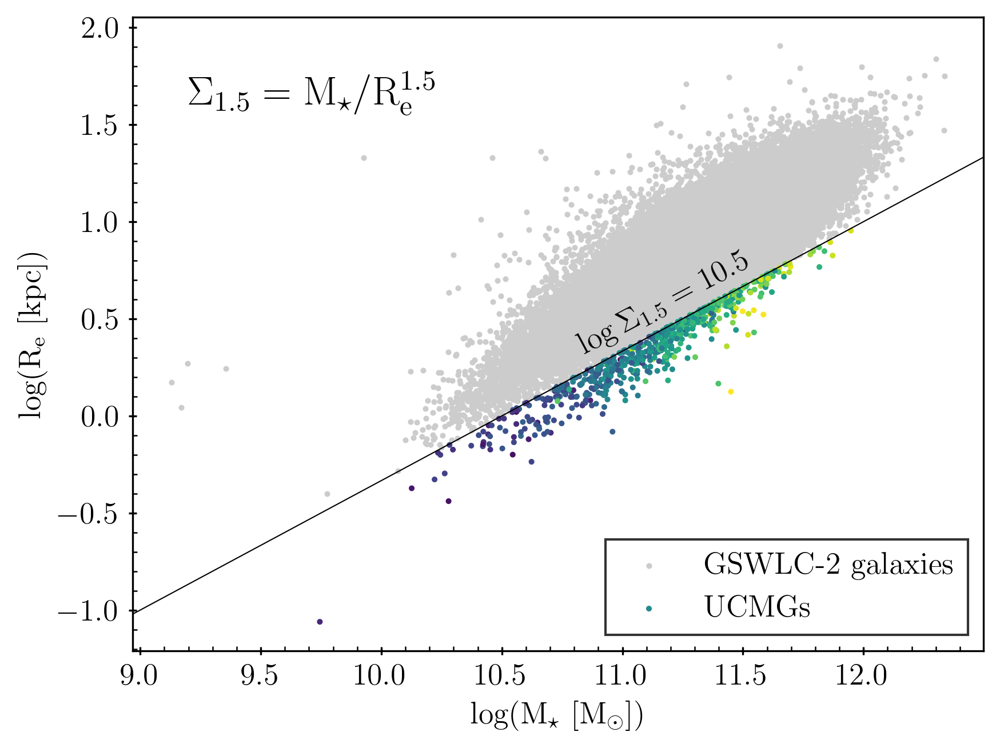

In [13]:
df2 = pd.read_csv('/Users/johnmills/Summer project/Final crossmatches/SDSS_crossmatch_frac_fit.csv')
df2['logMeanRad'] = df2.fracDev_r*np.log10(df2.deVRadkpc_r) + (1-df2.fracDev_r)*np.log10(df2.expRadkpc_r)
df2['compact'] = [x[0] - 1.5*x[1] >10.5 for x in df2[['logM', 'logMeanRad']].values]
print(df2[df2['compact']==1]['logMeanRad'].max())

fig, axs = plt.subplots()
fig.subplots_adjust(hspace=0.01)

axs.scatter(df2[df2.compact == False].logM, df2[df2.compact == False].logMeanRad, s=2, c='0.8', rasterized=True)
pc = axs.scatter(df2[df2.compact == True].logM, df2[df2.compact == True].logMeanRad, s=2, c=df2.z[df2.compact == True], rasterized=True)
#ax.scatter(np.log10(df_inspire['Mstar(10^11)']*(10**11)), np.log10(df_inspire['Reff_median_KIDS_kpc']), s=10, marker='D', c=df_inspire['zspec_XSH'])
axs.axline((11, 1/3), slope=2/3, c='k', lw=0.5)
axs.set_ylabel(r'log($\mathrm{R_e}$ [kpc])', fontsize=13)
axs.set_xlabel(r'log(M$_{\star}$ [M$_{\odot}$])', fontsize=13)
axs.minorticks_on()
axs.tick_params(axis='both',which='minor',direction='in', labelsize=13)
axs.tick_params(axis='both',which='major',direction='inout', labelsize=13)
axs.legend(['GSWLC-2 galaxies', 'UCMGs'], fontsize=13, fancybox=False, edgecolor='black', loc='lower right');
axs.text(10.8, 0.32, r'$\log\Sigma_{1.5}=10.5$', fontsize=13, color='k', rotation=28);
axs.text(9.2, 1.6, r'$\Sigma_{1.5}= \rm M_{\star}/R_e^{1.5}$', fontsize=17, color='k');

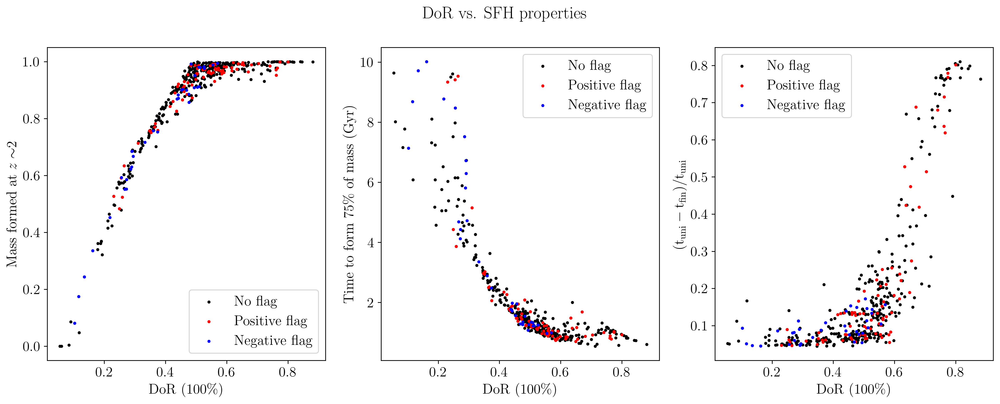

In [29]:
df_flag_plus = df[df['alpha_flag']==1]
df_flag_minus = df[df['alpha_flag']==-1]

fig, axs = plt.subplots(1, 3, figsize=(18, 6))

axs[0].scatter(df['dor'],df['mass_frac'], s=5, c='k', label='No flag')
axs[0].scatter(df_flag_plus['dor'],df_flag_plus['mass_frac'], s=5, c='red', label='Positive flag')
axs[0].scatter(df_flag_minus['dor'],df_flag_minus['mass_frac'], s=5, c='blue', label='Negative flag')
axs[0].set_xlabel(r'DoR (100\%)')
axs[0].set_ylabel(r'Mass formed at $z\sim$2')
axs[0].legend()

axs[1].scatter(df['dor'],df['time_75'],s=5, c='k', label='No flag')
axs[1].scatter(df_flag_plus['dor'],df_flag_plus['time_75'], s=5, c='red', label='Positive flag')
axs[1].scatter(df_flag_minus['dor'],df_flag_minus['time_75'], s=5, c='blue', label='Negative flag')
axs[1].set_xlabel(r'DoR (100\%)')
axs[1].set_ylabel(r'Time to form 75\% of mass (Gyr)')
axs[1].legend()

axs[2].scatter(df['dor'],(np.array(df['univ_age'])-np.array(df['time_100']))/np.array(df['univ_age']), s=5, c='k', label='No flag')
axs[2].scatter(df_flag_plus['dor'],(np.array(df_flag_plus['univ_age'])-np.array(df_flag_plus['time_100']))/np.array(df_flag_plus['univ_age']), s=5, c='red', label='Positive flag')
axs[2].scatter(df_flag_minus['dor'],(np.array(df_flag_minus['univ_age'])-np.array(df_flag_minus['time_100']))/np.array(df_flag_minus['univ_age']), s=5, c='blue', label='Negative flag')
axs[2].set_xlabel(r'DoR (100\%)')
axs[2].set_ylabel(r'$\mathrm{(t_{uni} - t_{fin})/t_{uni}}$')
axs[2].legend()

fig.suptitle('DoR vs. SFH properties', fontsize=18);

In [30]:
len(df[df['alpha_flag']!=0])

116

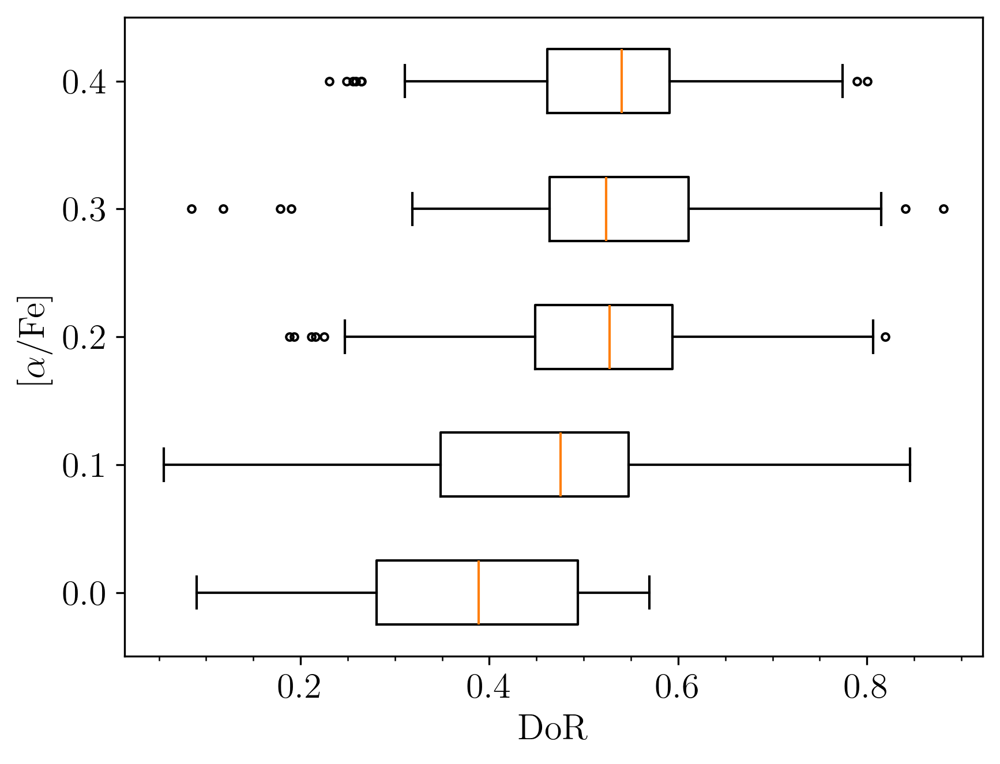

In [31]:
dor_alphas = []
dor_alphas_label = []

for alpha in alphas:
    df_alpha = df[df['alpha'] == alpha]
    dor_alphas.append(df_alpha['dor'].values)
    dor_alphas_label.append(alpha)

fig, ax = plt.subplots()

ax.boxplot(dor_alphas, vert=False, tick_labels=dor_alphas_label, flierprops=dict(marker='o', markersize=3, linestyle='none'))

ax.set_ylabel(r'[$\alpha$/Fe]')
ax.set_xlabel('DoR')
ax.minorticks_on()
ax.tick_params(axis='y', which='minor', left=False)

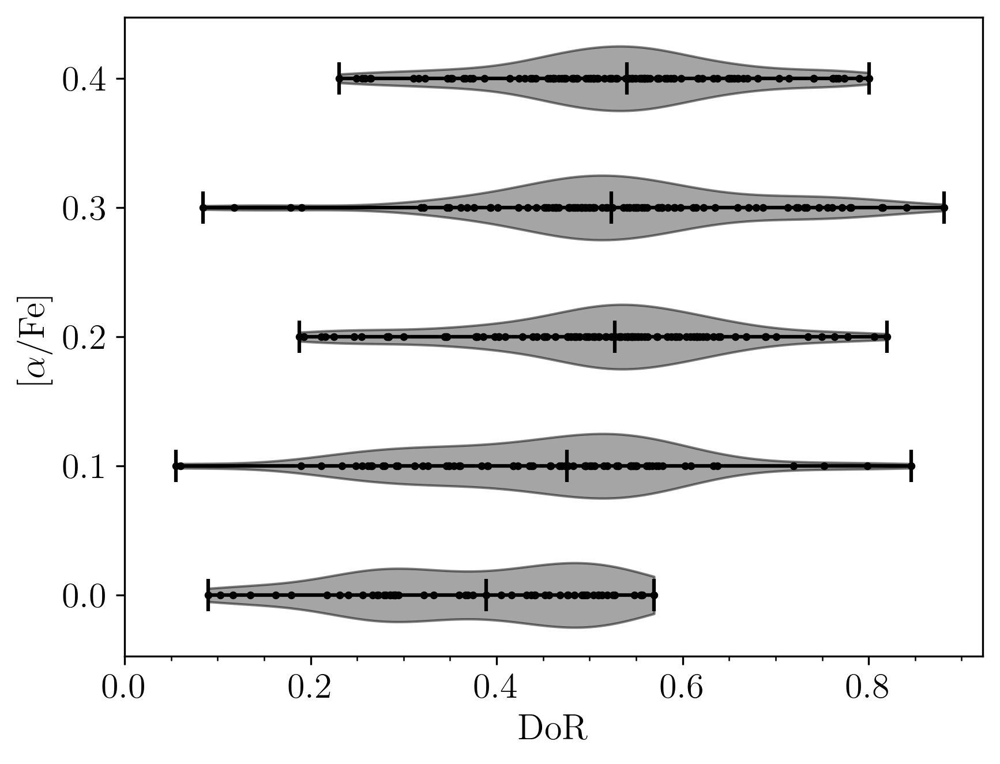

In [32]:
dor_alphas = []
dor_alphas_label = []

for alpha in alphas:
    df_alpha = df[df['alpha'] == alpha]
    dor_alphas.append(df_alpha['dor'].values)
    dor_alphas_label.append(alpha)

fig, ax = plt.subplots()

parts = ax.violinplot(dor_alphas, vert=False, showmedians=True, positions=dor_alphas_label, widths=0.05)
for pc in parts['bodies']:
    pc.set_facecolor('0.3')
    pc.set_edgecolor('black')
    pc.set_alpha(0.5)
for partname in ('cbars','cmins','cmaxes','cmedians'):
    vp = parts[partname]
    vp.set_edgecolor('k')
ax.scatter(df['dor'], df['alpha'], s=5, c='k')
ax.set_ylabel(r'[$\alpha$/Fe]')
ax.set_xlabel('DoR')
ax.minorticks_on()
ax.tick_params(axis='y', which='minor', left=False)
ax.set_xticks([0., 0.2, 0.4, 0.6, 0.8]);

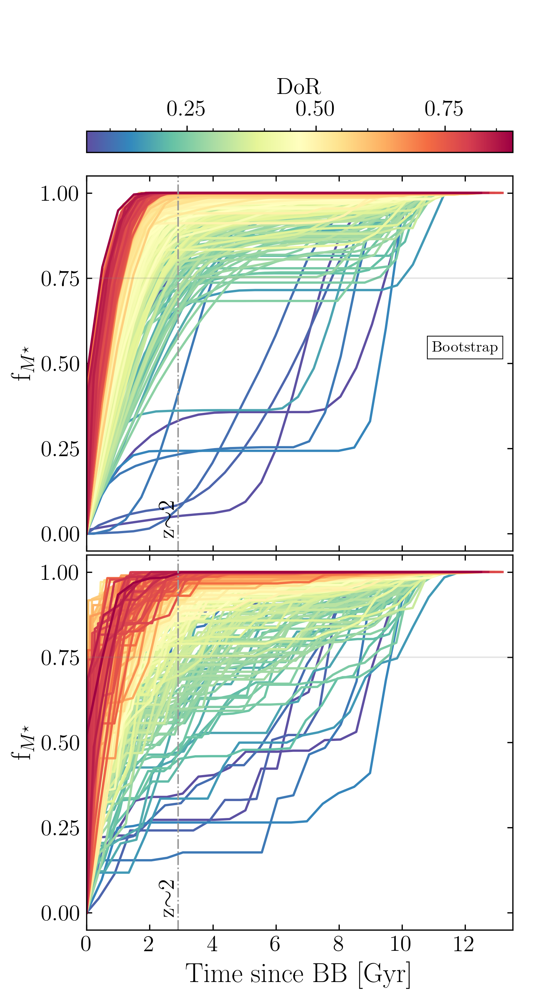

In [33]:
fig, axs = plt.subplots(2, figsize = (5, 10), sharex=True, height_ratios=[1.25, 1])
fig.subplots_adjust(hspace=0.01)

cmap = plt.get_cmap('Spectral_r')
norm = plt.Normalize(df['dor'].min(), df['dor'].max())

df_sort = df.sort_values('dor')

for index, row in df_sort.iterrows():
    
        name = row['sexa_id']
        fitsfilea = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_UNR.fits'
        fitsfileb = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_REGUL.fits'

        name1,z1,agesplot1,weiplot1,univ_age1 = read_fits_summary(fitsfilea)
        name2,z2,agesplot2,weiplot2,univ_age2 = read_fits_summary(fitsfileb)

        axs[0].plot(agesplot1,weiplot1, color=cmap(norm(row['dor'])))
        axs[1].plot(agesplot2,weiplot2, color=cmap(norm(row['dor'])));

axs[0].axhline(0.75,color='gray',alpha=0.2, linewidth=1)
axs[1].axhline(0.75,color='gray',alpha=0.2, linewidth=1)
axs[0].axvline(2.9,color='0.6',linestyle='-.',linewidth=1)
axs[1].axvline(2.9,color='0.6',linestyle='-.',linewidth=1)
axs[0].text(2.9,0.,r'z$\sim$2',style='italic',color='k',rotation=90,horizontalalignment='right')
axs[1].text(2.9,0.,r'z$\sim$2',style='italic',color='k',rotation=90,horizontalalignment='right')

axs[0].set_xticks([0.,2.,4.,6.,8.,10.,12.])
axs[0].set_xlim(0,13.5)
axs[0].set_yticks([0.,0.25,0.5,0.75,1.])
axs[1].set_yticks([0.,0.25,0.5,0.75,1.])
axs[0].tick_params(axis='both',which='major',direction='in', right=True, top=True)
axs[1].tick_params(axis='both',which='major',direction='in', right=True, top=True)
axs[1].set_xlabel('Time since BB [Gyr]', fontsize=18)
axs[0].set_ylabel(r'f$_{M^\star}$', fontsize=18)
axs[1].set_ylabel(r'f$_{M^\star}$', fontsize=18)

textstr0 = 'No bootstrap'
props = dict(boxstyle='square', facecolor='white', edgecolor='black', lw=0.5)
axs[0].text(0.35, -0.27, textstr0, transform=ax2.transAxes, fontsize=10,
        verticalalignment='top', bbox=props, ha='center', linespacing=1.5)
textstr1 = 'Bootstrap'
axs[1].text(0.35, -1.07, textstr1, transform=ax2.transAxes, fontsize=10,
        verticalalignment='top', bbox=props, ha='center', linespacing=1.5)

cb = fig.colorbar(cm.ScalarMappable(norm=norm, cmap=cmap), ax=axs[0], label='DoR', location='top', ticks=[0, 0.25, 0.5, 0.75]);
cb.minorticks_on()

In [34]:
df_slice = df.loc[:, ['mass_frac', 'time_100', '[M/H]_mean','age_mean', 'alpha', 'velDisp_ppxf', 'dor']]
df_slice = df_slice.sort_values('dor')
df_slice.head()

,mass_frac,time_100,[M/H]_mean,age_mean,alpha,velDisp_ppxf,dor
238,0.00000,10.94402,0.144791,3.180954,0.1,216.995138,0.054899
398,0.00000,10.00086,0.141495,3.331016,0.1,198.702016,0.059858
427,0.00351,9.17651,-0.211273,6.194772,0.3,488.076945,0.084366
269,0.08558,10.71812,0.134115,4.829193,0.0,271.737572,0.090026
399,0.08055,9.96149,-0.320058,5.448138,0.0,329.211580,0.102624


/Users/johnmills/Summer project/.venv/lib/python3.12/site-packages/seaborn/axisgrid.py:1513: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  func(x=vector, **plot_kwargs)
/Users/johnmills/Summer project/.venv/lib/python3.12/site-packages/seaborn/axisgrid.py:1513: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  func(x=vector, **plot_kwargs)
/Users/johnmills/Summer project/.venv/lib/python3.12/site-packages/seaborn/axisgrid.py:1513: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  func(x=vector, **plot_kwargs)
/Users/johnmills/Summer project/.venv/lib/python3.12/site-packages/seaborn/axisgrid.py:1513: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  func(x=vector, **plot_kwargs)
/Users/johnmills/Summer project/.venv/lib/python3.12/site-packages/seaborn/axisgrid.py:1513: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  func(x=vector, **plo

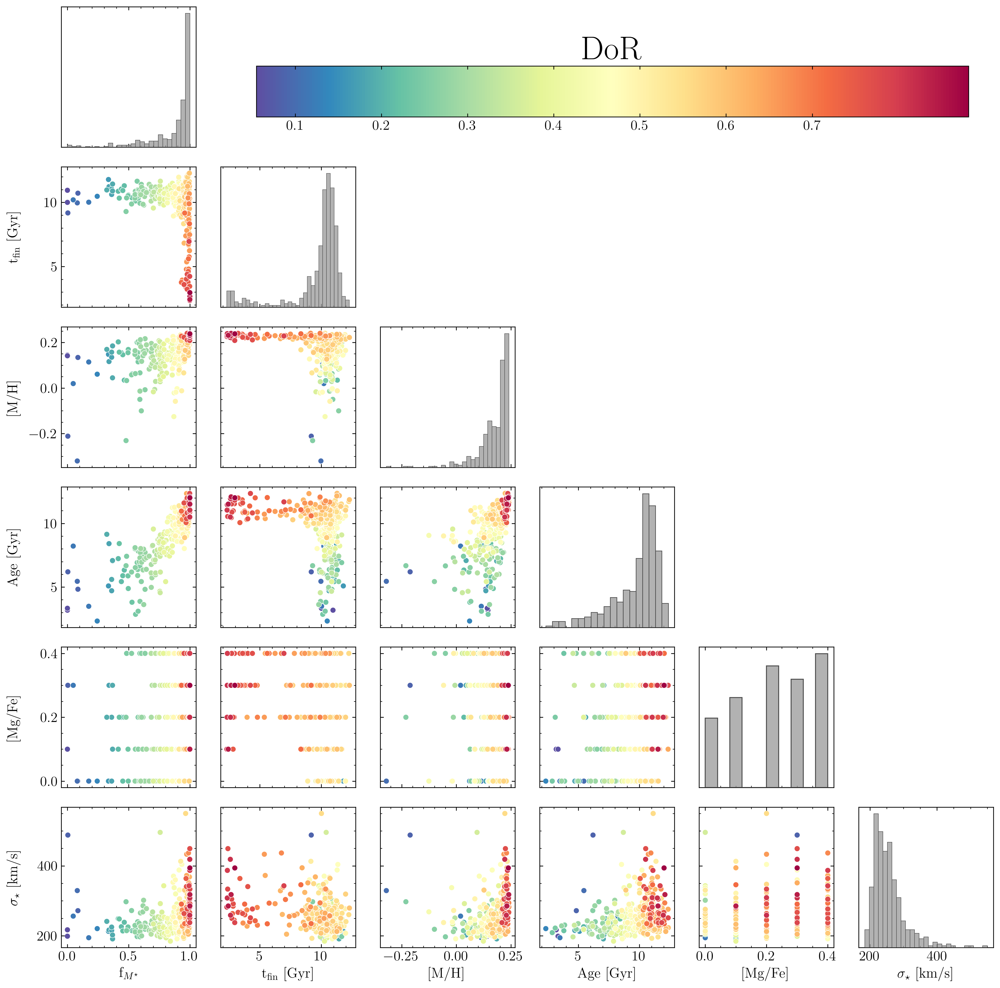

In [35]:
g = sns.PairGrid(df_slice, diag_sharey=False, corner=True, hue='dor', despine=False, palette='Spectral_r');
g.map_lower(sns.scatterplot);
g.map_diag(sns.histplot, hue=None, color='0.6', edgecolor='0.3');

# Add minor ticks
for ax in g.axes.flatten():
    if ax is not None:
            ax.minorticks_on()

labels = [r'f$_{M^\star}$', r't$_{\mathrm{fin}}$ [Gyr]', '[M/H]', 'Age [Gyr]', '[Mg/Fe]', r'$\sigma_{\star}$ [km/s]']

# Edit x and y labels
for i in range(6):
    ax = g.axes[-1,i]
    ax.set_xlabel(labels[i])

    ax = g.axes[i,0]
    ax.set_ylabel(labels[i])
    ax.yaxis.set_label_coords(-0.3,0.5)

# Add colorbar
norm = mcolors.Normalize(vmin=df_slice['dor'].min(), vmax=df_slice['dor'].max())
sm = plt.cm.ScalarMappable(cmap='Spectral_r', norm=norm)
sm.set_array([])

# Create an axis for the colorbar in the figure of the PairGrid
cbar_ax = g.fig.add_axes([0.25, 0.87, 0.7, 0.05])
plt.colorbar(sm, cax=cbar_ax, orientation='horizontal', ticks=[0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7]);
cbar_ax.set_title('DoR', fontsize=35)
cbar_ax.xaxis.set_ticks_position('bottom')

g.tick_params(axis='both',which='both',direction='in', right=True, top=True);

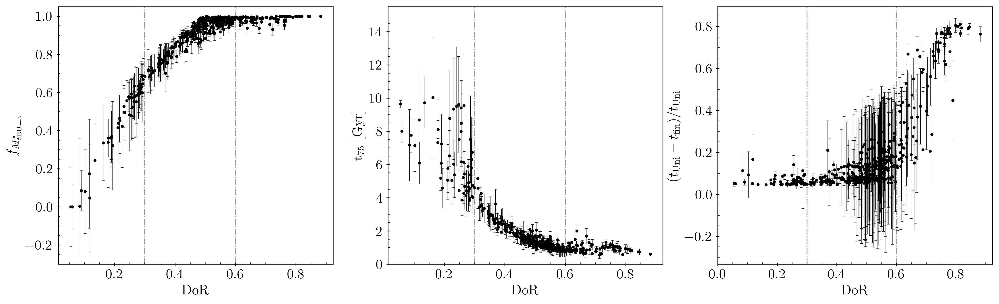

In [19]:
# fig, axs = plt.subplots(3, 1, sharex=True, figsize=(5, 12))
fig, axs = plt.subplots(1, 3, figsize=(18, 5))
# fig.subplots_adjust(hspace=0.01)

axs[0].axvline(0.3, color='0.6', linestyle='-.', linewidth=1, zorder=0)
axs[0].axvline(0.6, color='0.6', linestyle='-.', linewidth=1, zorder=0)
axs[0].set_ylim(top=1.05, bottom=-0.3)
err_mass_frac = np.nanstd([df['mass_frac_reg'].values, df['mass_frac_unr'].values, df['mass_frac_plus'], df['mass_frac_min']], axis=0)
axs[0].errorbar(df['dor'], df['mass_frac'], yerr=err_mass_frac, fmt='none', c='k', zorder=1, capsize=1.5, elinewidth=0.3, capthick=0.3)
axs[0].scatter(df['dor'], df['mass_frac'], s=5, c='black', label='SDSS')
# axs[0].errorbar(df_inspire['DoR'], df_inspire['Mtbb3'], yerr=df_inspire['stdev_Mt3'], fmt='none', c='r', zorder=1, capsize=1.5, elinewidth=0.3, capthick=0.3)
# axs[0].scatter(df_inspire['DoR'], df_inspire['Mtbb3'], s=5, c='red', label='INSPIRE DR3')
axs[0].set_xlabel('DoR')
axs[0].set_ylabel(r'$f_{M^{\star}_{t\mathrm{BB}=3}}$')
axs[0].minorticks_on()
axs[0].tick_params(axis='both',which='major',direction='inout')
axs[0].tick_params(axis='both',which='minor',direction='in')

axs[1].axvline(0.3, color='0.6', linestyle='-.', linewidth=1, zorder=0)
axs[1].axvline(0.6, color='0.6', linestyle='-.', linewidth=1, zorder=0)
axs[1].set_ylim(top=15.5, bottom=0)
err_time_75 = np.nanstd([df['time_75_reg'].values, df['time_75_unr'].values, df['time_75_plus'], df['time_75_min']], axis=0)
axs[1].errorbar(df['dor'], df['time_75'], yerr=err_time_75, fmt='none', c='k', zorder=1, capsize=1.5, elinewidth=0.3, capthick=0.3)
axs[1].scatter(df['dor'], df['time_75'], s=5, c='black')
# axs[1].errorbar(df_inspire['DoR'], df_inspire['t_75'], yerr=df_inspire['stdev_t75'], fmt='none', c='r', zorder=1, capsize=1.5, elinewidth=0.3, capthick=0.3)
# axs[1].scatter(df_inspire['DoR'], df_inspire['t_75'], s=5, c='red')
axs[1].set_xlabel('DoR')
axs[1].set_ylabel(r't$_{75}$ [Gyr]')
axs[1].minorticks_on()
axs[1].tick_params(axis='both',which='major',direction='inout')
axs[1].tick_params(axis='both',which='minor',direction='in')

axs[2].axvline(0.3, color='0.6', linestyle='-.', linewidth=1, zorder=0)
axs[2].axvline(0.6, color='0.6', linestyle='-.', linewidth=1, zorder=0)
axs[2].errorbar(df['dor'], (np.array(df['univ_age'])-np.array(df['time_100']))/np.array(df['univ_age']), fmt='none', yerr=df['t_ass_err'], c='k', zorder=1, capsize=1.5, elinewidth=0.3, capthick=0.3)
axs[2].scatter(df['dor'],(np.array(df['univ_age'])-np.array(df['time_100']))/np.array(df['univ_age']), s=5, c='black')
# axs[2].errorbar(df_inspire['DoR'],(np.array(df_inspire['tuni'])-np.array(df_inspire['t_final']))/np.array(df_inspire['tuni']), fmt='none', yerr=df_inspire['t_ass_err'], c='r', zorder=1, capsize=1.5, elinewidth=0.3, capthick=0.3)
# axs[2].scatter(df_inspire['DoR'],(np.array(df_inspire['tuni'])-np.array(df_inspire['t_final']))/np.array(df_inspire['tuni']), s=5, c='r')
axs[2].set_xlabel('DoR')
axs[2].set_xticks([0, 0.2, 0.4, 0.6, 0.8])
axs[2].set_ylabel(r'$(t_{\mathrm{Uni}} - t_{\mathrm{fin}})/t_{\mathrm{Uni}}$')
axs[2].minorticks_on()
axs[2].tick_params(axis='both',which='major',direction='inout')
axs[2].tick_params(axis='both',which='minor',direction='in')

# plt.figlegend(loc=[0.275,0.925], ncol=2, fontsize=12, fancybox=False, edgecolor='black');

# fig.savefig('/Users/johnmills/Summer project/paper_plots/dor_properties.pdf', bbox_inches='tight', dpi=300)

In [37]:
ages_unr = []
ages_reg = []
Zs_unr = []
Zs_reg = []

for index, row in df.iterrows():

    name = row['sexa_id']
    fitsfilea = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_UNR.fits'
    fitsfileb = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_REGUL.fits'

    hdua = fits.open(fitsfilea)
    hdub = fits.open(fitsfileb)

    univ_age = row['univ_age']

    logage_unr = hdua[0].header['HIERARCH mean_age_unr']
    logage_reg = hdub[0].header['HIERARCH mean_age_unr']
    age_unr = 10**logage_unr
    age_reg = 10**logage_reg

    ages_unr.append(univ_age - (age_unr/10**9))
    ages_reg.append(univ_age - (age_reg/10**9))

    Z_unr = hdua[0].header['HIERARCH mean_metal_unr']
    Z_reg = hdub[0].header['HIERARCH mean_metal_unr']

    Zs_unr.append(Z_unr)
    Zs_reg.append(Z_reg)

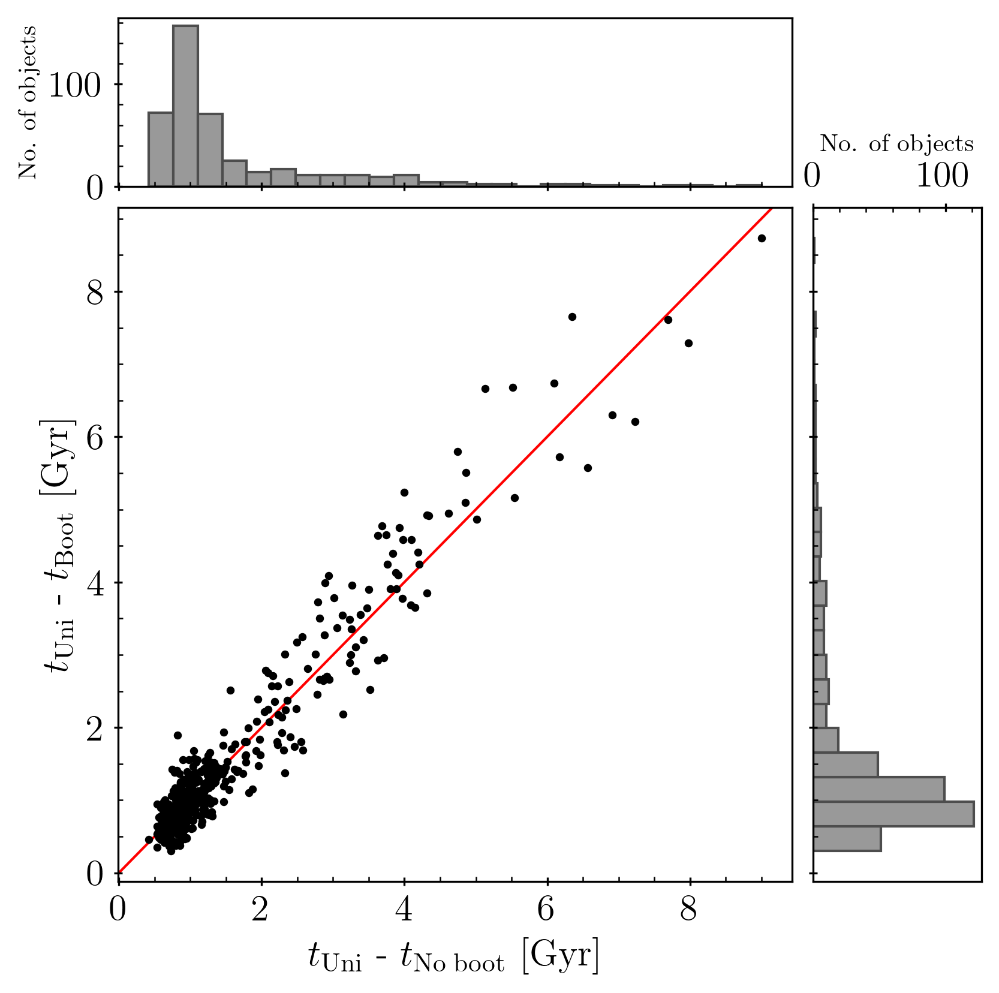

In [38]:
# Start with a square Figure.
fig = plt.figure(figsize=(6, 6))
# Add a gridspec with two rows and two columns and a ratio of 1 to 4 between
# the size of the marginal Axes and the main Axes in both directions.
# Also adjust the subplot parameters for a square plot.
gs = fig.add_gridspec(2, 2,  width_ratios=(4, 1), height_ratios=(1, 4),
                      left=0.1, right=0.9, bottom=0.1, top=0.9,
                      wspace=0.05, hspace=0.05)
# Create the Axes.
ax = fig.add_subplot(gs[1, 0])
ax_histx = fig.add_subplot(gs[0, 0], sharex=ax)
ax_histy = fig.add_subplot(gs[1, 1], sharey=ax)

ax_histx.tick_params(axis="x", labelbottom=False)
ax_histy.tick_params(axis="y", labelleft=False)

# the scatter plot:
ax.scatter(ages_unr, ages_reg, s=5, c='k')
ax.axline((1,1), slope=1, color='red', linestyle='-', linewidth=1, zorder=0)
ax.set_xlabel(r'$t_{\mathrm{Uni}}$ - $t_{\mathrm{No\; boot}}$ [Gyr]')
ax.set_ylabel(r'$t_{\mathrm{Uni}}$ - $t_{\mathrm{Boot}}$ [Gyr]')
ax.minorticks_on()
ax.tick_params(axis='both',which='major',direction='inout')
ax.tick_params(axis='both',which='minor',direction='in')

ax_histx.hist(ages_unr, bins=25, color='0.6', edgecolor='0.3')
ax_histx.set_ylabel('No. of objects', fontsize=10)
ax_histx.minorticks_on()
ax_histx.tick_params(axis='both',which='major',direction='inout')
ax_histx.tick_params(axis='both',which='minor',direction='in')
ax_histy.hist(ages_reg, bins=25, color='0.6', edgecolor='0.3', orientation='horizontal')
ax_histy.set_xlabel('No. of objects', fontsize=10)
ax_histy.minorticks_on()
ax_histy.tick_params(axis='both',which='major',direction='inout')
ax_histy.tick_params(axis='both',which='minor',direction='in')
ax_histy.xaxis.tick_top()
ax_histy.xaxis.set_label_position('top')

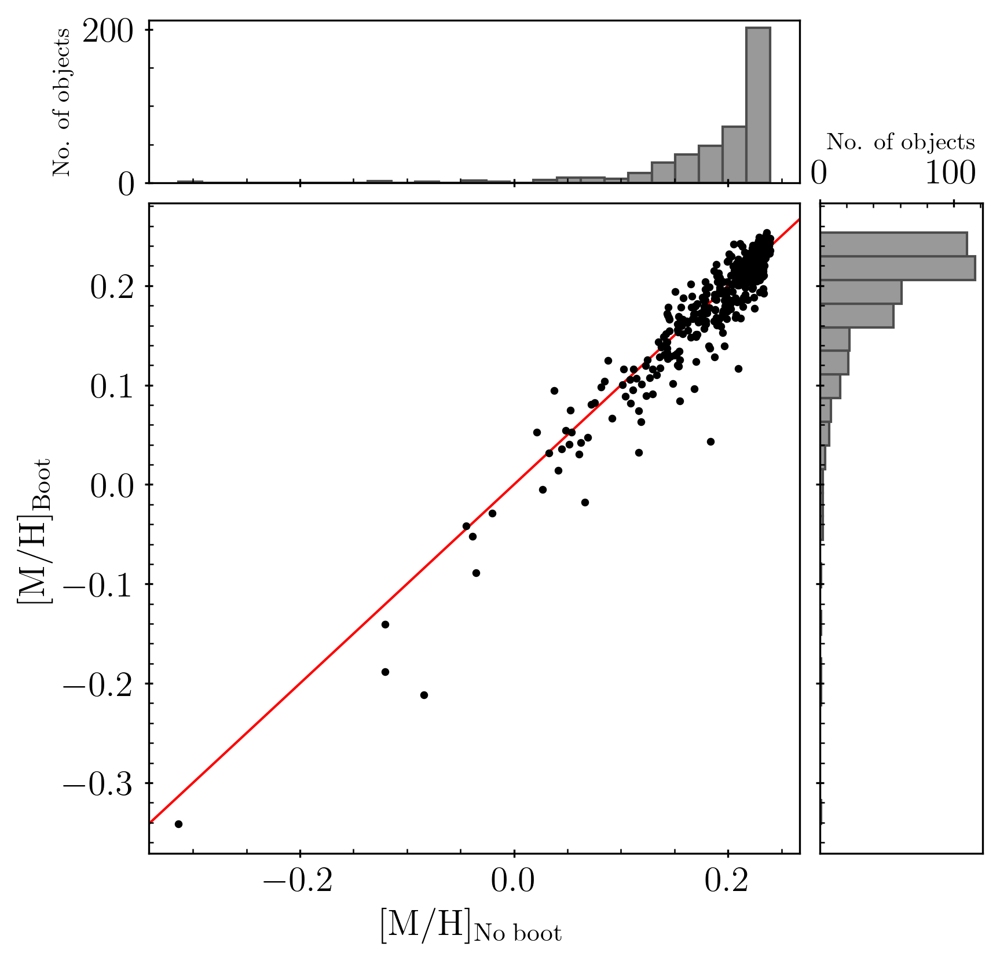

In [39]:
# Start with a square Figure.
fig = plt.figure(figsize=(6, 6))
# Add a gridspec with two rows and two columns and a ratio of 1 to 4 between
# the size of the marginal Axes and the main Axes in both directions.
# Also adjust the subplot parameters for a square plot.
gs = fig.add_gridspec(2, 2,  width_ratios=(4, 1), height_ratios=(1, 4),
                      left=0.1, right=0.9, bottom=0.1, top=0.9,
                      wspace=0.05, hspace=0.05)
# Create the Axes.
ax = fig.add_subplot(gs[1, 0])
ax_histx = fig.add_subplot(gs[0, 0], sharex=ax)
ax_histy = fig.add_subplot(gs[1, 1], sharey=ax)

ax_histx.tick_params(axis="x", labelbottom=False)
ax_histy.tick_params(axis="y", labelleft=False)

# the scatter plot:
ax.scatter(Zs_unr, Zs_reg, s=5, c='k')
ax.axline((0,0), slope=1, color='red', linestyle='-', linewidth=1, zorder=0)
ax.set_xlabel(r'[M/H]$_{\mathrm{No\; boot}}$')
ax.set_ylabel(r'[M/H]$_{\mathrm{Boot}}$')
ax.minorticks_on()
ax.tick_params(axis='both',which='major',direction='inout')
ax.tick_params(axis='both',which='minor',direction='in')

ax_histx.hist(Zs_unr, bins=25, color='0.6', edgecolor='0.3')
ax_histx.set_ylabel('No. of objects', fontsize=10)
ax_histx.minorticks_on()
ax_histx.tick_params(axis='both',which='major',direction='inout')
ax_histx.tick_params(axis='both',which='minor',direction='in')
ax_histy.hist(Zs_reg, bins=25, color='0.6', edgecolor='0.3', orientation='horizontal')
ax_histy.set_xlabel('No. of objects', fontsize=10)
ax_histy.minorticks_on()
ax_histy.tick_params(axis='both',which='major',direction='inout')
ax_histy.tick_params(axis='both',which='minor',direction='in')
ax_histy.xaxis.tick_top()
ax_histy.xaxis.set_label_position('top')

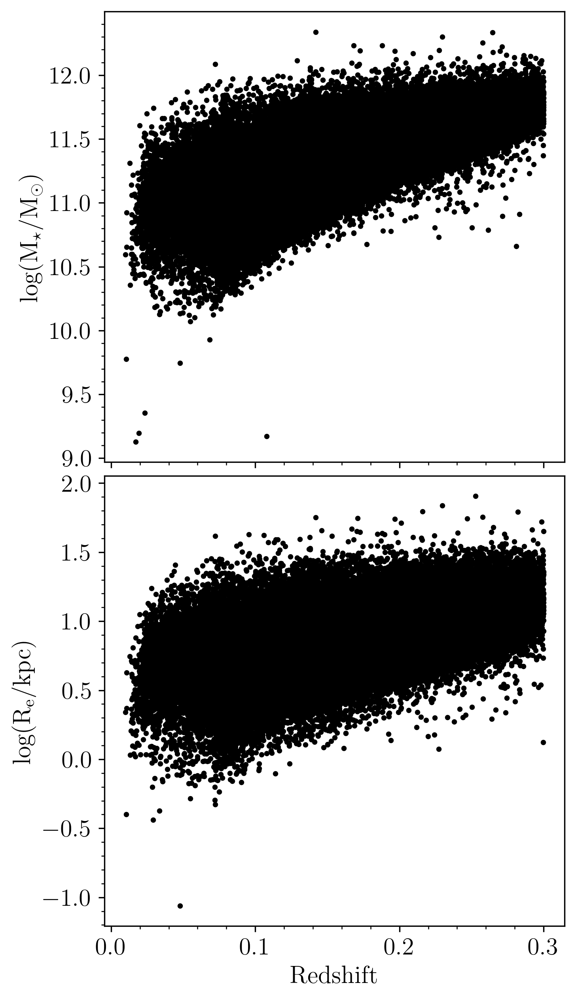

In [40]:
fig, ax = plt.subplots(2, 1, sharex=True, figsize=(5,10))
fig.subplots_adjust(hspace=0.03)

ax[0].scatter(df2['z'], df2['logM'], s=5, c='black')
ax[0].set_ylabel(r'log(M$_{\star}$/M$_{\odot}$)')
ax[0].minorticks_on()


ax[1].scatter(df2['z'], df2['logMeanRad'], s=5, c='black')
ax[1].set_xlabel('Redshift')
ax[1].set_ylabel(r'log($\mathrm{R_e}$/kpc)')
ax[1].minorticks_on()


In [41]:
df_sort = df.sort_values('SNR', ascending=False)
df_high_SNR = df_sort[:6]
df_high_SNR[['sexa_id', 'z', 'SNR', 'velDisp', 'velDispErr', 'velDisp_ppxf', 'velDisp_ppxf_err', 'velDisp_ppxf_res', 'velDisp_ppxf_err_res', 'logM', 'errlogM', 
            'meanRad_r', 'meanRadErr_r', 'meanRadkpc_r', 'meanRadErrkpc_r']]

,sexa_id,z,SNR,velDisp,velDispErr,velDisp_ppxf,velDisp_ppxf_err,velDisp_ppxf_res,velDisp_ppxf_err_res,logM,errlogM,meanRad_r,meanRadErr_r,meanRadkpc_r,meanRadErrkpc_r
319,J1203+4641,0.072320,55.611015,267.0238,5.875012,277.079659,13.853983,272.532428,13.626621,11.259,0.047,1.887789,0.013832,2.688199,0.019696
421,J2318+1507,0.170406,49.522291,225.7227,6.052492,225.814089,11.290704,224.047574,11.202379,11.471,0.012,0.923596,0.010240,2.770705,0.030719
192,J1708+2723,0.105755,49.320311,200.3277,4.697286,212.585086,10.629254,215.974180,10.798709,11.067,0.017,1.121387,0.011344,2.245977,0.022720
32,J1426+1647,0.053223,48.881329,210.1944,4.468894,212.229829,10.611491,212.688736,10.634437,10.703,0.035,0.763880,0.005261,0.818817,0.005639
266,J1443+0739,0.083505,48.839868,233.5694,4.837287,227.898856,11.394943,227.030705,11.351535,11.182,0.026,1.641218,0.020028,2.663407,0.032502
98,J1318+0114,0.078451,47.734102,244.8348,5.266136,251.503891,12.575195,249.031935,12.451597,10.893,0.009,0.920812,0.005860,1.412192,0.008986


In [42]:
df_low_SNR = df_sort[-6:]
df_low_SNR[['sexa_id', 'z', 'SNR', 'velDisp', 'velDispErr', 'velDisp_ppxf', 'velDisp_ppxf_err', 'velDisp_ppxf_res', 'velDisp_ppxf_err_res', 'logM', 'errlogM', 
            'meanRad_r', 'meanRadErr_r', 'meanRadkpc_r', 'meanRadErrkpc_r']]

,sexa_id,z,SNR,velDisp,velDispErr,velDisp_ppxf,velDisp_ppxf_err,velDisp_ppxf_res,velDisp_ppxf_err_res,logM,errlogM,meanRad_r,meanRadErr_r,meanRadkpc_r,meanRadErrkpc_r
358,J1317+3640,0.183183,13.485026,254.8097,16.23425,254.946863,25.494686,250.059664,25.005966,11.310,0.064,0.983506,0.030078,3.127189,0.095639
148,J0003+1607,0.151772,13.092823,228.6268,14.82626,213.051244,21.305124,229.602413,22.960241,10.996,0.027,0.614791,0.008649,1.677124,0.023594
49,J1035-0045,0.115605,12.360900,210.4453,14.29255,217.575233,21.757523,208.831463,20.883146,10.756,0.030,0.615060,0.011837,1.331467,0.025625
412,J0908+0656,0.221271,11.545640,325.2961,17.72642,340.693460,34.069346,331.847003,33.184700,11.447,0.056,1.000956,0.042019,3.688167,0.154824
102,J1108+5006,0.116920,11.411251,260.9227,16.24198,262.184029,26.218403,257.323520,25.732352,10.900,0.015,0.816964,0.020003,1.785981,0.043728
28,J1436+1624,0.080456,9.487587,208.5775,17.89358,207.326318,20.732632,209.731310,20.973131,10.690,0.036,0.785833,0.008965,1.233085,0.014068


In [43]:
df_med_SNR = df_sort[211:218]
df_med_SNR[['sexa_id', 'z', 'SNR', 'velDisp', 'velDispErr', 'velDisp_ppxf', 'velDisp_ppxf_err', 'velDisp_ppxf_res', 'velDisp_ppxf_err_res', 'logM', 'errlogM', 
            'meanRad_r', 'meanRadErr_r', 'meanRadkpc_r', 'meanRadErrkpc_r']]

,sexa_id,z,SNR,velDisp,velDispErr,velDisp_ppxf,velDisp_ppxf_err,velDisp_ppxf_res,velDisp_ppxf_err_res,logM,errlogM,meanRad_r,meanRadErr_r,meanRadkpc_r,meanRadErrkpc_r
80,J1512+4351,0.130004,22.497817,208.5151,10.055290,214.945431,21.494543,210.207645,21.020765,10.847,0.038,0.536664,0.016175,1.285195,0.038734
133,J1540+1453,0.113376,22.445346,233.8787,9.583287,282.356110,28.235611,249.334170,24.933417,10.958,0.011,0.798312,0.008749,1.699184,0.018621
234,J0040+0332,0.166694,22.410906,271.9322,12.260810,283.275769,28.327577,300.533439,30.053344,11.139,0.031,0.856571,0.017485,2.524043,0.051523
132,J1350+2732,0.140002,22.395637,228.9052,10.271350,229.606197,22.960620,237.533218,23.753322,10.955,0.027,0.675147,0.013289,1.721572,0.033886
117,J1138+3355,0.237948,22.394782,229.5117,12.298690,214.513114,21.451311,219.178182,21.917818,10.930,0.053,0.479986,0.012248,1.868136,0.047671
312,J1550+5627,0.179185,22.190100,297.1219,12.111570,330.453592,33.045359,318.940989,31.894099,11.247,0.007,0.795662,0.013596,2.485629,0.042474
374,J1704+2919,0.207941,22.184300,207.9355,8.906707,193.947750,19.394775,212.440480,21.244048,11.348,0.039,0.991159,0.030946,3.481921,0.108714


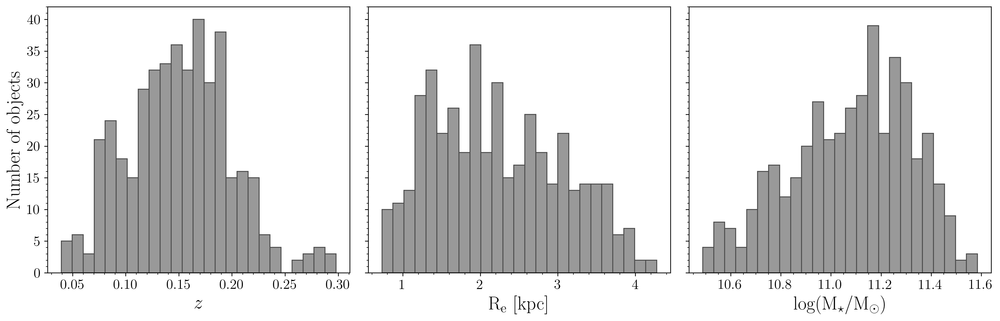

In [44]:
fig, axs = plt.subplots(1, 3, figsize=(15, 5), sharey=True)

axs[0].hist(df['z'], bins=25, color='0.6', edgecolor='0.3')
axs[0].set_xlabel('$z$', fontsize=20)
axs[0].set_ylabel('Number of objects', fontsize=20)
axs[0].minorticks_on()

axs[1].hist(df['meanRadkpc_r'], bins=25, color='0.6', edgecolor='0.3')
axs[1].set_xlabel(r'$\mathrm{R_e}$ [kpc]', fontsize=20)
axs[1].minorticks_on()

axs[2].hist(df['logM'], bins=25, color='0.6', edgecolor='0.3')
axs[2].set_xlabel(r'log(M$_{\star}$/M$_{\odot}$)', fontsize=20)
axs[2].minorticks_on()

plt.tight_layout()

fig.savefig('/Users/johnmills/Summer project/paper_plots/histograms.pdf', bbox_inches='tight', dpi=300)

In [45]:
df_sort2 = df.sort_values('velDisp_ppxf', ascending=False)
df_high_sigma = df_sort2[:6]
df_high_sigma[['sexa_id', 'z', 'SNR', 'velDisp', 'velDispErr', 'velDisp_ppxf', 'velDisp_ppxf_err', 'velDisp_ppxf_res', 'velDisp_ppxf_err_res', 'logM', 'errlogM', 
            'meanRad_r', 'meanRadErr_r', 'meanRadkpc_r', 'meanRadErrkpc_r']]

,sexa_id,z,SNR,velDisp,velDispErr,velDisp_ppxf,velDisp_ppxf_err,velDisp_ppxf_res,velDisp_ppxf_err_res,logM,errlogM,meanRad_r,meanRadErr_r,meanRadkpc_r,meanRadErrkpc_r
419,J1328+2757,0.134168,29.341553,499.0596,16.84771,549.895818,54.989582,533.895862,53.389586,11.461,0.026,1.400873,0.016163,3.445934,0.039760
423,J0103+1426,0.188857,23.466670,435.2816,17.58030,495.780515,49.578051,488.833135,48.883313,11.481,0.022,1.186273,0.024136,3.864564,0.078627
427,J2223-0012,0.293442,21.716477,259.8880,18.00568,488.076945,48.807695,362.844180,36.284418,11.545,0.028,0.772690,0.030071,3.498231,0.136140
393,J1022+0521,0.183499,16.842732,430.9847,19.93083,449.279831,44.927983,430.087714,43.008771,11.389,0.032,1.167726,0.026800,3.718044,0.085331
322,J0946+4929,0.167626,19.426619,363.0804,17.50255,436.794895,43.679490,414.050786,41.405079,11.263,0.017,1.016641,0.028666,3.009338,0.084853
296,J1418+0807,0.142578,20.928806,370.0972,14.85691,433.219195,43.321920,425.939996,42.594000,11.226,0.015,0.964513,0.028098,2.497423,0.072755


In [46]:
df_low_sigma = df_sort2[-6:]
df_low_sigma[['sexa_id', 'z', 'SNR', 'velDisp', 'velDispErr', 'velDisp_ppxf', 'velDisp_ppxf_err', 'velDisp_ppxf_res', 'velDisp_ppxf_err_res', 'logM', 'errlogM', 
            'meanRad_r', 'meanRadErr_r', 'meanRadkpc_r', 'meanRadErrkpc_r']]

,sexa_id,z,SNR,velDisp,velDispErr,velDisp_ppxf,velDisp_ppxf_err,velDisp_ppxf_res,velDisp_ppxf_err_res,logM,errlogM,meanRad_r,meanRadErr_r,meanRadkpc_r,meanRadErrkpc_r
378,J1126+0612,0.270224,18.927763,212.4304,10.720700,194.311794,19.431179,197.183126,19.718313,11.363,0.016,0.783562,0.027968,3.346937,0.119463
374,J1704+2919,0.207941,22.184300,207.9355,8.906707,193.947750,19.394775,212.440480,21.244048,11.348,0.039,0.991159,0.030946,3.481921,0.108714
31,J0956+6017,0.114162,23.029799,204.5107,9.151789,192.649044,19.264904,196.974846,19.697485,10.702,0.014,0.572087,0.008641,1.225014,0.018503
221,J1346+2440,0.167456,21.131494,209.0549,15.058530,191.171786,19.117179,176.935251,17.693525,11.121,0.027,0.869738,0.029854,2.572377,0.088297
126,J1303+3938,0.119803,24.873741,200.5305,7.103381,190.986853,19.098685,193.547141,19.354714,10.944,0.014,0.847566,0.018238,1.892320,0.040720
344,J1523+0113,0.237625,17.288505,203.6243,10.963790,184.430765,18.443077,189.048178,18.904818,11.292,0.025,0.778150,0.029431,3.025549,0.114431


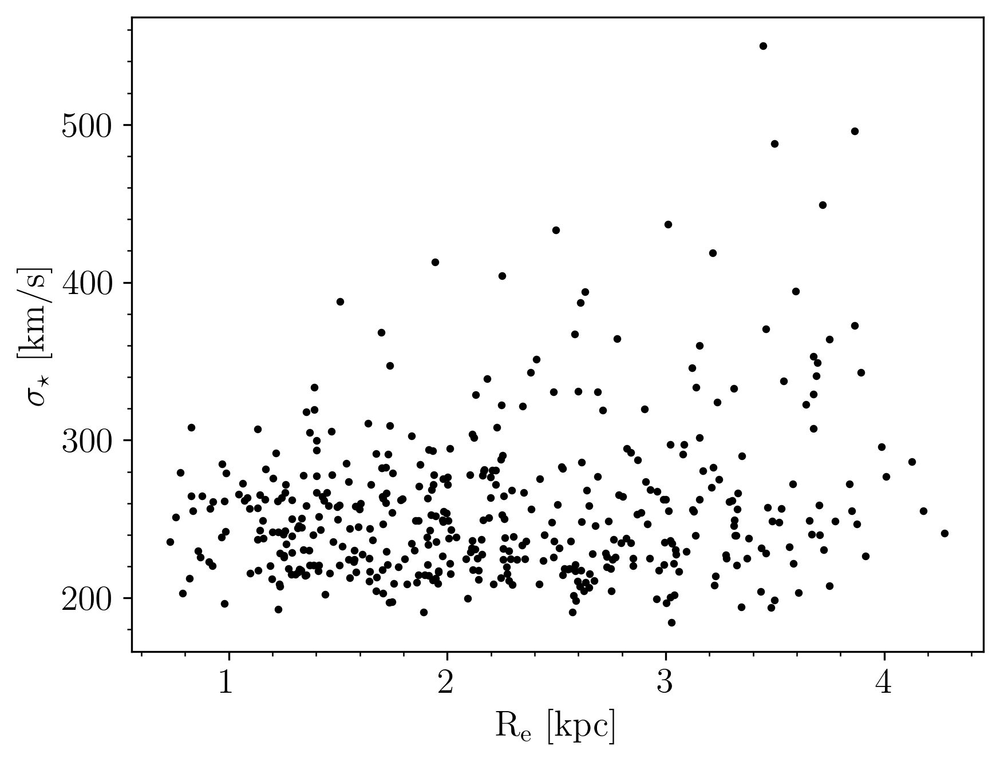

In [47]:
fig, ax = plt.subplots()
ax.scatter(df['meanRadkpc_r'], df['velDisp_ppxf'], s=5, c='black')
ax.set_xlabel(r'$\mathrm{R_e}$ [kpc]')
ax.set_ylabel(r'$\sigma_{\star}$ [km/s]')
ax.minorticks_on()

In [48]:
# Load the MILES models
miles = pd.read_csv('alpha_calculator/indices60.csv')
miles.head()

,file,[M/H],[α/Fe],Age,Sigma,z,Hbeta_o,Hbeta,Mgb,Fe5270,Fe5335,Fe_avg
0,Mbi1.30Zp0.15T06.0000_iTp0.00_Ep0.00_linear_Si...,0.15,Ep0.00,6.0,600.0,0.0,2.754646,1.660955,2.143562,1.864779,1.047728,1.456254
1,Mbi1.30Zp0.15T06.0000_iTp0.00_Ep0.00_linear_Si...,0.15,Ep0.00,6.0,250.0,0.0,3.171111,2.064967,3.378076,2.894008,2.545357,2.719682
2,Mbi1.30Zp0.06T03.0000_iTp0.00_Ep0.00_linear_Si...,0.06,Ep0.00,3.0,600.0,0.0,3.071637,1.920538,1.696706,1.600542,0.916054,1.258298
3,Mbi1.30Zm0.25T03.0000_iTp0.00_Ep0.00_linear_Si...,-0.25,Ep0.00,3.0,850.0,0.0,2.730830,1.481503,0.870889,0.829887,0.434916,0.632402
4,Mbi1.30Zp0.06T03.0000_iTp0.00_Ep0.00_linear_Si...,0.06,Ep0.00,3.0,250.0,0.0,3.516680,2.440021,2.699318,2.493488,2.211531,2.352510


In [49]:
age = 11.00
metal = 0.06
alpha = 'Ep0.00'
miles_sort = miles.sort_values('Sigma')

x = miles_sort['Sigma'][(miles_sort['Age']==age)&(miles_sort['[M/H]']==metal)&(miles_sort['[α/Fe]']==alpha)]
y = miles_sort['Fe_avg'][(miles_sort['Age']==age)&(miles_sort['[M/H]']==metal)&(miles_sort['[α/Fe]']==alpha)]
y0 = y.loc[x==x.min()].values[0]
y_n = y0/y
print(y_n)

178    1.000000
145    1.168449
161    1.268701
44     1.385207
202    1.655246
159    2.367071
128    4.110094
Name: Fe_avg, dtype: float64


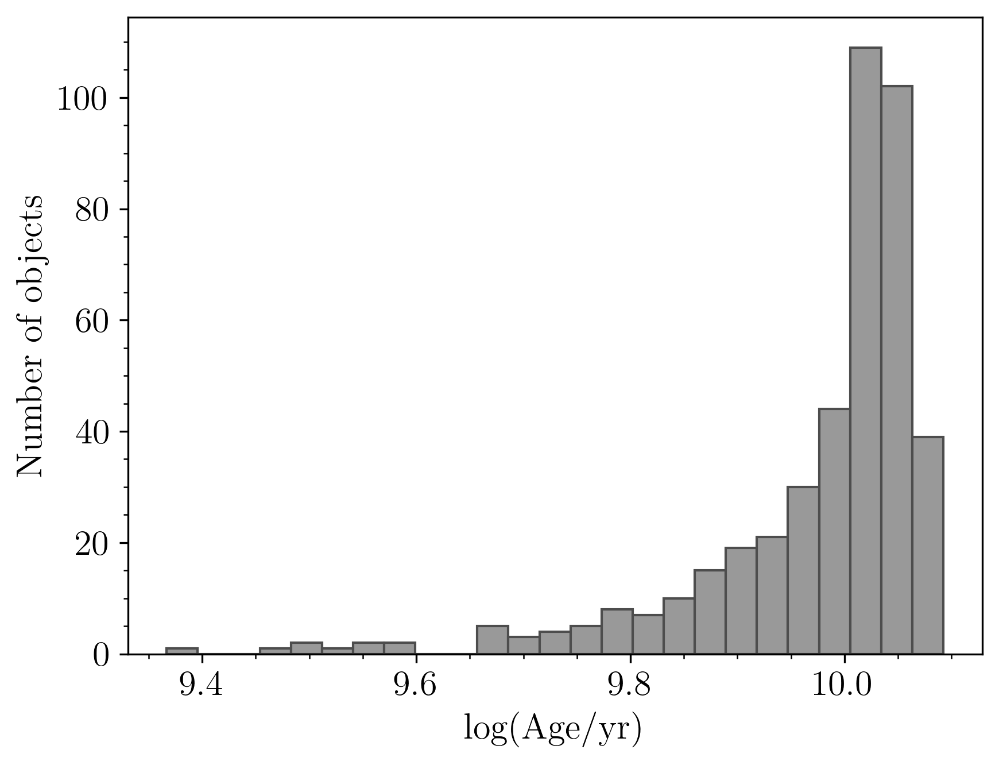

In [50]:
fig, ax = plt.subplots()

ax.hist(df['logAge_mean'], bins=25, color='0.6', edgecolor='0.3');
ax.set_xlabel('log(Age/yr)')
ax.set_ylabel('Number of objects')
ax.minorticks_on()

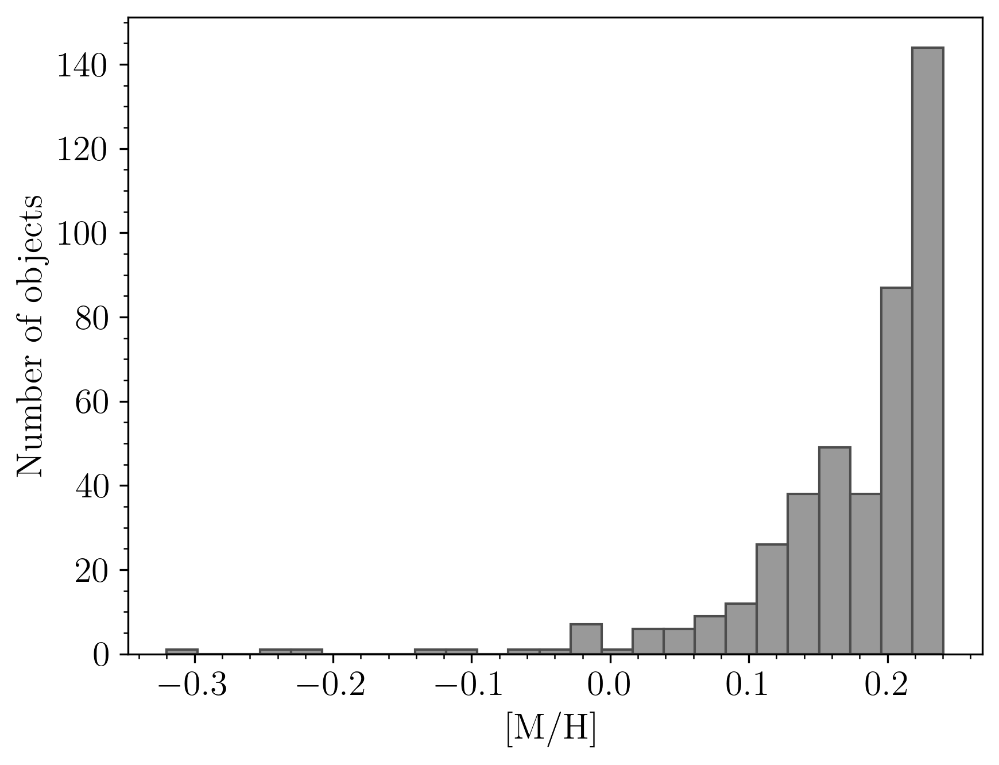

In [51]:
fig, ax = plt.subplots()

ax.hist(df['[M/H]_mean'], bins=25, color='0.6', edgecolor='0.3');
ax.set_xlabel('[M/H]')
ax.set_ylabel('Number of objects')
ax.minorticks_on()

In [52]:
dor_high = df[df['dor'] == df['dor'].max()]
dor_high.head()

,ra,dec,deVRad_r,deVRadErr_r,expRad_r,expRadErr_r,z,zErr,velDisp,velDispErr,...,delta_t_minus,delta_t,delta_t_mean,dor_mean,t_ass_err,dor_99,dor_95,dor_med,meanRad_kids,meanRadkpc_kids
241,148.886042,4.372171,1.481497,0.01906,1.309121,0.011779,0.092541,0.00002,352.0825,9.056475,...,0.2957,0.36604,0.253617,0.937934,0.03664,0.888362,0.924819,0.938909,0.695549,1.237803


In [53]:
dor_low = df[df['dor'] == df['dor'].min()]
dor_low.head()

,ra,dec,deVRad_r,deVRadErr_r,expRad_r,expRadErr_r,z,zErr,velDisp,velDispErr,...,delta_t_minus,delta_t,delta_t_mean,dor_mean,t_ass_err,dor_99,dor_95,dor_med,meanRad_kids,meanRadkpc_kids
238,346.303511,-10.555402,0.845756,0.026206,0.762754,0.00953,0.174412,0.000023,203.7827,8.069855,...,0.49957,8.43402,5.87795,0.169817,0.01533,0.066452,0.076582,0.180732,0.44063,1.346933


In [54]:
tie_balmer = True
limit_doublets = True

c = 299792.458  # speed of light in km/s

regul_err = 0.1 # Large regularization error

vel = 0   # eq.(8) of Cappellari (2017)

moments = [4, 2, 2]

gas_reddening = 0 if tie_balmer else None

In [134]:
row = df[df['sexa_id']=='J1136+0702'].iloc[0]

plate = row['plate']
mjd = row['mjd']
fiberid = row['fiberid']
txt_name = '/spec-' + f'{plate:04}' + '-' + f'{mjd:05}' + '-' + f'{fiberid:04}' + '.fits'

hdu = fits.open('/Users/johnmills/Summer project/alpha_calculator/fits_shortlist' + txt_name, ignore_missing_simple=True)
t = hdu['COADD'].data

galaxy = t['flux']/np.median(t['flux'])     # Normalize spectrum to avoid numerical issues
ln_lam_gal = t['loglam']*np.log(10)         # Convert lg --> ln
wave = np.exp(ln_lam_gal)

redshift = row['z']
sigma = row['velDisp_ppxf']
alpha = row['alpha']

if alpha < 0:
    alpha = '0'
elif alpha > 0.4:
    alpha = '4'
else:
    alpha = str(int(alpha*10))

wave = wave/(1 + redshift)  # Compute wave in the galaxy rest frame
galaxy = galaxy[(wave > 3600) & (wave < 6500)]
wave = wave[(wave > 3600) & (wave < 6500)]

wave *= np.median(util.vac_to_air(wave)/wave)

noise = np.full_like(galaxy, 0.0163)  # Assume constant noise per pixel here

d_ln_lam = np.log(wave[-1]/wave[0])/(wave.size - 1)  # Average ln_lam step
velscale = c*d_ln_lam                   # eq. (8) of Cappellari (2017)
FWHM_gal = 2.76/(1+redshift)  # SDSS has an approximate instrumental resolution FWHM of 2.76A.

filename = f'/Users/johnmills/Summer project/MILES_SSP/alpha{alpha}.npz'
sps1 = lib.sps_lib(filename, velscale, FWHM_gal, age_range=[0, NedCalculator([redshift]).zage_Gyr], metal_range=[-2, 0.35])

reg_dim = sps1.templates.shape[1:]
stars_templates = sps1.templates.reshape(sps1.templates.shape[0], -1)

lam_range_gal = np.array([np.min(wave), np.max(wave)])

gas_templates, gas_names, line_wave = util.emission_lines(
sps1.ln_lam_temp, lam_range_gal, FWHM_gal, tie_balmer=tie_balmer,
limit_doublets=limit_doublets)

templates = np.column_stack([stars_templates, gas_templates])

start = [vel, sigma]     # (km/s), starting guess for [V, sigma]

n_temps = stars_templates.shape[1]
n_forbidden = np.sum(["[" in a for a in gas_names])  # forbidden lines contain "[*]"
n_balmer = len(gas_names) - n_forbidden

component = [0]*n_temps + [1]*n_balmer + [2]*n_forbidden
gas_component = np.array(component) > 0  # gas_component=True for gas templates

start = [start, start, start]

pp = ppxf(templates, galaxy, noise, velscale, start, moments=moments,
        degree=-1, mdegree=8, lam=wave, lam_temp=sps1.lam_temp,
        regul=1/regul_err, reg_dim=reg_dim, component=component,
        gas_component=gas_component, gas_names=gas_names,
        gas_reddening=gas_reddening, quiet=True)

noise = noise*np.sqrt(pp.chi2)

pp_high = ppxf(templates, galaxy, noise, velscale, start, moments=moments,
            degree=-1, mdegree=8, lam=wave, lam_temp=sps1.lam_temp,
            regul=1/regul_err, reg_dim=reg_dim, component=component,
            gas_component=gas_component, gas_names=gas_names,
            gas_reddening=gas_reddening, clean=True, quiet=True)

weights_high = pp_high.weights[~gas_component]                # Exclude weights of the gas templates
weights_high = weights_high.reshape(reg_dim)/weights_high.sum()    # Normalized

Emission lines included in gas templates:
['Balmer' '[OII]3726_d1' '[OII]3726_d2' '[NeIII]3968' '[NeIII]3869'
 'HeII4687' 'HeI5876' '[OIII]5007_d' '[OI]6300_d']


In [139]:
row = df[df['sexa_id']=='J1600+0503'].iloc[0]

plate = row['plate']
mjd = row['mjd']
fiberid = row['fiberid']
txt_name = '/spec-' + f'{plate:04}' + '-' + f'{mjd:05}' + '-' + f'{fiberid:04}' + '.fits'

hdu = fits.open('/Users/johnmills/Summer project/alpha_calculator/fits_shortlist' + txt_name, ignore_missing_simple=True)
t = hdu['COADD'].data

galaxy = t['flux']/np.median(t['flux'])     # Normalize spectrum to avoid numerical issues
ln_lam_gal = t['loglam']*np.log(10)         # Convert lg --> ln
wave = np.exp(ln_lam_gal)

redshift = row['z']
sigma = row['velDisp_ppxf']
alpha = row['alpha']

if alpha < 0:
    alpha = '0'
elif alpha > 0.4:
    alpha = '4'
else:
    alpha = str(int(alpha*10))

wave = wave/(1 + redshift)  # Compute wave in the galaxy rest frame
galaxy = galaxy[(wave > 3600) & (wave < 6500)]
wave = wave[(wave > 3600) & (wave < 6500)]

wave *= np.median(util.vac_to_air(wave)/wave)

noise = np.full_like(galaxy, 0.0163)  # Assume constant noise per pixel here

d_ln_lam = np.log(wave[-1]/wave[0])/(wave.size - 1)  # Average ln_lam step
velscale = c*d_ln_lam                   # eq. (8) of Cappellari (2017)
FWHM_gal = 2.76/(1+redshift)  # SDSS has an approximate instrumental resolution FWHM of 2.76A.

filename = f'/Users/johnmills/Summer project/MILES_SSP/alpha{alpha}.npz'
sps2 = lib.sps_lib(filename, velscale, FWHM_gal, age_range=[0, NedCalculator([redshift]).zage_Gyr], metal_range=[-2, 0.35])

reg_dim = sps2.templates.shape[1:]
stars_templates = sps2.templates.reshape(sps2.templates.shape[0], -1)

lam_range_gal = np.array([np.min(wave), np.max(wave)])

gas_templates, gas_names, line_wave = util.emission_lines(
sps2.ln_lam_temp, lam_range_gal, FWHM_gal, tie_balmer=tie_balmer,
limit_doublets=limit_doublets)

templates = np.column_stack([stars_templates, gas_templates])

start = [vel, sigma]     # (km/s), starting guess for [V, sigma]

n_temps = stars_templates.shape[1]
n_forbidden = np.sum(["[" in a for a in gas_names])  # forbidden lines contain "[*]"
n_balmer = len(gas_names) - n_forbidden

component = [0]*n_temps + [1]*n_balmer + [2]*n_forbidden
gas_component = np.array(component) > 0  # gas_component=True for gas templates

start = [start, start, start]

pp = ppxf(templates, galaxy, noise, velscale, start, moments=moments,
        degree=-1, mdegree=8, lam=wave, lam_temp=sps2.lam_temp,
        regul=1/regul_err, reg_dim=reg_dim, component=component,
        gas_component=gas_component, gas_names=gas_names,
        gas_reddening=gas_reddening, quiet=True)

noise = noise*np.sqrt(pp.chi2)

pp_low = ppxf(templates, galaxy, noise, velscale, start, moments=moments,
            degree=-1, mdegree=8, lam=wave, lam_temp=sps2.lam_temp,
            regul=1/regul_err, reg_dim=reg_dim, component=component,
            gas_component=gas_component, gas_names=gas_names,
            gas_reddening=gas_reddening, clean=True, quiet=True)

weights_low = pp_low.weights[~gas_component]                # Exclude weights of the gas templates
weights_low = weights_low.reshape(reg_dim)/weights_low.sum()    # Normalized

Emission lines included in gas templates:
['Balmer' '[OII]3726_d1' '[OII]3726_d2' '[NeIII]3968' '[NeIII]3869'
 'HeII4687' 'HeI5876' '[OIII]5007_d' '[OI]6300_d']


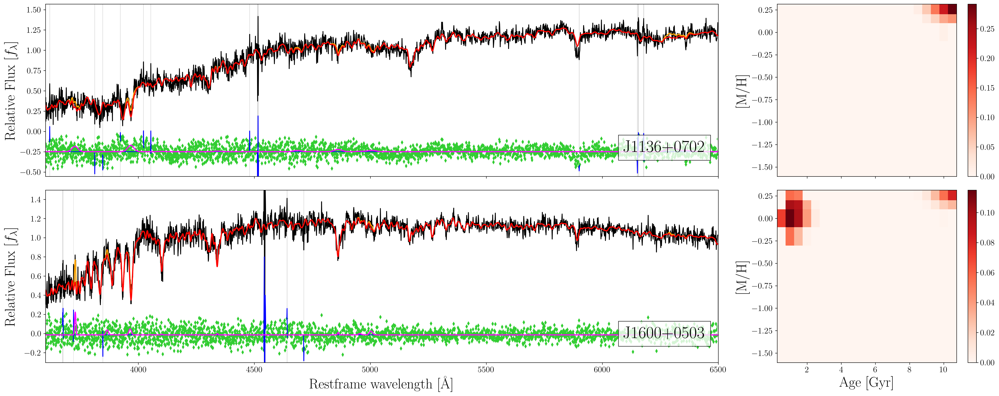

In [141]:
fig = plt.figure(figsize=(25,10))

gs = gridspec.GridSpec(2, 2, width_ratios=[3, 1])
props = dict(boxstyle='square', facecolor='white', alpha=0.8, edgecolor='black')
hor_align = 0.92
ver_align = 0.21

ax1 = fig.add_subplot(gs[0])
pp_high.plot()
ax1.set_xlabel('')
textstr = 'J1136+0702'
ax1.text(hor_align, ver_align, textstr, transform=ax1.transAxes, fontsize=30,
        verticalalignment='top', bbox=props, ha='center', linespacing=1.5)

ax2 = fig.add_subplot(gs[1])
sps1.plot(weights_high)
ax2.set_xlabel('')
ax2.set_title('')

ax3 = fig.add_subplot(gs[2], sharex=ax1)
pp_low.plot()
ax3.set_xlim([3600, 6500])
textstr = 'J1600+0503'
ax3.text(hor_align, ver_align, textstr, transform=ax3.transAxes, fontsize=30,
        verticalalignment='top', bbox=props, ha='center', linespacing=1.5)

ax4 = fig.add_subplot(gs[3], sharex=ax2)
sps2.plot(weights_low, nodots=True)
ax4.set_title('')

plt.setp(ax1.get_xticklabels(), visible=False)
plt.setp(ax2.get_xticklabels(), visible=False)

plt.tight_layout()
fig.align_ylabels([ax1, ax3])

plt.savefig('/Users/johnmills/Summer project/paper_plots/stelpopfit.pdf', bbox_inches='tight', dpi=300)

For the table containing the stellar population parameters of selected systems, note the following:

1. The dataframe currently contains age and [M/H] for the bootstrapped fit

2. Therefore I need to obtain the ages and metallicities of all the fits of each system

3. Worth including these as new columns in the dataframe

4. Also need errors with I obtain as standard deviations of all the fits

Therefore, the plan of action is:

1. Rename the current age and metallicities on the data frame to reflect the fact they are boostrapped

2. Obtain values for all the other fits in a for loop and add them to the dataframe

3. Take the mean and standard deviation of for each system and put that in new columns

In [58]:
#Rename columns

df = df.rename(columns={'logAge': 'logAge_boot', '[M/H]': '[M/H]_boot'})
df.columns

Index(['ra', 'dec', 'deVRad_r', 'deVRadErr_r', 'expRad_r', 'expRadErr_r', 'z',
       'zErr', 'velDisp', 'velDispErr',
       ...
       'delta_t_minus', 'delta_t', 'delta_t_mean', 'dor_mean', 't_ass_err',
       'dor_99', 'dor_95', 'dor_med', 'meanRad_kids', 'meanRadkpc_kids'],
      dtype='object', length=101)

In [59]:
ages_unr = []
Zs_unr = []

ages_plus = []
Zs_plus = []

ages_minus = []
Zs_minus = []

In [60]:
for index, row in df.iterrows():
    
    fitsfilea = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+row['sexa_id']+'_ppxfout_UNR.fits'
    fitsfileb = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+row['sexa_id']+'_ppxfout_plus.fits'
    fitsfilec = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+row['sexa_id']+'_ppxfout_minus.fits'

    hdua = fits.open(fitsfilea)
    age_unr = hdua[0].header['HIERARCH mean_age_unr']
    Z_unr = hdua[0].header['HIERARCH mean_metal_unr']
    ages_unr.append(age_unr)
    Zs_unr.append(Z_unr)

    if exists(fitsfileb):
        hdub = fits.open(fitsfileb)
        age_plus = hdub[0].header['HIERARCH mean_age_unr']
        Z_plus = hdub[0].header['HIERARCH mean_metal_unr']
        ages_plus.append(age_plus)
        Zs_plus.append(Z_plus)
    else:
        ages_plus.append(np.nan)
        Zs_plus.append(np.nan)

    if exists(fitsfilec):
        hduc = fits.open(fitsfilec)
        age_minus = hduc[0].header['HIERARCH mean_age_unr']
        Z_minus = hduc[0].header['HIERARCH mean_metal_unr']
        ages_minus.append(age_minus)
        Zs_minus.append(Z_minus)
    else:
        ages_minus.append(np.nan)
        Zs_minus.append(np.nan)

In [61]:
df['logAge_noboot'] = ages_unr
df['[M/H]_noboot'] = Zs_unr

df['logAge_plus'] = ages_plus
df['[M/H]_plus'] = Zs_plus

df['logAge_minus'] = ages_minus
df['[M/H]_minus'] = Zs_minus

df.head()

,ra,dec,deVRad_r,deVRadErr_r,expRad_r,expRadErr_r,z,zErr,velDisp,velDispErr,...,delta_t_minus,delta_t,delta_t_mean,dor_mean,t_ass_err,dor_99,dor_95,dor_med,meanRad_kids,meanRadkpc_kids
28,219.018956,16.401985,0.789748,0.019822,0.783838,0.009023,0.080456,0.000031,208.5775,17.89358,...,NaN,0.92376,0.441253,0.578456,0.006425,0.558260,0.705984,0.524282,0.412060,0.646580
102,167.017385,50.109943,0.808850,0.026465,0.839395,0.016450,0.116920,0.000037,260.9227,16.24198,...,0.66109,0.89516,0.492270,0.784839,0.191365,0.780313,0.794384,0.780612,0.427033,0.933546
412,137.170747,6.949240,1.000956,0.042019,0.787853,0.017250,0.221271,0.000047,325.2961,17.72642,...,0.46333,0.64758,0.437327,0.824946,0.068077,0.766875,0.803118,0.824684,0.510234,1.880030
49,158.928435,-0.752734,0.503346,0.019465,0.615060,0.011837,0.115605,0.000038,210.4453,14.29255,...,NaN,1.77273,1.092350,0.549544,0.226140,0.481335,0.630876,0.502078,0.324039,0.701472
148,0.777437,16.130881,0.531968,0.020677,0.614791,0.008649,0.151772,0.000035,228.6268,14.82626,...,NaN,1.13852,0.843657,0.611504,0.269532,0.534836,0.687381,0.571475,0.323891,0.883562


In [62]:
df['logAge_err'] = np.nanstd([df['logAge_noboot'].values, df['logAge_boot'].values, df['logAge_plus'].values, df['logAge_minus'].values], axis=0)
df['[M/H]_err'] = np.nanstd([df['[M/H]_noboot'].values, df['[M/H]_boot'].values, df['[M/H]_plus'].values, df['[M/H]_minus'].values], axis=0)

df.head()

,ra,dec,deVRad_r,deVRadErr_r,expRad_r,expRadErr_r,z,zErr,velDisp,velDispErr,...,delta_t_minus,delta_t,delta_t_mean,dor_mean,t_ass_err,dor_99,dor_95,dor_med,meanRad_kids,meanRadkpc_kids
28,219.018956,16.401985,0.789748,0.019822,0.783838,0.009023,0.080456,0.000031,208.5775,17.89358,...,NaN,0.92376,0.441253,0.578456,0.006425,0.558260,0.705984,0.524282,0.412060,0.646580
102,167.017385,50.109943,0.808850,0.026465,0.839395,0.016450,0.116920,0.000037,260.9227,16.24198,...,0.66109,0.89516,0.492270,0.784839,0.191365,0.780313,0.794384,0.780612,0.427033,0.933546
412,137.170747,6.949240,1.000956,0.042019,0.787853,0.017250,0.221271,0.000047,325.2961,17.72642,...,0.46333,0.64758,0.437327,0.824946,0.068077,0.766875,0.803118,0.824684,0.510234,1.880030
49,158.928435,-0.752734,0.503346,0.019465,0.615060,0.011837,0.115605,0.000038,210.4453,14.29255,...,NaN,1.77273,1.092350,0.549544,0.226140,0.481335,0.630876,0.502078,0.324039,0.701472
148,0.777437,16.130881,0.531968,0.020677,0.614791,0.008649,0.151772,0.000035,228.6268,14.82626,...,NaN,1.13852,0.843657,0.611504,0.269532,0.534836,0.687381,0.571475,0.323891,0.883562


In [63]:
df['logAge_mean'] = np.nanmean([df['logAge_noboot'].values, df['logAge_boot'].values, df['logAge_plus'].values, df['logAge_minus'].values], axis=0)
df['[M/H]_mean'] = np.nanmean([df['[M/H]_noboot'].values, df['[M/H]_boot'].values, df['[M/H]_plus'].values, df['[M/H]_minus'].values], axis=0)
df.head()

,ra,dec,deVRad_r,deVRadErr_r,expRad_r,expRadErr_r,z,zErr,velDisp,velDispErr,...,delta_t_minus,delta_t,delta_t_mean,dor_mean,t_ass_err,dor_99,dor_95,dor_med,meanRad_kids,meanRadkpc_kids
28,219.018956,16.401985,0.789748,0.019822,0.783838,0.009023,0.080456,0.000031,208.5775,17.89358,...,NaN,0.92376,0.441253,0.578456,0.006425,0.558260,0.705984,0.524282,0.412060,0.646580
102,167.017385,50.109943,0.808850,0.026465,0.839395,0.016450,0.116920,0.000037,260.9227,16.24198,...,0.66109,0.89516,0.492270,0.784839,0.191365,0.780313,0.794384,0.780612,0.427033,0.933546
412,137.170747,6.949240,1.000956,0.042019,0.787853,0.017250,0.221271,0.000047,325.2961,17.72642,...,0.46333,0.64758,0.437327,0.824946,0.068077,0.766875,0.803118,0.824684,0.510234,1.880030
49,158.928435,-0.752734,0.503346,0.019465,0.615060,0.011837,0.115605,0.000038,210.4453,14.29255,...,NaN,1.77273,1.092350,0.549544,0.226140,0.481335,0.630876,0.502078,0.324039,0.701472
148,0.777437,16.130881,0.531968,0.020677,0.614791,0.008649,0.151772,0.000035,228.6268,14.82626,...,NaN,1.13852,0.843657,0.611504,0.269532,0.534836,0.687381,0.571475,0.323891,0.883562


In [64]:
# df.to_csv('/Users/johnmills/Summer project/DoR_fit/ppxf_stel_pop_dor_test.csv', index=False)

For table, I want 5 highest/lowest logAges (mean) and 5 highest/lowest metallicities (mean) 

In [65]:
df_sort_age = df.sort_values('age_mean', ascending=False)
df_age_high = df_sort_age[:6]
df_age_med = df_sort_age[212:218]
df_age_low = df_sort_age[-6:]

df_sort_metal = df.sort_values('[M/H]_mean', ascending=False)
df_metal_high = df_sort_metal[:6]
df_metal_med = df_sort_metal[212:218]
df_metal_low = df_sort_metal[-6:]

In [66]:
df_age_high[['sexa_id', 'alpha', 'univ_age', 'age_mean', 'age_err', '[M/H]_mean', '[M/H]_err', 'age_noboot', '[M/H]_noboot', 'age_boot', '[M/H]_boot']]

,sexa_id,alpha,univ_age,age_mean,age_err,[M/H]_mean,[M/H]_err,age_noboot,[M/H]_noboot,age_boot,[M/H]_boot
8,J1616+2809,0.1,13.041261,12.367364,0.126519,0.223606,0.013406,12.409328,0.233959,12.195128,0.221969
17,J1358+1327,0.3,13.182876,12.355327,0.164325,0.235453,0.004075,12.445517,0.238527,12.074845,0.228439
85,J0750+2259,0.1,13.107334,12.348512,0.276474,0.234927,0.006761,12.481004,0.239405,11.886748,0.223772
20,J1433+5315,0.2,13.107706,12.185515,0.356773,0.235328,0.000615,12.404272,0.235822,11.583217,0.235471
32,J1426+1647,0.2,13.000204,12.157722,0.343494,0.235653,0.002375,12.362933,0.237879,11.579698,0.233232
50,J1510+0546,0.3,12.730884,12.090100,0.014461,0.239874,0.004401,12.100073,0.237470,12.067425,0.247385


In [67]:
df_age_med[['sexa_id', 'alpha', 'univ_age', 'age_mean', 'age_err', '[M/H]_mean', '[M/H]_err', 'age_noboot', '[M/H]_noboot', 'age_boot', '[M/H]_boot']]

,sexa_id,alpha,univ_age,age_mean,age_err,[M/H]_mean,[M/H]_err,age_noboot,[M/H]_noboot,age_boot,[M/H]_boot
229,J2146-0821,0.2,11.542941,10.443447,0.511141,0.209052,0.016248,10.732309,0.203200,9.594858,0.234535
384,J0824+1038,0.3,11.565243,10.440135,0.559060,0.172588,0.014132,10.773019,0.192497,9.515415,0.158834
137,J1107+6506,0.1,11.942579,10.439328,0.510994,0.215585,0.009500,10.702416,0.222184,9.591621,0.201786
62,J1427+2107,0.4,12.440808,10.438939,1.149235,0.161869,0.034400,11.382090,0.171126,8.936857,0.115879
201,J1520+2035,0.2,11.817787,10.435130,0.354316,0.209770,0.010862,10.650520,0.216672,9.840616,0.194620
246,J1338+0541,0.3,11.395775,10.429762,0.041882,0.223899,0.003631,10.466147,0.227356,10.443014,0.222320


In [68]:
df_age_low[['sexa_id', 'alpha', 'univ_age', 'age_mean', 'age_err', '[M/H]_mean', '[M/H]_err', 'age_noboot', '[M/H]_noboot', 'age_boot', '[M/H]_boot']]

,sexa_id,alpha,univ_age,age_mean,age_err,[M/H]_mean,[M/H]_err,age_noboot,[M/H]_noboot,age_boot,[M/H]_boot
378,J1126+0612,0.0,10.555593,3.486868,2.030904,0.114266,0.077652,2.864060,0.207347,1.924551,0.118192
398,J0905+3657,0.1,10.535220,3.331016,0.839383,0.141495,0.033994,3.307677,0.154843,2.809320,0.097874
238,J2305-1033,0.1,11.546785,3.180954,1.221209,0.144791,0.050059,3.566788,0.183752,2.497785,0.059046
293,J1602+0245,0.2,10.814781,3.098703,2.137000,0.114971,0.071096,4.722503,0.170399,0.957946,0.010519
226,J1452+0253,0.0,10.614791,2.855730,2.380348,0.145456,0.087754,5.096297,0.209798,0.878614,0.021381
39,J1600+0503,0.0,10.983887,2.327166,1.457252,0.060691,0.045502,1.984355,0.116387,1.185215,0.060757


In [69]:
df_metal_high[['sexa_id', 'alpha', 'univ_age', 'age_mean', 'age_err', '[M/H]_mean', '[M/H]_err', 'age_noboot', '[M/H]_noboot', 'age_boot', '[M/H]_boot']]

,sexa_id,alpha,univ_age,age_mean,age_err,[M/H]_mean,[M/H]_err,age_noboot,[M/H]_noboot,age_boot,[M/H]_boot
209,J1620+1722,0.2,12.244114,11.598553,0.079910,0.240380,0.006784,11.550911,0.236747,11.735162,0.252114
77,J1710+3941,0.2,12.883610,11.806705,0.359457,0.240285,0.002455,12.016625,0.239212,11.200383,0.244403
242,J2130+0307,0.2,12.561100,12.073883,0.070701,0.240068,0.002976,12.019983,0.238799,12.175495,0.245159
61,J1508+6049,0.3,12.741749,12.001675,0.176019,0.239990,0.007389,12.098327,0.236207,11.700739,0.252777
50,J1510+0546,0.3,12.730884,12.090100,0.014461,0.239874,0.004401,12.100073,0.237470,12.067425,0.247385
134,J1732+3102,0.3,12.380154,11.467534,0.208284,0.238586,0.001768,11.650488,0.238670,11.122896,0.239211


In [70]:
df_metal_med[['sexa_id', 'alpha', 'univ_age', 'age_mean', 'age_err', '[M/H]_mean', '[M/H]_err', 'age_noboot', '[M/H]_noboot', 'age_boot', '[M/H]_boot']]

,sexa_id,alpha,univ_age,age_mean,age_err,[M/H]_mean,[M/H]_err,age_noboot,[M/H]_noboot,age_boot,[M/H]_boot
162,J1122+2017,0.2,11.712695,10.354877,0.587123,0.203668,0.011419,10.692586,0.211596,9.386555,0.194276
79,J0752+3514,0.1,12.045160,8.975392,1.602334,0.203332,0.010211,9.989298,0.210158,6.660329,0.185779
400,J0736+4336,0.0,11.451929,9.809799,0.625558,0.203003,0.016499,10.247923,0.209590,8.963972,0.180324
336,J1540+3454,0.4,11.439261,9.903606,0.214747,0.202787,0.014540,10.171559,0.221259,9.900821,0.185728
411,J1206+6207,0.1,11.555585,7.234498,1.621865,0.202421,0.025543,8.170194,0.223110,5.260259,0.161675
222,J1505+3007,0.2,11.883335,8.531502,2.474783,0.202413,0.033382,10.104526,0.221347,5.162867,0.144610


In [71]:
df_metal_low[['sexa_id', 'alpha', 'univ_age', 'age_mean', 'age_err', '[M/H]_mean', '[M/H]_err', 'age_noboot', '[M/H]_noboot', 'age_boot', '[M/H]_boot']]

,sexa_id,alpha,univ_age,age_mean,age_err,[M/H]_mean,[M/H]_err,age_noboot,[M/H]_noboot,age_boot,[M/H]_boot
288,J1227-0304,0.3,11.657071,9.016804,1.177298,-0.058336,0.188310,9.734164,0.066310,7.192324,-0.381948
188,J1511+3020,0.4,11.996669,5.429742,1.728379,-0.100091,0.073523,7.144160,-0.044807,3.475137,-0.203997
302,J0901+2242,0.0,11.435904,9.058918,0.495027,-0.125426,0.164495,9.765229,-0.120649,8.587852,-0.329236
427,J2223-0012,0.3,10.333811,6.194772,2.095064,-0.211273,0.141327,7.973453,-0.120270,6.276421,-0.449190
416,J1357+1553,0.2,10.807169,6.677680,1.008512,-0.230661,0.238085,7.576191,-0.084051,5.402248,-0.642765
399,J0815+0635,0.0,10.989153,5.448138,1.315790,-0.320058,0.129345,4.819321,-0.313574,4.395276,-0.481615


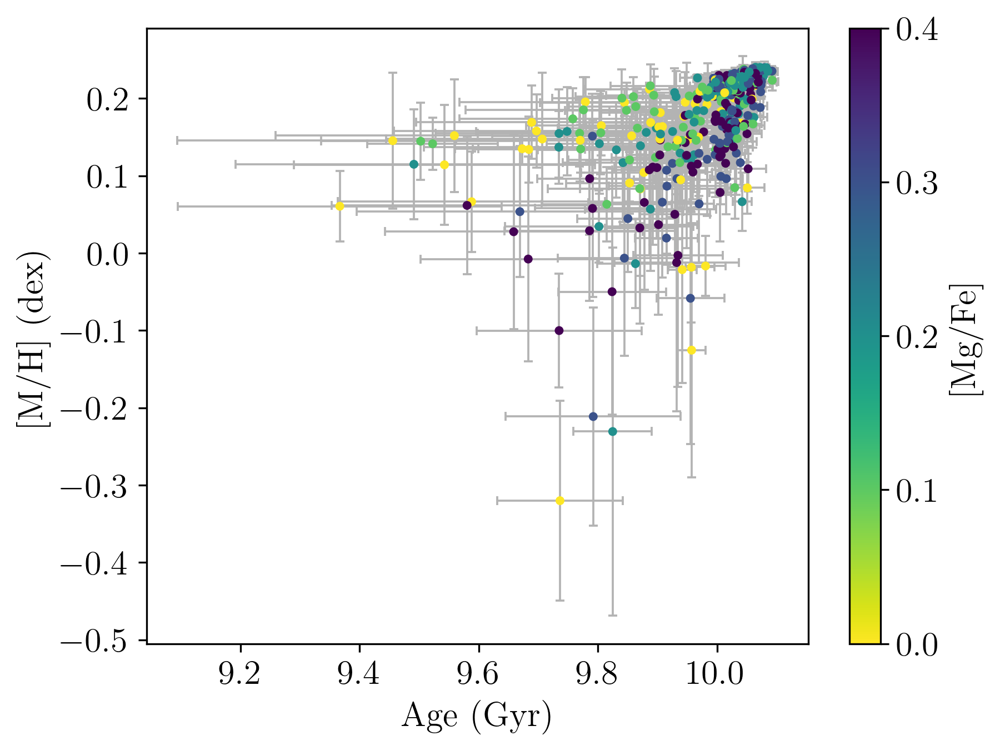

In [72]:
fig, ax = plt.subplots()

ax.errorbar(df['logAge_mean'],df['[M/H]_mean'], xerr=df['logAge_err'], yerr=df['[M/H]_err'], 
            fmt='none', c='0.7', zorder=0, capsize=2, elinewidth=0.9, capthick=0.9)
pc = ax.scatter(df['logAge_mean'], df['[M/H]_mean'],c=df['alpha'], s=8, cmap='viridis_r')

ax.set_xlabel('Age (Gyr)')
ax.set_ylabel('[M/H] (dex)')

fig.colorbar(pc, label='[Mg/Fe]', ticks=[0, 0.1, 0.2, 0.3, 0.4]);

In [73]:
kids = pd.read_csv('SDSS INSPIRE comparison/SDSS_INPSIRE_Reff_frac.csv')
kids.head()

,Reff_r_KIDS,objID,ra,dec,deVRad_r,expRad_r,fracDev_r,meanRad
0,0.276343,1.237660e+18,219.521844,-1.458282,0.495802,0.523188,0.949586,0.497148
1,0.320285,1.237650e+18,213.003803,-0.344065,0.645003,0.593394,1.000000,0.645003
2,0.328312,1.237670e+18,139.644701,1.379459,0.609860,0.541369,0.895892,0.602343
3,0.209234,1.237650e+18,212.833553,2.561847,0.420583,0.487332,0.916514,0.425787
4,0.314918,1.237650e+18,215.171564,-0.586433,0.489441,0.504336,0.972620,0.489843


In [74]:
kids['meanRad'] = (kids.deVRad_r)**(kids.fracDev_r) * (kids.expRad_r)**(1-kids.fracDev_r)
kids.head()

kids.to_csv('SDSS INSPIRE comparison/SDSS_INPSIRE_Reff_frac.csv', index=False)

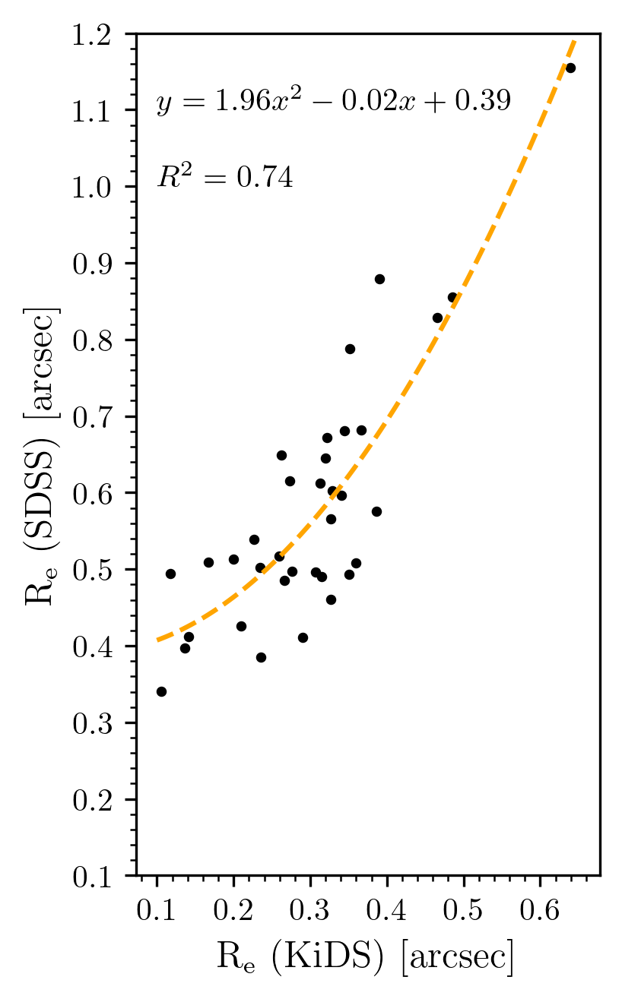

In [75]:
fig, ax = plt.subplots()
ax.scatter(kids.Reff_r_KIDS, kids.meanRad, s=5, c='k')
ax.set_xlabel(r'$\mathrm{R_e}$ (KiDS) [arcsec]', fontsize=12)
ax.set_ylabel(r'$\mathrm{R_e}$ (SDSS) [arcsec]', fontsize=12)
ax.set_xticks([0.1, 0.2, 0.3, 0.4, 0.5, 0.6])
ax.set_ylim(bottom=0.1)
ax.set_yticks([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 1.1, 1.2])
ax.minorticks_on()
ax.tick_params(axis='both',which='major',labelsize=10)
ax.set_aspect('equal')

model = np.polyfit(kids.Reff_r_KIDS, kids.meanRad, 2)
predict = np.poly1d(model)
x_lin_reg = np.linspace(0.1, 0.65, 100)
y_lin_reg = predict(x_lin_reg)
ax.plot(x_lin_reg, y_lin_reg, c='orange', linestyle='--');

eqn = f'$y = {model[0]:.2f}x^2 {model[1]:.2f}x + {model[2]:.2f}$'
ax.text(0.1, 1.1, eqn, fontsize=10)

r2 = r2_score(kids.meanRad, predict(kids.Reff_r_KIDS))
ax.text(0.1, 1.0, f'$R^2 = {r2:.2f}$', fontsize=10)

fig.savefig('/Users/johnmills/Summer project/paper_plots/kids_compare.pdf', bbox_inches='tight', dpi=300)

To plot multiple SFHs, start by considering three highest/lowest ages and metallicities

In [76]:
df_sfh = pd.concat([df_age_high[:3], df_age_low[:3], df_metal_high[:3], df_metal_low[:3]], ignore_index=True)

df_sfh

,ra,dec,deVRad_r,deVRadErr_r,expRad_r,expRadErr_r,z,zErr,velDisp,velDispErr,...,delta_t_minus,delta_t,delta_t_mean,dor_mean,t_ass_err,dor_99,dor_95,dor_med,meanRad_kids,meanRadkpc_kids
0,244.128250,28.152810,0.622300,0.006744,0.897415,0.008065,0.050079,0.000012,220.9603,5.587851,...,0.40805,0.57855,0.408017,0.775359,0.292363,0.835313,0.852540,0.788209,0.464458,0.470207
1,209.675964,13.456365,0.739855,0.007357,0.940950,0.004846,0.039339,0.000012,233.4338,5.270434,...,0.44739,0.66789,0.360475,0.879449,0.068190,0.820471,0.827698,0.845081,0.484010,0.389896
2,117.657807,22.991132,1.269630,0.014622,1.311210,0.007979,0.045048,0.000011,211.9426,4.890600,...,0.39585,0.60976,0.411385,0.826017,0.230835,0.729884,0.829566,0.875822,0.634756,0.581539
3,171.678691,6.211421,0.783562,0.027968,0.618333,0.011722,0.270224,0.000028,212.4304,10.720700,...,NaN,7.91222,2.589250,0.200228,0.001375,0.121622,0.141366,0.136976,0.410956,1.755372
4,136.250234,36.951743,0.814563,0.028475,0.753049,0.011259,0.272328,0.000030,202.0538,11.580380,...,0.84093,5.75910,2.387520,0.109075,0.002864,0.064206,0.080995,0.108983,0.425889,1.829272
5,346.303511,-10.555402,0.845756,0.026206,0.762754,0.009530,0.174412,0.000023,203.7827,8.069855,...,0.49957,8.43402,5.877950,0.169817,0.015330,0.066452,0.076582,0.180732,0.440630,1.346933
6,245.089233,17.382735,0.745578,0.013620,0.796974,0.008706,0.113739,0.000015,258.8284,6.995058,...,0.43203,0.53131,0.375227,0.845809,0.246096,0.743668,0.862204,0.869781,0.417452,0.891006
7,257.734613,39.692008,0.856252,0.015911,0.912510,0.008230,0.062229,0.000014,284.2417,6.436977,...,0.59274,0.92105,0.660308,0.745657,0.267854,0.732956,0.755025,0.813818,0.471290,0.584382
8,322.509320,3.130333,0.941937,0.013141,1.128041,0.012624,0.087746,0.000013,273.1854,5.723052,...,0.27981,0.40338,0.292878,0.880022,0.277440,0.885913,0.916828,0.927603,0.563292,0.955802
9,186.924646,-3.082051,0.967353,0.023538,0.761743,0.009421,0.164476,0.000036,210.3312,12.852340,...,0.69735,0.89536,0.496192,0.587998,0.058118,0.533530,0.563691,0.557667,0.495649,1.444640


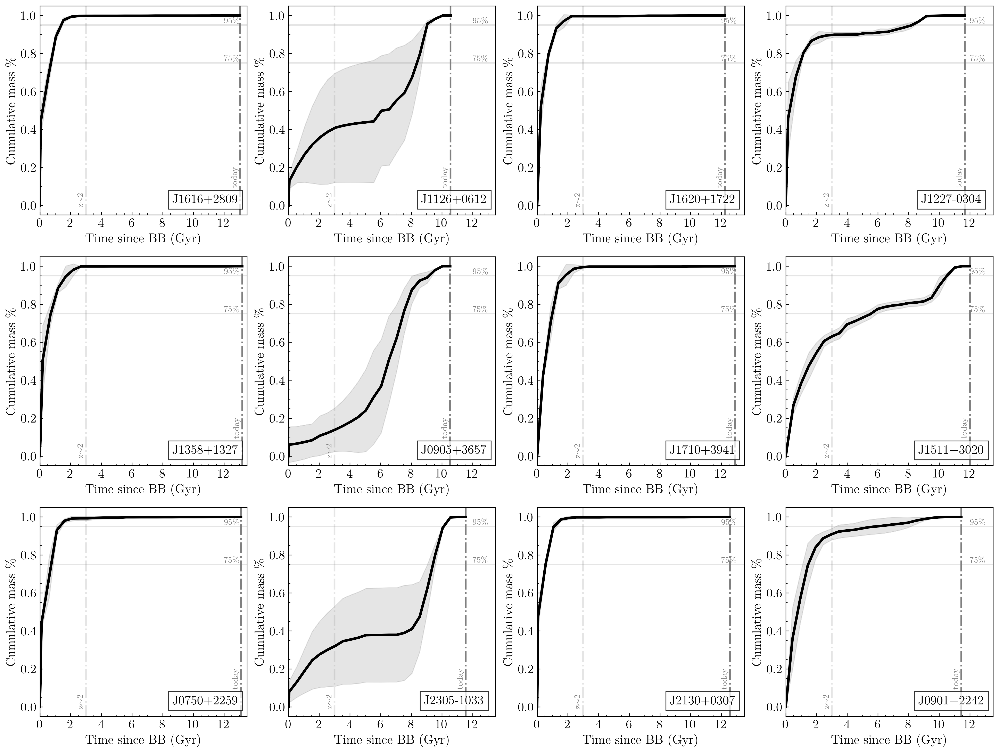

In [77]:
fig, axs = plt.subplots(3, 4, figsize=(20, 15))
props = dict(boxstyle='square', facecolor='white', alpha=0.8, edgecolor='black')

for index, row in df_sfh.iterrows():
    
    name = row['sexa_id']
    fitsfile1 = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_UNR.fits'
    fitsfile2 = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_REGUL.fits'
    fitsfilep = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_plus.fits'
    fitsfilem = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_minus.fits'

    name1,z1,agesplot1,weiplot1,univ_age1 = read_fits_summary(fitsfile1)
    name2,z2,agesplot2,weiplot2,univ_age2 = read_fits_summary(fitsfile2)

    masses = [weiplot1,weiplot2]

    if exists(fitsfilep):
        namep,zp,agesplotp,weiplotp,univ_agep = read_fits_summary(fitsfilep)
        masses.append(weiplotp)
            
    if exists(fitsfilem):
        namem,zm,agesplotm,weiplotm,univ_agem = read_fits_summary(fitsfilem)
        masses.append(weiplotm)

    mean_masses = np.mean(masses,axis=0)
    std_masses = np.std(masses,axis=0)

    name = row['sexa_id']
    z_orig = row['z']
    col_line = 'black'

    axs[index%3,index//3].set_xlim(0,13.5)
    axs[index%3,index//3].set_ylim(-0.05,1.05)
    axs[index%3,index//3].set_xlabel('Time since BB (Gyr)',fontsize=15)
    axs[index%3,index//3].set_ylabel(r'Cumulative mass \%',fontsize=15)
    axs[index%3,index//3].minorticks_on()
    axs[index%3,index//3].tick_params(axis='both',which='both',direction='in',labelsize=15)
    
    axs[index%3,index//3].axhline(0.75,color='gray',alpha=0.2)
    axs[index%3,index//3].text(12,0.76,r'75\%',style='italic',color='gray', fontsize=10)
    axs[index%3,index//3].axhline(0.95,color='gray',alpha=0.2)
    axs[index%3,index//3].text(12,0.96,r'95\%',style='italic',color='gray', fontsize=10)
    axs[index%3,index//3].axvline(3.,color='gray',alpha=0.2,linestyle='-.',linewidth=2.)
    axs[index%3,index//3].axvline(univ_age1,color='gray',linestyle='-.',linewidth=2.)

    axs[index%3,index//3].text(0.8, 0.1, name, transform=axs[index%3,index//3].transAxes, fontsize=15,
        verticalalignment='top', bbox=props, ha='center')

    # axs[index%3,index//3].plot(agesplot1,weiplot1,color='darkgreen',linestyle='-',linewidth=1.5)
    # axs[index%3,index//3].plot(agesplot2,weiplot2,color='lime',linestyle='-',linewidth=1.5)
    
    # if exists(fitsfilep):
    #     axs[index%3,index//3].plot(agesplotp,weiplotp,color='aqua',linestyle='-',linewidth=1.5)
    # if exists(fitsfilem):
    #     axs[index%3,index//3].plot(agesplotm,weiplotm,color='blue',linestyle='-',linewidth=1.5)
    
    axs[index%3,index//3].plot(agesplot1,mean_masses,color=col_line,linewidth=3.)
    axs[index%3,index//3].fill_between(agesplot1,mean_masses-std_masses,mean_masses+std_masses,color=col_line,alpha=0.1)
    
    axs[index%3,index//3].text(univ_age1-0.1,0.1,'today',color='gray',style='italic',rotation=90,horizontalalignment='right', fontsize=10)
    axs[index%3,index//3].text(2.9,0.,r'z$\sim$2',style='italic',color='gray',rotation=90,horizontalalignment='right', fontsize=10)
    axs[index%3,index//3].set_xticks([0.,2.,4.,6.,8.,10.,12.])

In [78]:
ids = ['J1510+0546', 'J1227-0304', 'J2352+0002', 'J0051+0427', 'J2223-0012', 'J1452+0253', 'J0003+1607', 'J1114+3031', 'J1600+0503']

df_sfh2 = pd.concat([df[df['sexa_id']==i] for i in ids], ignore_index=True)
df_sfh2['sexa_id']

0    J1510+0546
1    J1227-0304
2    J2352+0002
3    J0051+0427
4    J2223-0012
5    J1452+0253
6    J0003+1607
7    J1114+3031
8    J1600+0503
Name: sexa_id, dtype: object

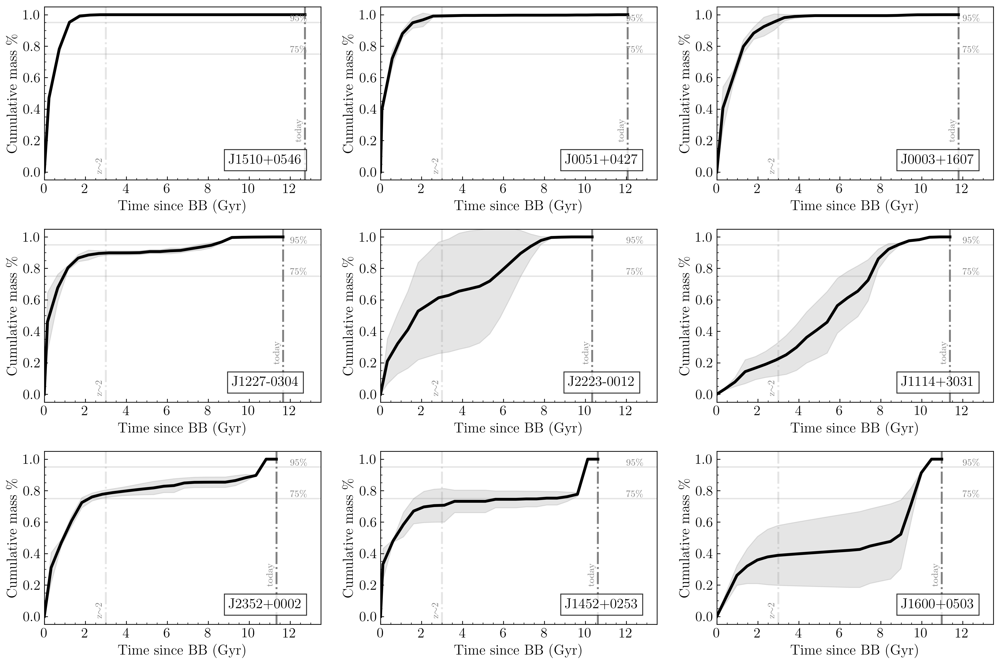

In [79]:
fig, axs = plt.subplots(3, 3, figsize=(15, 10))
props = dict(boxstyle='square', facecolor='white', alpha=0.8, edgecolor='black')

for index, row in df_sfh2.iterrows():
    
    name = row['sexa_id']
    fitsfile1 = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_UNR.fits'
    fitsfile2 = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_REGUL.fits'
    fitsfilep = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_plus.fits'
    fitsfilem = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_minus.fits'

    name1,z1,agesplot1,weiplot1,univ_age1 = read_fits_summary(fitsfile1)
    name2,z2,agesplot2,weiplot2,univ_age2 = read_fits_summary(fitsfile2)

    masses = [weiplot1,weiplot2]

    if exists(fitsfilep):
        namep,zp,agesplotp,weiplotp,univ_agep = read_fits_summary(fitsfilep)
        masses.append(weiplotp)
            
    if exists(fitsfilem):
        namem,zm,agesplotm,weiplotm,univ_agem = read_fits_summary(fitsfilem)
        masses.append(weiplotm)

    mean_masses = np.mean(masses,axis=0)
    std_masses = np.std(masses,axis=0)

    name = row['sexa_id']
    z_orig = row['z']
    col_line = 'black'

    axs[index%3,index//3].set_xlim(0,13.5)
    axs[index%3,index//3].set_ylim(-0.05,1.05)
    axs[index%3,index//3].set_xlabel('Time since BB (Gyr)',fontsize=15)
    axs[index%3,index//3].set_ylabel(r'Cumulative mass \%',fontsize=15)
    axs[index%3,index//3].minorticks_on()
    axs[index%3,index//3].tick_params(axis='both',which='both',direction='in',labelsize=15)
    
    axs[index%3,index//3].axhline(0.75,color='gray',alpha=0.2)
    axs[index%3,index//3].text(12,0.76,r'75\%',style='italic',color='gray', fontsize=10)
    axs[index%3,index//3].axhline(0.95,color='gray',alpha=0.2)
    axs[index%3,index//3].text(12,0.96,r'95\%',style='italic',color='gray', fontsize=10)
    axs[index%3,index//3].axvline(3.,color='gray',alpha=0.2,linestyle='-.',linewidth=2.)
    axs[index%3,index//3].axvline(univ_age1,color='gray',linestyle='-.',linewidth=2.)

    axs[index%3,index//3].text(0.8, 0.15, name, transform=axs[index%3,index//3].transAxes, fontsize=15,
        verticalalignment='top', bbox=props, ha='center')

    # axs[index%3,index//3].plot(agesplot1,weiplot1,color='darkgreen',linestyle='-',linewidth=1.5)
    # axs[index%3,index//3].plot(agesplot2,weiplot2,color='lime',linestyle='-',linewidth=1.5)
    
    # if exists(fitsfilep):
    #     axs[index%3,index//3].plot(agesplotp,weiplotp,color='aqua',linestyle='-',linewidth=1.5)
    # if exists(fitsfilem):
    #     axs[index%3,index//3].plot(agesplotm,weiplotm,color='blue',linestyle='-',linewidth=1.5)
    
    axs[index%3,index//3].plot(agesplot1,mean_masses,color=col_line,linewidth=3.)
    axs[index%3,index//3].fill_between(agesplot1,mean_masses-std_masses,mean_masses+std_masses,color=col_line,alpha=0.1)
    
    axs[index%3,index//3].text(univ_age1-0.1,0.2,'today',color='gray',style='italic',rotation=90,horizontalalignment='right', fontsize=10)
    axs[index%3,index//3].text(2.9,0.,r'z$\sim$2',style='italic',color='gray',rotation=90,horizontalalignment='right', fontsize=10)
    axs[index%3,index//3].set_xticks([0.,2.,4.,6.,8.,10.,12.])

plt.tight_layout()
fig.savefig('/Users/johnmills/Summer project/paper_plots/sfh_compare.pdf', bbox_inches='tight', dpi=300)

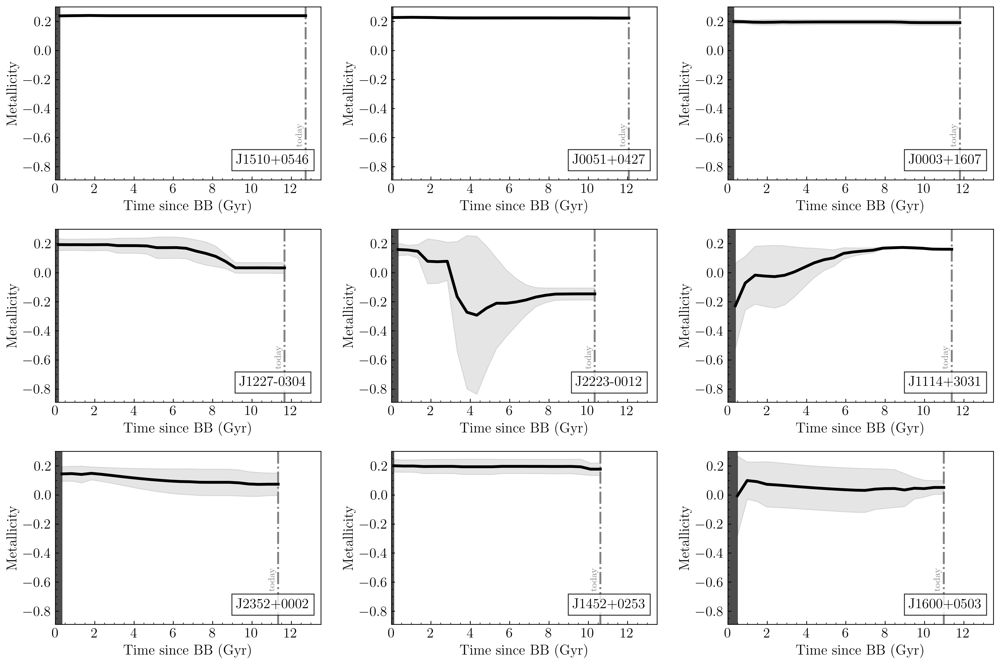

In [80]:
fig, axs = plt.subplots(3, 3, figsize=(15, 10))
props = dict(boxstyle='square', facecolor='white', alpha=0.8, edgecolor='black')
ymins = []
univ_ages = []

for index, row in df_sfh2.iterrows():
    
    name = row['sexa_id']
    fitsfile1 = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_UNR.fits'
    fitsfile2 = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_REGUL.fits'
    fitsfilep = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_plus.fits'
    fitsfilem = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_minus.fits'

    name1,z1,agesplot1,weiplot1,univ_age1 = read_fits_summary_metal(fitsfile1)
    name2,z2,agesplot2,weiplot2,univ_age2 = read_fits_summary_metal(fitsfile2)

    masses = [weiplot1,weiplot2]

    if exists(fitsfilep):
        namep,zp,agesplotp,weiplotp,univ_agep = read_fits_summary_metal(fitsfilep)
        masses.append(weiplotp)
            
    if exists(fitsfilem):
        namem,zm,agesplotm,weiplotm,univ_agem = read_fits_summary_metal(fitsfilem)
        masses.append(weiplotm)

    mean_masses = np.nanmean(masses,axis=0)
    std_masses = np.nanstd(masses,axis=0)

    name = row['sexa_id']
    z_orig = row['z']
    col_line = 'black'

    # ax.set_title(name,fontsize=18,weight='bold')
    axs[index%3,index//3].set_xlim(0,13.5)
    axs[index%3,index//3].set_xlabel('Time since BB (Gyr)',fontsize=15)
    axs[index%3,index//3].set_ylabel('Metallicity',fontsize=15)
    axs[index%3,index//3].minorticks_on()
    axs[index%3,index//3].tick_params(axis='both',which='both',direction='in',labelsize=15)

    axs[index%3,index//3].text(0.82, 0.15, name, transform=axs[index%3,index//3].transAxes, fontsize=15,
    verticalalignment='top', bbox=props, ha='center')

    axs[index%3,index//3].axvline(univ_age1,color='gray',linestyle='-.',linewidth=2.)
    axs[index%3,index//3].axvspan(0.,agesplot1.min(),color='0.3')

    axs[index%3,index//3].plot(agesplot1,mean_masses,color=col_line,linewidth=3.)
    axs[index%3,index//3].fill_between(agesplot1,mean_masses-std_masses,mean_masses+std_masses,color=col_line,alpha=0.1)
    
    axs[index%3,index//3].set_xticks([0.,2.,4.,6.,8.,10.,12.])

    ymin, ymax = axs[index%3,index//3].get_ylim()
    ymins.append(ymin)
    univ_ages.append(univ_age1)

ymin = min(ymins)

for i in range(9):
    axs[i%3,i//3].set_ylim(ymin, 0.3)
    axs[i%3,i//3].text(univ_ages[i]-0.1,ymin+0.2*(0.3-ymin),'today',color='gray',style='italic',rotation=90,horizontalalignment='right', fontsize=10)

plt.tight_layout()

fig.savefig('/Users/johnmills/Summer project/paper_plots/metal_compare.pdf', bbox_inches='tight', dpi=300)

In [81]:
times_25_unr = []
times_25_reg = []
times_25_plus = []
times_25_minus = []

times_25 = []
times_25_mean = []

In [82]:
for index, row in df.iterrows():

    name = row['sexa_id']
    fitsfilea = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_UNR.fits'
    fitsfileb = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_REGUL.fits'
    fitsfilep = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_plus.fits'
    fitsfilem = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_minus.fits'

    # Deal with original alpha/Fe fits first
    namea,za,agesplota,weiplota,univ_agea = read_fits_summary2(fitsfilea)
    nameb,zb,agesplotb,weiplotb,univ_ageb = read_fits_summary2(fitsfileb)

    df_out = pd.DataFrame({'time':agesplota, 'regul0':weiplota, 'regul1':weiplotb})

    y_z2a,x_025a,x_075a,x_090a,x_100a,dor_90a,dor_100a = get_values_from_sfh(univ_agea,df_out,'regul0')
    y_z2b,x_025b,x_075b,x_090b,x_100b,dor_90b,dor_100b = get_values_from_sfh(univ_ageb,df_out,'regul1')

    times_25_unr.append(x_025a)
    times_25_reg.append(x_025b)

    x_025s = [x_025a,x_025b]
    
    # Deal with plus/minus alpha/Fe fits next
    if exists(fitsfilep):

        namep,zp,agesplotp,weiplotp,univ_agep = read_fits_summary2(fitsfilep)
        df_outp = pd.DataFrame({'time':agesplotp, 'regul0':weiplotp})
        y_z2p,x_025p,x_075p,x_090p,x_100p,dor_90p,dor_100p = get_values_from_sfh(univ_agep,df_outp,"regul0")

        times_25_plus.append(x_025p)

        x_025s.append(x_025p)
    
    else:
        times_25_plus.append(np.nan)

    if exists(fitsfilem):

        namem,zm,agesplotm,weiplotm,univ_agem = read_fits_summary2(fitsfilem)
        df_outm = pd.DataFrame({'time':agesplotm, 'regul0':weiplotm})
        y_z2m,x_025m,x_075m,x_090m,x_100m,dor_90m,dor_100m = get_values_from_sfh(univ_agem,df_outm,"regul0")

        times_25_minus.append(x_025m)

        x_025s.append(x_025m)

    else:
        times_25_minus.append(np.nan)

    times_25.append(np.min(x_025s))
    times_25_mean.append(np.nanmean(x_025s))

In [83]:
df['delta_t_unr'] = df['time_75_unr'] - times_25_unr
df['delta_t_reg'] = df['time_75_reg'] - times_25_reg
df['delta_t_plus'] = df['time_75_plus'] - times_25_plus
df['delta_t_minus'] = df['time_75_min'] - times_25_minus

In [84]:
times_75_mean = np.nanmean([df['time_75_unr'], df['time_75_reg'], df['time_75_plus'], df['time_75_min']], axis=0)
delta_t = df['time_75'] - np.array(times_25)

df['delta_t'] = delta_t
df['delta_t_mean'] = times_75_mean - times_25_mean

masses_frac_mean = np.nanmean([df['mass_frac_unr'], df['mass_frac_reg'], df['mass_frac_plus'], df['mass_frac_min']], axis=0)
times_100_mean = np.nanmean([df['time_100_unr'], df['time_100_reg'], df['time_100_plus'], df['time_100_min']], axis=0)

dor_mean = (masses_frac_mean + 0.5/times_75_mean + (0.7 + (df['univ_age']-times_100_mean))/df['univ_age'])/3
df['dor_mean'] = dor_mean

Text(0.5, 0, '$\\Delta t_{75-25}$ (Gyr)')

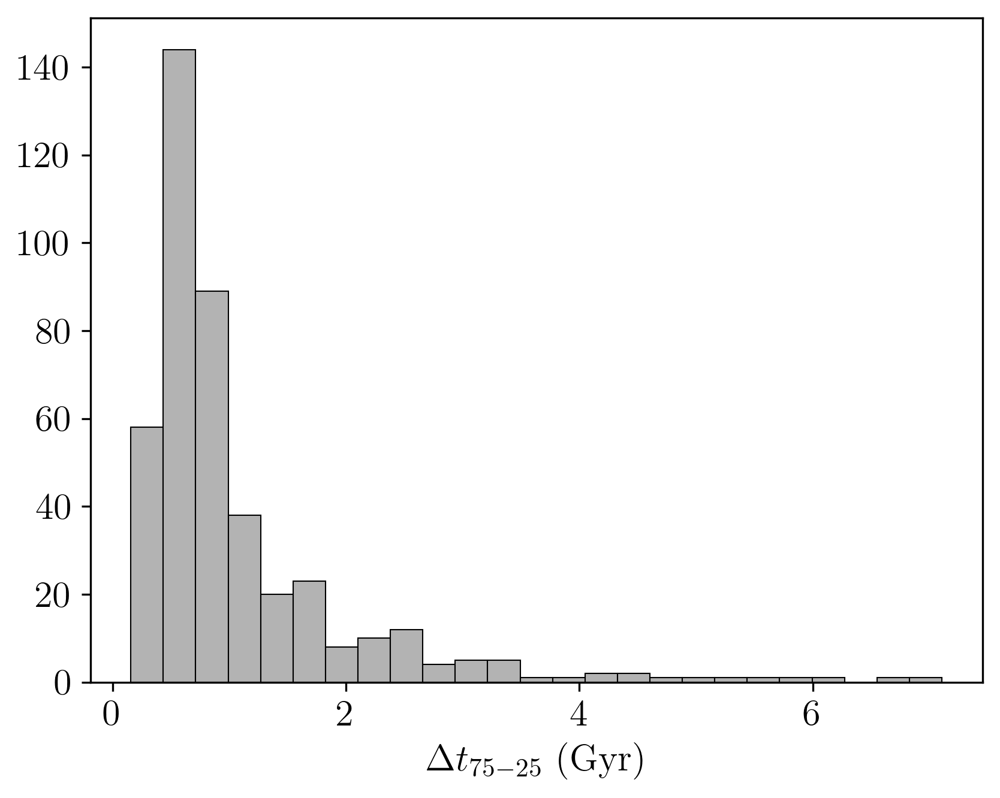

In [85]:
fig, ax = plt.subplots()

ax.hist(df['delta_t_mean'], bins=25, color='0.7', edgecolor='black', linewidth=0.5)
ax.set_xlabel(r'$\Delta t_{75-25}$ (Gyr)')

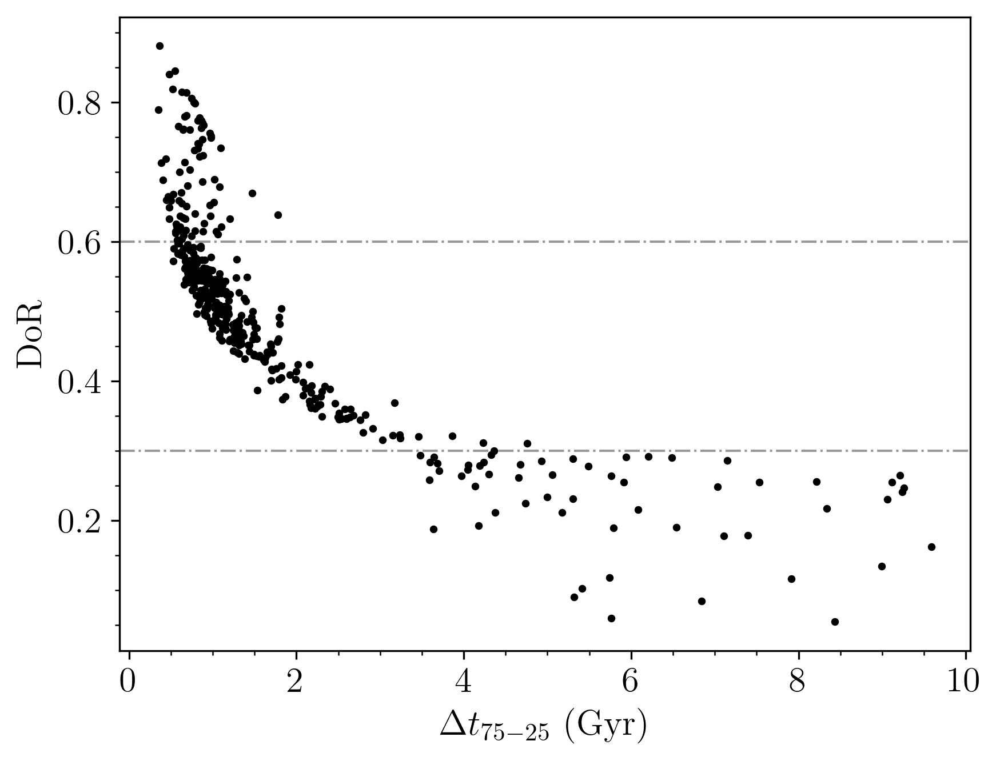

In [86]:
fig, ax = plt.subplots()

ax.axhline(0.6, color='0.6', linestyle='-.', linewidth=1, zorder=0)
ax.axhline(0.3, color='0.6', linestyle='-.', linewidth=1, zorder=0)
ax.scatter(df['delta_t'], df['dor'], s=5, c='k')
ax.set_xlabel(r'$\Delta t_{75-25}$ (Gyr)')
ax.set_ylabel(r'DoR')
ax.minorticks_on()

fig.savefig('/Users/johnmills/Summer project/paper_plots/dor_delta_t.pdf', bbox_inches='tight', dpi=300)

In [87]:
print(df['dor'].max())

0.8813557976078031


In [88]:
df_late = df[(df['delta_t']<10) & (df['dor']<0.15)]
df_late[['sexa_id', 'alpha', 'alpha_flag']]

,sexa_id,alpha,alpha_flag
398,J0905+3657,0.1,0
208,J1356+3030,0.3,0
39,J1600+0503,0.0,-1
378,J1126+0612,0.0,-1
427,J2223-0012,0.3,0
269,J1114+3031,0.0,0
399,J0815+0635,0.0,-1
238,J2305-1033,0.1,0


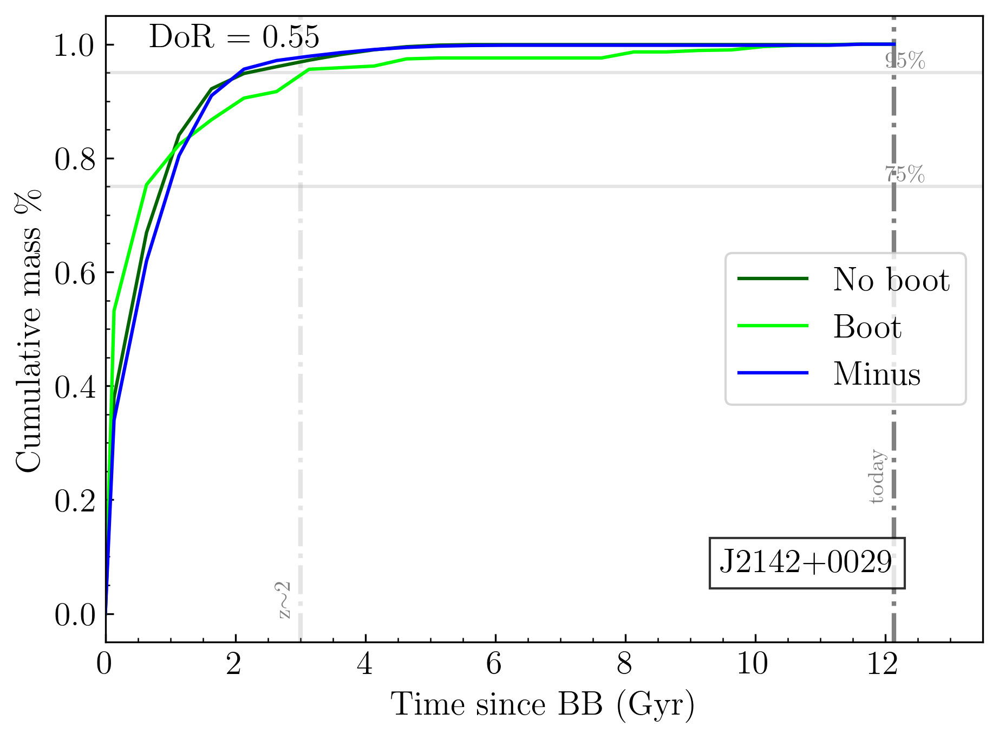

In [89]:
fig, ax = plt.subplots()
props = dict(boxstyle='square', facecolor='white', alpha=0.8, edgecolor='black')

row = df[df['sexa_id']=='J2142+0029'].iloc[0]

name = row['sexa_id']
fitsfile1 = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_UNR.fits'
fitsfile2 = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_REGUL.fits'
fitsfilep = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_plus.fits'
fitsfilem = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_minus.fits'

name1,z1,agesplot1,weiplot1,univ_age1 = read_fits_summary(fitsfile1)
name2,z2,agesplot2,weiplot2,univ_age2 = read_fits_summary(fitsfile2)

masses = [weiplot1,weiplot2]

if exists(fitsfilep):
    namep,zp,agesplotp,weiplotp,univ_agep = read_fits_summary(fitsfilep)
    masses.append(weiplotp)
        
if exists(fitsfilem):
    namem,zm,agesplotm,weiplotm,univ_agem = read_fits_summary(fitsfilem)
    masses.append(weiplotm)

mean_masses = np.mean(masses,axis=0)
std_masses = np.std(masses,axis=0)

name = row['sexa_id']
z_orig = row['z']
col_line = 'black'

ax.set_xlim(0,13.5)
ax.set_ylim(-0.05,1.05)
ax.set_xlabel('Time since BB (Gyr)',fontsize=15)
ax.set_ylabel(r'Cumulative mass \%',fontsize=15)
ax.minorticks_on()
ax.tick_params(axis='both',which='both',direction='in',labelsize=15)

ax.axhline(0.75,color='gray',alpha=0.2)
ax.text(12,0.76,r'75\%',style='italic',color='gray', fontsize=10)
ax.axhline(0.95,color='gray',alpha=0.2)
ax.text(12,0.96,r'95\%',style='italic',color='gray', fontsize=10)
ax.axvline(3.,color='gray',alpha=0.2,linestyle='-.',linewidth=2.)
ax.axvline(univ_age1,color='gray',linestyle='-.',linewidth=2.)

ax.text(0.8, 0.15, name, transform=ax.transAxes, fontsize=15,
    verticalalignment='top', bbox=props, ha='center')

ax.plot(agesplot1,weiplot1,color='darkgreen',linestyle='-',linewidth=1.5, label='No boot')
ax.plot(agesplot2,weiplot2,color='lime',linestyle='-',linewidth=1.5, label='Boot')

if exists(fitsfilep):
    ax.plot(agesplotp,weiplotp,color='aqua',linestyle='-',linewidth=1.5, label='Plus')
if exists(fitsfilem):
    ax.plot(agesplotm,weiplotm,color='blue',linestyle='-',linewidth=1.5, label='Minus')

# ax.plot(agesplot1,mean_masses,color=col_line,linewidth=3.)
# ax.fill_between(agesplot1,mean_masses-std_masses,mean_masses+std_masses,color=col_line,alpha=0.1)

ax.text(univ_age1-0.1,0.2,'today',color='gray',style='italic',rotation=90,horizontalalignment='right', fontsize=10)
ax.text(2.9,0.,r'z$\sim$2',style='italic',color='gray',rotation=90,horizontalalignment='right', fontsize=10)
ax.text(0.05, 0.95, f'DoR = {row["dor"]:.2f}', transform=ax.transAxes, fontsize=15,)
ax.set_xticks([0.,2.,4.,6.,8.,10.,12.])

ax.legend(loc='center right')

plt.tight_layout()

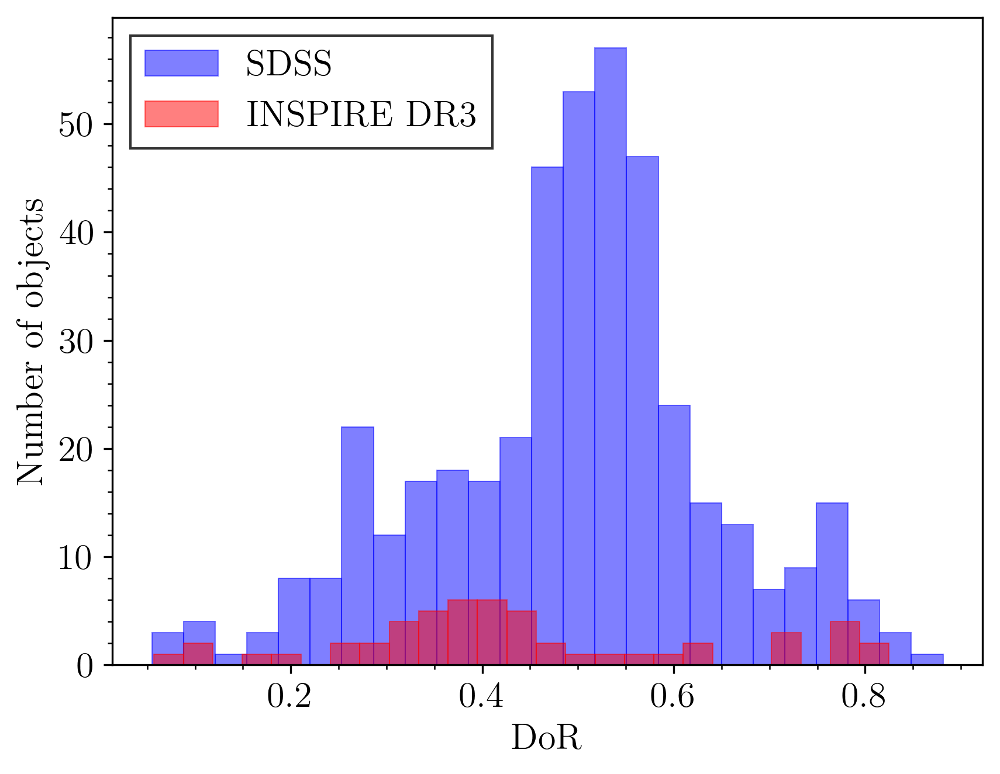

In [90]:
fig, ax = plt.subplots()

ax.hist(df['dor'], bins=25, color='b', edgecolor='b', linewidth=0.5, alpha=0.5, label='SDSS');
ax.set_xlabel('DoR')
ax.set_ylabel('Number of objects')
ax.minorticks_on()

ax.hist(df_inspire['DoR'], bins=25, color='r', edgecolor='r', linewidth=0.5, alpha=0.5, label='INSPIRE DR3');
ax.legend(fancybox=False, edgecolor='black')

fig.savefig('/Users/johnmills/Summer project/paper_plots/dor_hist.pdf', bbox_inches='tight', dpi=300)

In [91]:
print(df['dor'].max())

0.8813557976078031


Text(0.5, 0, 'Mean DoR')

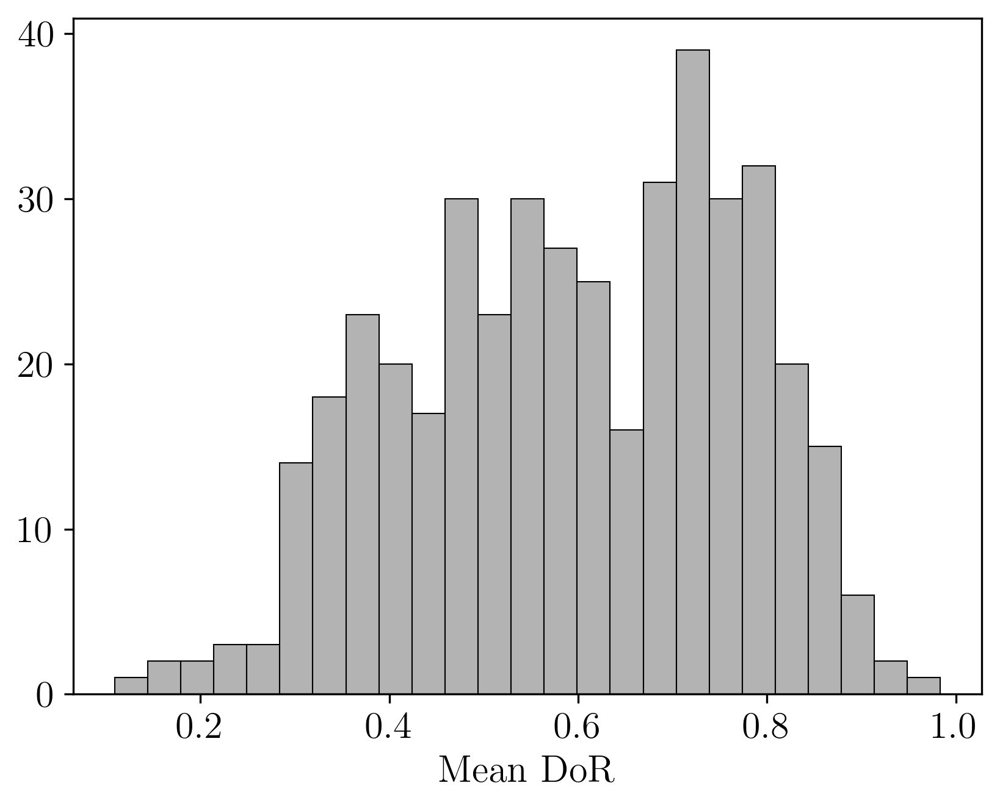

In [92]:
fig, ax = plt.subplots()

ax.hist(df['dor_mean'], bins=25, color='0.7', edgecolor='black', linewidth=0.5);
ax.set_xlabel('Mean DoR')

Text(0, 0.5, 'Mean DoR')

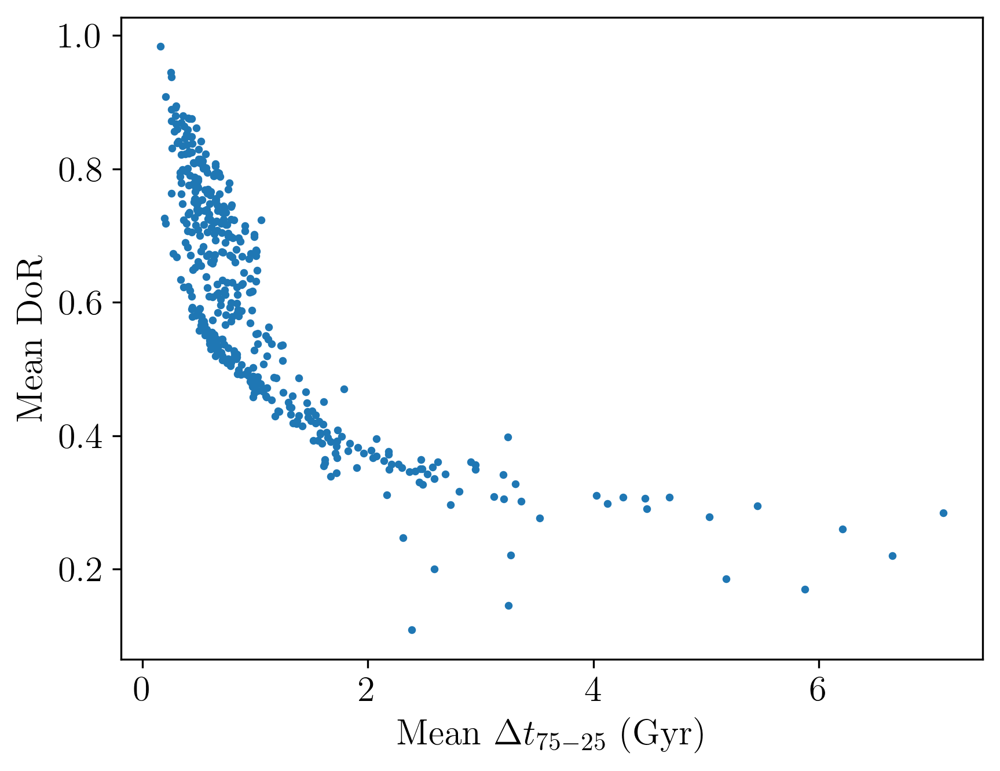

In [93]:
fig, ax = plt.subplots()

ax.scatter(df['delta_t_mean'], df['dor_mean'], s=5)
ax.set_xlabel(r'Mean $\Delta t_{75-25}$ (Gyr)')
ax.set_ylabel(r'Mean DoR')

In [94]:
ids = ['J1510+0546', 'J0815+0635', 'J0905+3657', 'J0003+1607', 'J1708+2723', 'J1600+0503']

df_sfh3 = pd.concat([df[df['sexa_id']==i] for i in ids], ignore_index=True)
df_sfh3[['sexa_id', 'dor']]

,sexa_id,dor
0,J1510+0546,0.840691
1,J0815+0635,0.102624
2,J0905+3657,0.059858
3,J0003+1607,0.504237
4,J1708+2723,0.162260
5,J1600+0503,0.134943


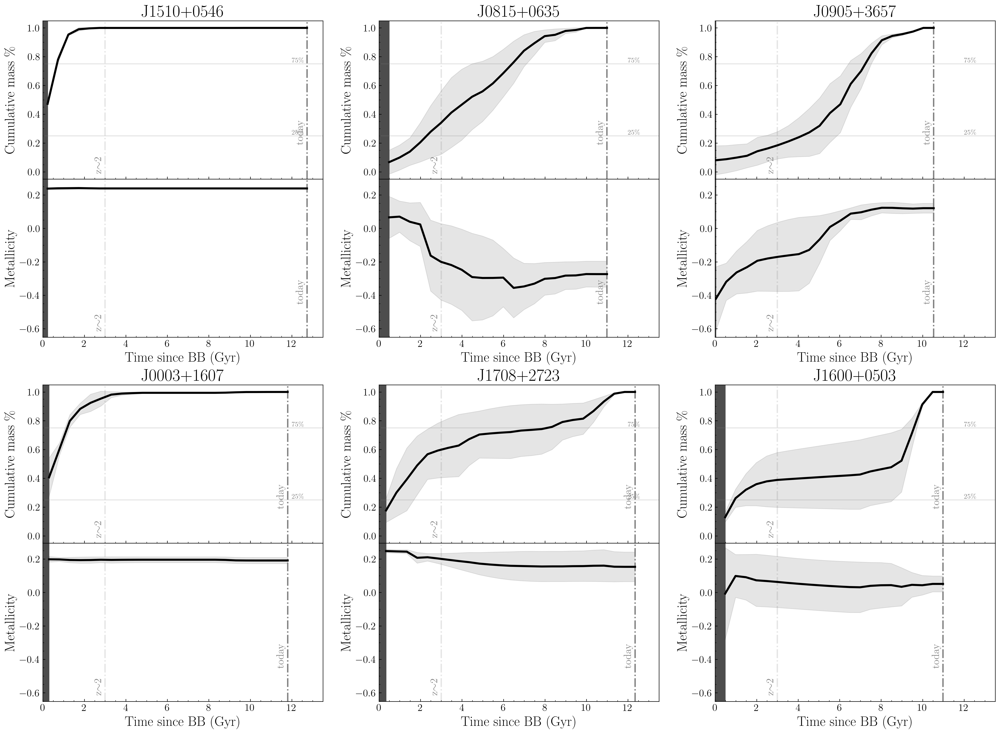

In [95]:
fig = plt.figure(figsize=(25, 18))
gs = gridspec.GridSpec(5, 3, height_ratios=[1, 1, 0.3, 1, 1], hspace=0)
axs = [plt.subplot(gs[i, j]) for i in range(5) for j in range(3)]
props = dict(boxstyle='square', facecolor='white', alpha=0.8, edgecolor='black')
ymins = []
ymaxs = []
univ_ages = []

for i in [6, 7, 8]:
    axs[i].set_visible(False)

for index, row in df_sfh3.iterrows():

    name = row['sexa_id']
    fitsfile1 = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_UNR.fits'
    fitsfile2 = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_REGUL.fits'
    fitsfilep = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_plus.fits'
    fitsfilem = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fit_test/'+name+'_ppxfout_minus.fits'

    name1,z1,agesplot1,weiplot1,univ_age1 = read_fits_summary(fitsfile1)
    name2,z2,agesplot2,weiplot2,univ_age2 = read_fits_summary(fitsfile2)

    masses = [weiplot1,weiplot2]

    if exists(fitsfilep):
        namep,zp,agesplotp,weiplotp,univ_agep = read_fits_summary(fitsfilep)
        masses.append(weiplotp)
            
    if exists(fitsfilem):
        namem,zm,agesplotm,weiplotm,univ_agem = read_fits_summary(fitsfilem)
        masses.append(weiplotm)

    mean_masses = np.mean(masses,axis=0)
    std_masses = np.std(masses,axis=0)

    name = row['sexa_id']
    z_orig = row['z']
    col_line = 'black'

    if index > 2:
        index += 6

    axs[index].set_xlim(0,13.5)
    axs[index].set_title(name,fontsize=25,weight='bold')
    axs[index].set_ylim(-0.05,1.05)
    axs[index].set_ylabel(r'Cumulative mass \%',fontsize=20)
    axs[index].minorticks_on()
    axs[index].tick_params(axis='both',which='both',direction='in',labelsize=15)
    
    axs[index].axhline(0.75,color='gray',alpha=0.2)
    axs[index].text(12,0.76,r'75\%',style='italic',color='gray', fontsize=10)
    axs[index].axhline(0.25,color='gray',alpha=0.2)
    axs[index].text(12,0.26,r'25\%',style='italic',color='gray', fontsize=10)
    axs[index].axvline(3.,color='gray',alpha=0.2,linestyle='-.',linewidth=2.)
    axs[index].axvline(univ_age1,color='gray',linestyle='-.',linewidth=2.)

    # axs[index].text(0.85, 0.15, name, transform=axs[index].transAxes, fontsize=20,
    #     verticalalignment='top', bbox=props, ha='center')
    
    axs[index].plot(agesplot1[1:],mean_masses[1:],color=col_line,linewidth=3.)
    axs[index].fill_between(agesplot1[1:],mean_masses[1:]-std_masses[1:],mean_masses[1:]+std_masses[1:],color=col_line,alpha=0.1)
    
    axs[index].text(univ_age1-0.1,0.2,'today',color='gray',style='italic',rotation=90,horizontalalignment='right', fontsize=15)
    axs[index].text(2.9,0.,r'z$\sim$2',style='italic',color='gray',rotation=90,horizontalalignment='right', fontsize=15)
    axs[index].set_xticks([0.,2.,4.,6.,8.,10.,12.])

    #############################################################################################

    name1,z1,agesplot1,weiplot1,univ_age1 = read_fits_summary_metal(fitsfile1)
    name2,z2,agesplot2,weiplot2,univ_age2 = read_fits_summary_metal(fitsfile2)

    masses = [weiplot1,weiplot2]

    if exists(fitsfilep):
        namep,zp,agesplotp,weiplotp,univ_agep = read_fits_summary_metal(fitsfilep)
        masses.append(weiplotp)
            
    if exists(fitsfilem):
        namem,zm,agesplotm,weiplotm,univ_agem = read_fits_summary_metal(fitsfilem)
        masses.append(weiplotm)

    mean_masses = np.nanmean(masses,axis=0)
    std_masses = np.nanstd(masses,axis=0)


    # ax.set_title(name,fontsize=18,weight='bold')
    axs[index+3].set_xlim(0,13.5)
    axs[index+3].set_xlabel('Time since BB (Gyr)',fontsize=20)
    axs[index+3].set_ylabel('Metallicity',fontsize=20)
    axs[index+3].minorticks_on()
    axs[index+3].tick_params(axis='both',which='both',direction='in',labelsize=15)

    axs[index+3].axvline(3.,color='gray',alpha=0.2,linestyle='-.',linewidth=2.)

    # axs[index+3].text(0.85, 0.15, name, transform=axs[index+3].transAxes, fontsize=20,
    # verticalalignment='top', bbox=props, ha='center')

    axs[index+3].axvline(univ_age1,color='gray',linestyle='-.',linewidth=2.)
    axs[index+3].axvspan(0.,agesplot1.min(),color='0.3')
    axs[index].axvspan(0.,agesplot1.min(),color='0.3')

    axs[index+3].plot(agesplot1,mean_masses,color=col_line,linewidth=3.)
    axs[index+3].fill_between(agesplot1,mean_masses-std_masses,mean_masses+std_masses,color=col_line,alpha=0.1)
    
    axs[index+3].set_xticks([0.,2.,4.,6.,8.,10.,12.])

    ymin, ymax = axs[index+3].get_ylim()
    ymins.append(ymin)
    ymaxs.append(ymax)
    univ_ages.append(univ_age1)

ymin = min(ymins)
ymax = max(ymaxs)
for i in range(6):
    univ_age = univ_ages[i]
    if i > 2:
        i += 6
    axs[i+3].set_ylim(ymin, ymax)
    axs[i+3].text(univ_age-0.1,ymin+0.22*(ymax-ymin),'today',color='gray',style='italic',rotation=90,horizontalalignment='right', fontsize=15)
    axs[i+3].text(2.9,ymin+0.05*(ymax-ymin),r'z$\sim$2',style='italic',color='gray',rotation=90,horizontalalignment='right', fontsize=15)

for i in [0, 1, 2, 9, 10, 11]:
    plt.setp(axs[i].get_xticklabels(), visible=False)

fig.align_ylabels([axs[0], axs[3], axs[9], axs[12]])
fig.align_ylabels([axs[1], axs[4], axs[10], axs[13]])
fig.align_ylabels([axs[2], axs[5], axs[11], axs[14]]) 

fig.savefig('/Users/johnmills/Summer project/paper_plots/sfh_metal_compare.pdf', bbox_inches='tight', dpi=300)

In [96]:
dor_alphas = []
dor_alphas_label = []

for alpha in alphas:
    df_alpha = df[df['alpha'] == alpha]
    dor_alphas.append(df_alpha['dor'].values)
    dor_alphas_label.append(alpha)

In [97]:
bins = [df['dor'].min(), 0.3, 0.6, df['dor'].max()]

df['dor_bin'] = pd.cut(df['dor'], bins=bins)
df_grouped = df.groupby('dor_bin', observed=True)[['dor', 'velDisp_ppxf', 'age_mean', '[M/H]_mean', 'logM', 'meanRadkpc_r', 'logsSFR']].agg(['mean', 'std'])
df_grouped

dor           velDisp_ppxf              age_mean  \
                   mean       std         mean        std       mean   
dor_bin                                                                
(0.0549, 0.3]  0.231679  0.061468   236.285071  45.092939   6.189802   
(0.3, 0.6]     0.485801  0.073222   252.225737  44.312160   9.996108   
(0.6, 0.881]   0.699263  0.072077   289.081681  55.651617  11.279085   

                        [M/H]_mean                 logM            \
                    std       mean       std       mean       std   
dor_bin                                                             
(0.0549, 0.3]  1.599016   0.103967  0.110940  11.180418  0.192379   
(0.3, 0.6]     1.286329   0.174009  0.057922  11.081143  0.235857   
(0.6, 0.881]   0.558325   0.228234  0.006765  11.002074  0.251795   

              meanRadkpc_r              logsSFR            
                      mean       std       mean       std  
dor_bin                                                    
(0.0549, 0.3]     2.507537  0.726705 -11.591436  0.812228  
(0.3, 0.6]        2.253550  0.822507 -12.179631  0.626647  
(0.6, 0.881]      1.943986  0.845371 -12.367210  0.527005

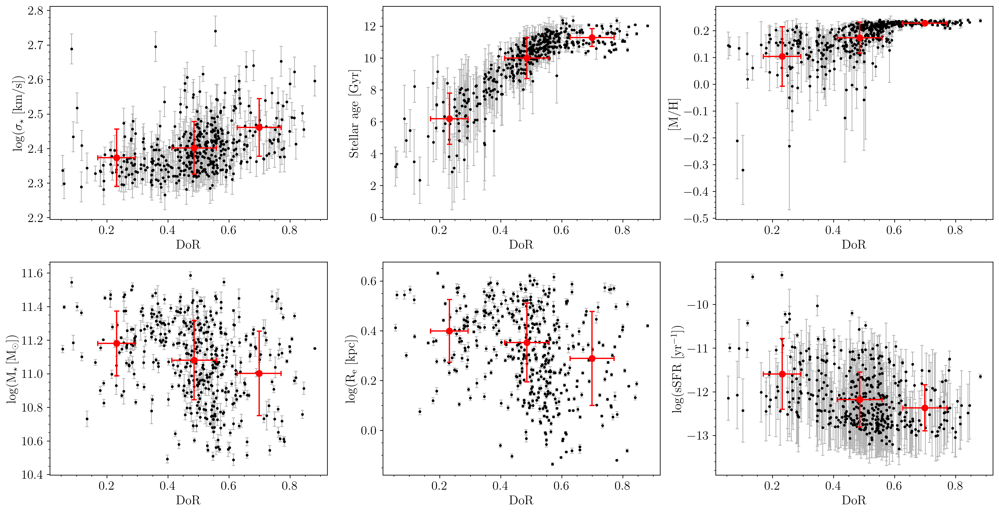

In [143]:
fig, axs = plt.subplots(2, 3, figsize=(20, 10))

axs[0, 0].errorbar(df['dor'], np.log10(df['velDisp_ppxf']), yerr=(df['velDisp_ppxf_err']/df['velDisp_ppxf'])/np.log(10), fmt='none', c='0.7', zorder=0, capsize=2, elinewidth=0.9, capthick=0.9)
axs[0, 0].scatter(df['dor'], np.log10(df['velDisp_ppxf']), s=5, c='k')
axs[0, 0].set_xlabel('DoR')
axs[0, 0].set_ylabel(r'$\log(\sigma_{\star}$ [km/s])')
axs[0, 0].minorticks_on()
axs[0, 0].set_xticks([0., 0.2, 0.4, 0.6, 0.8]);
axs[0, 0].errorbar(df_grouped['dor']['mean'],np.log10(df_grouped['velDisp_ppxf']['mean']), xerr=df_grouped['dor']['std'], yerr=(df_grouped['velDisp_ppxf']['std']/df_grouped['velDisp_ppxf']['mean'])/np.log(10), fmt='none', c='r', capsize=3, elinewidth=1.5, capthick=1.5)
axs[0, 0].scatter(df_grouped['dor']['mean'], np.log10(df_grouped['velDisp_ppxf']['mean']), c='r', s=50)

axs[0, 1].errorbar(df['dor'], df['age_mean'], yerr=df['age_err'], fmt='none', c='0.7', zorder=0, capsize=2, elinewidth=0.9, capthick=0.9)
axs[0, 1].scatter(df['dor'], df['age_mean'], s=5, c='k')
axs[0, 1].set_xlabel('DoR')
axs[0, 1].set_ylabel('Stellar age [Gyr]')
axs[0, 1].minorticks_on()
axs[0, 1].set_xticks([0., 0.2, 0.4, 0.6, 0.8]);
axs[0, 1].errorbar(df_grouped['dor']['mean'], df_grouped['age_mean']['mean'], xerr=df_grouped['dor']['std'], yerr=df_grouped['age_mean']['std'], fmt='none', c='r', capsize=3, elinewidth=1.5, capthick=1.5)
axs[0, 1].scatter(df_grouped['dor']['mean'], df_grouped['age_mean']['mean'], c='r', s=50)

axs[0, 2].errorbar(df['dor'], df['[M/H]_mean'], yerr=df['[M/H]_err'], fmt='none', c='0.7', zorder=0, capsize=2, elinewidth=0.9, capthick=0.9)
axs[0, 2].scatter(df['dor'], df['[M/H]_mean'], s=5, c='k')
axs[0, 2].set_xlabel('DoR')
axs[0, 2].set_ylabel('[M/H]')
axs[0, 2].minorticks_on()
axs[0, 2].set_xticks([0., 0.2, 0.4, 0.6, 0.8]);
axs[0, 2].errorbar(df_grouped['dor']['mean'], df_grouped['[M/H]_mean']['mean'], xerr=df_grouped['dor']['std'], yerr=df_grouped['[M/H]_mean']['std'], fmt='none', c='r', capsize=3, elinewidth=1.5, capthick=1.5)
axs[0, 2].scatter(df_grouped['dor']['mean'], df_grouped['[M/H]_mean']['mean'], c='r', s=50)

axs[1, 0].errorbar(df['dor'], df['logM'], yerr=df['errlogM'], fmt='none', c='0.7', zorder=0, capsize=2, elinewidth=0.9, capthick=0.9)
axs[1, 0].scatter(df['dor'], df['logM'], s=5, c='k')
axs[1, 0].set_xlabel('DoR')
axs[1, 0].set_ylabel(r'$\log(\rm M_{\star}\,[\rm M_{\odot}])$')
axs[1, 0].minorticks_on()
axs[1, 0].set_xticks([0., 0.2, 0.4, 0.6, 0.8]);
axs[1, 0].errorbar(df_grouped['dor']['mean'], df_grouped['logM']['mean'], xerr=df_grouped['dor']['std'], yerr=df_grouped['logM']['std'], fmt='none', c='r', capsize=3, elinewidth=1.5, capthick=1.5)
axs[1, 0].scatter(df_grouped['dor']['mean'], df_grouped['logM']['mean'], c='r', s=50)

axs[1, 1].errorbar(df['dor'], np.log10(df['meanRadkpc_r']), yerr=(df['meanRadErrkpc_r']/df['meanRadkpc_r'])/np.log(10), fmt='none', c='0.7', zorder=0, capsize=2, elinewidth=0.9, capthick=0.9)
axs[1, 1].scatter(df['dor'], np.log10(df['meanRadkpc_r']), s=5, c='k')
axs[1, 1].set_xlabel('DoR')
axs[1, 1].set_ylabel(r'$\log(\rm R_e$ [kpc])')
axs[1, 1].minorticks_on()
axs[1, 1].set_xticks([0., 0.2, 0.4, 0.6, 0.8]);
axs[1, 1].errorbar(df_grouped['dor']['mean'], np.log10(df_grouped['meanRadkpc_r']['mean']), xerr=df_grouped['dor']['std'], yerr=(df_grouped['meanRadkpc_r']['std']/df_grouped['meanRadkpc_r']['mean'])/np.log(10), fmt='none', c='r', capsize=3, elinewidth=1.5, capthick=1.5)
axs[1, 1].scatter(df_grouped['dor']['mean'], np.log10(df_grouped['meanRadkpc_r']['mean']), c='r', s=50)

axs[1, 2].errorbar(df['dor'], df['logsSFR'], yerr=df['errlogsSFR'], fmt='none', c='0.7', zorder=0, capsize=2, elinewidth=0.9, capthick=0.9)
axs[1, 2].scatter(df['dor'], df['logsSFR'], s=5, c='k')
axs[1, 2].set_xlabel('DoR')
axs[1, 2].set_ylabel(r'$\log(\rm sSFR~[yr^{-1}])$')
axs[1, 2].minorticks_on()
axs[1, 2].set_xticks([0., 0.2, 0.4, 0.6, 0.8]);
axs[1, 2].errorbar(df_grouped['dor']['mean'], df_grouped['logsSFR']['mean'], xerr=df_grouped['dor']['std'], yerr=df_grouped['logsSFR']['std'], fmt='none', c='r', capsize=3, elinewidth=1.5, capthick=1.5)
axs[1, 2].scatter(df_grouped['dor']['mean'], df_grouped['logsSFR']['mean'], c='r', s=50)

fig.savefig('/Users/johnmills/Summer project/paper_plots/dor_correlations.pdf', bbox_inches='tight', dpi=300)

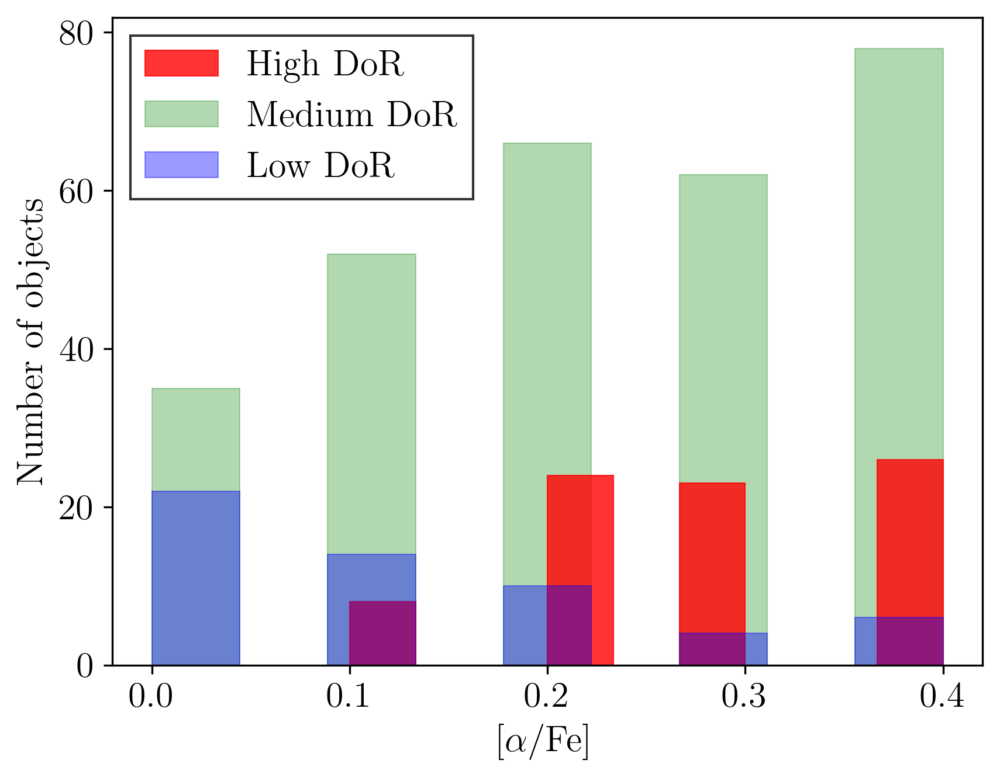

In [99]:
df_low = df[df['dor'] <= 0.3]
df_med = df[(df['dor'] > 0.3) & (df['dor'] <= 0.6)]
df_high = df[df['dor'] > 0.6]



fig, ax = plt.subplots()
ax.hist(df_high['alpha'], bins=9, color='r', edgecolor='r', alpha=0.8, linewidth=0.5, label='High DoR');
ax.hist(df_med['alpha'], bins=9, color='g', edgecolor='g', alpha=0.3, linewidth=0.5, label='Medium DoR', zorder=0);
ax.hist(df_low['alpha'], bins=9, color='b', edgecolor='b', alpha=0.4, linewidth=0.5, label='Low DoR');
ax.set_xlabel(r'[$\alpha$/Fe]')
ax.set_ylabel('Number of objects')
ax.legend(fancybox=False, edgecolor='black')

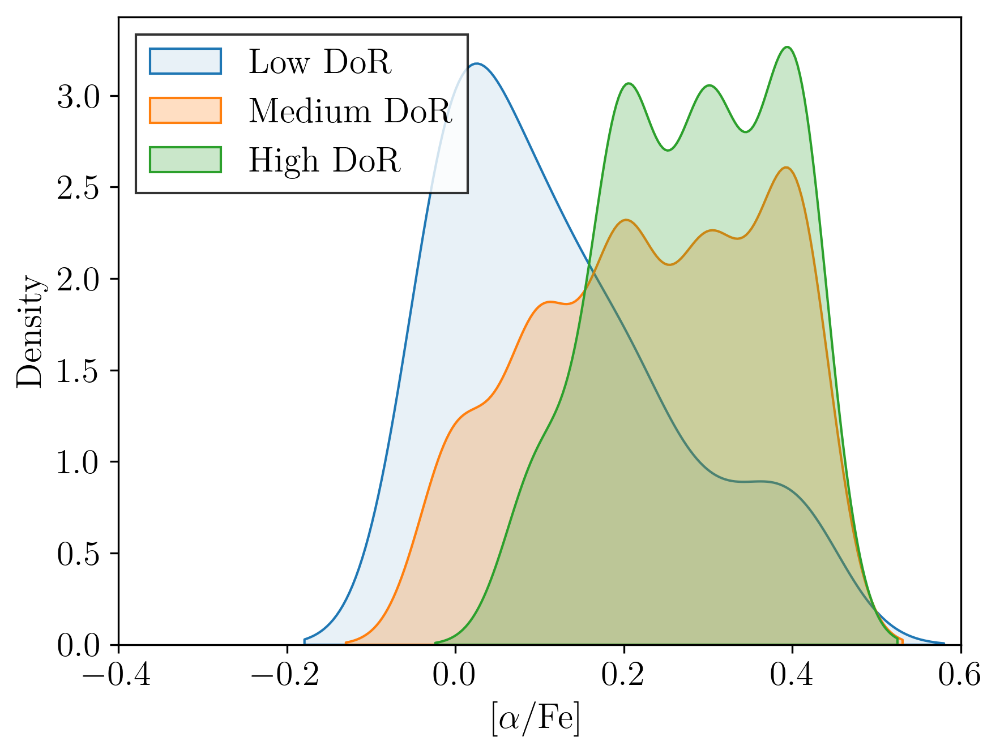

In [100]:
# Plot KDE for 'dor_95'
sns.kdeplot(df_low['alpha'], label='Low DoR', fill=True, alpha=0.1)

# Plot KDE for 'dor_99'
sns.kdeplot(df_med['alpha'], label='Medium DoR', fill=True)

# Plot KDE for 'dor'
sns.kdeplot(df_high['alpha'], label='High DoR', fill=True)

plt.xlabel(r'[$\alpha$/Fe]')
plt.ylabel('Density')
plt.xlim([-0.4, 0.6])
plt.legend(loc='upper left', fancybox=False, edgecolor='black')

plt.savefig('/Users/johnmills/Summer project/paper_plots/alpha_hist.pdf', bbox_inches='tight', dpi=300)

plt.show()

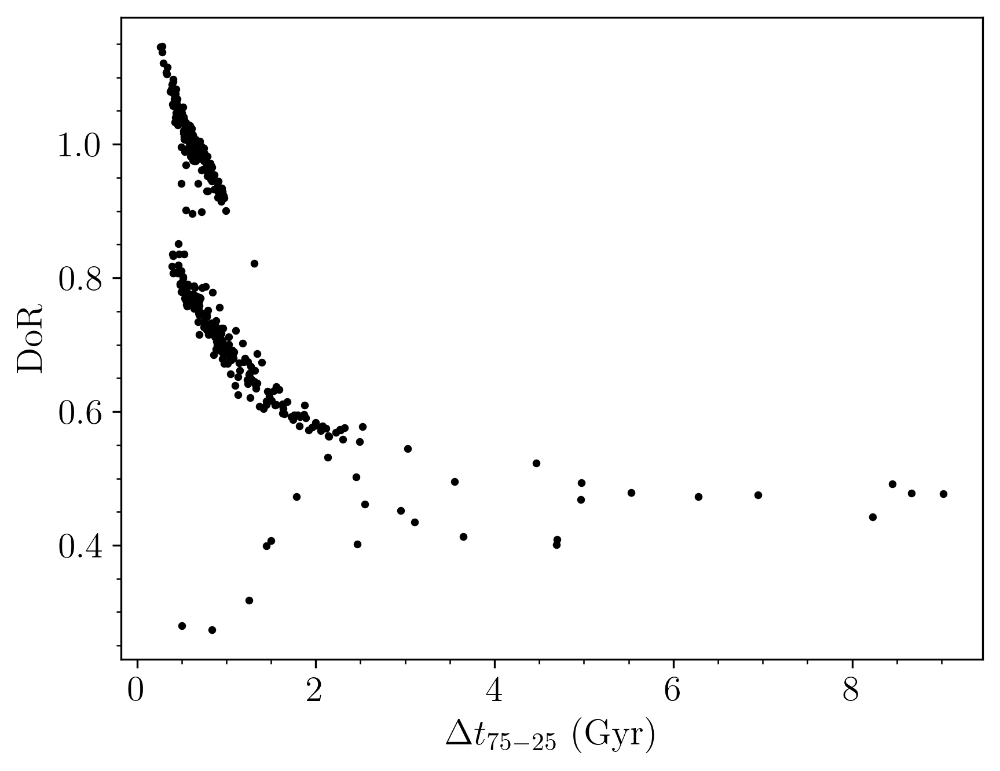

In [101]:
df_lb = df[(df['dor']<0.34) & (df['delta_t']<1.5)]

fig, ax = plt.subplots()

ax.scatter(df['delta_t_minus'], df['dor_100_min'], s=5, c='k')
#ax.scatter(df_lb['delta_t'], df_lb['dor'], s=5, c='r')
ax.set_xlabel(r'$\Delta t_{75-25}$ (Gyr)')
ax.set_ylabel(r'DoR')
ax.minorticks_on()

In [102]:
df_lb['sexa_id']

Series([], Name: sexa_id, dtype: object)

In [103]:
ids = ['J0750+5139', 'J1512+0758', 'J0943+0553']
df_manga = pd.concat([df[df['sexa_id']==i] for i in ids], ignore_index=True)
df_manga

,ra,dec,deVRad_r,deVRadErr_r,expRad_r,expRadErr_r,z,zErr,velDisp,velDispErr,...,delta_t,delta_t_mean,dor_mean,t_ass_err,dor_99,dor_95,dor_med,meanRad_kids,meanRadkpc_kids,dor_bin
0,117.511102,51.659827,0.646907,0.018954,0.735849,0.008335,0.101380,0.000021,228.8326,8.202271,...,1.16365,0.961080,0.673195,0.244576,0.721761,0.736831,0.712413,0.387383,0.747542,"(0.3, 0.6]"
1,228.117221,7.973903,0.664116,0.017619,0.732552,0.007047,0.079896,0.000017,238.4925,7.809804,...,0.78329,0.368125,0.863830,0.082975,0.739369,0.806569,0.866120,0.385726,0.601443,"(0.6, 0.881]"
2,145.831359,5.895521,0.582198,0.014151,0.731550,0.016885,0.091541,0.000019,239.3310,8.388958,...,0.61654,0.196633,0.725662,0.009353,0.796298,0.837177,0.637619,0.385222,0.678918,"(0.3, 0.6]"


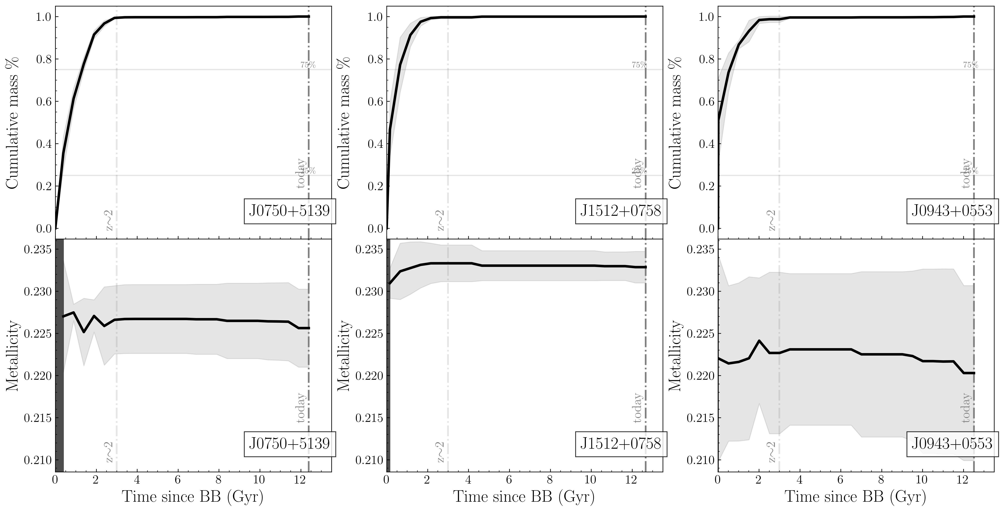

In [104]:
fig = plt.figure(figsize=(20, 10))
gs = gridspec.GridSpec(2, 3, height_ratios=[1, 1], hspace=0)
axs = [plt.subplot(gs[i, j]) for i in range(2) for j in range(3)]
props = dict(boxstyle='square', facecolor='white', alpha=0.8, edgecolor='black')
ymins = []
ymaxs = []
univ_ages = []

for index, row in df_manga.iterrows():

    name = row['sexa_id']
    fitsfile1 = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_UNR.fits'
    fitsfile2 = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_REGUL.fits'
    fitsfilep = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_plus.fits'
    fitsfilem = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test/'+name+'_ppxfout_minus.fits'

    name1,z1,agesplot1,weiplot1,univ_age1 = read_fits_summary(fitsfile1)
    name2,z2,agesplot2,weiplot2,univ_age2 = read_fits_summary(fitsfile2)

    masses = [weiplot1,weiplot2]

    if exists(fitsfilep):
        namep,zp,agesplotp,weiplotp,univ_agep = read_fits_summary(fitsfilep)
        masses.append(weiplotp)
            
    if exists(fitsfilem):
        namem,zm,agesplotm,weiplotm,univ_agem = read_fits_summary(fitsfilem)
        masses.append(weiplotm)

    mean_masses = np.mean(masses,axis=0)
    std_masses = np.std(masses,axis=0)

    name = row['sexa_id']
    z_orig = row['z']
    col_line = 'black'

    if index > 2:
        index += 6

    axs[index].set_xlim(0,13.5)
    axs[index].set_ylim(-0.05,1.05)
    axs[index].set_ylabel(r'Cumulative mass \%',fontsize=20)
    axs[index].minorticks_on()
    axs[index].tick_params(axis='both',which='both',direction='in',labelsize=15)
    
    axs[index].axhline(0.75,color='gray',alpha=0.2)
    axs[index].text(12,0.76,r'75\%',style='italic',color='gray', fontsize=10)
    axs[index].axhline(0.25,color='gray',alpha=0.2)
    axs[index].text(12,0.26,r'25\%',style='italic',color='gray', fontsize=10)
    axs[index].axvline(3.,color='gray',alpha=0.2,linestyle='-.',linewidth=2.)
    axs[index].axvline(univ_age1,color='gray',linestyle='-.',linewidth=2.)

    axs[index].text(0.85, 0.15, name, transform=axs[index].transAxes, fontsize=20,
        verticalalignment='top', bbox=props, ha='center')
    
    axs[index].plot(agesplot1,mean_masses,color=col_line,linewidth=3.)
    axs[index].fill_between(agesplot1,mean_masses-std_masses,mean_masses+std_masses,color=col_line,alpha=0.1)
    
    axs[index].text(univ_age1-0.1,0.2,'today',color='gray',style='italic',rotation=90,horizontalalignment='right', fontsize=15)
    axs[index].text(2.9,0.,r'z$\sim$2',style='italic',color='gray',rotation=90,horizontalalignment='right', fontsize=15)
    axs[index].set_xticks([0.,2.,4.,6.,8.,10.,12.])

    #############################################################################################

    name1,z1,agesplot1,weiplot1,univ_age1 = read_fits_summary_metal(fitsfile1)
    name2,z2,agesplot2,weiplot2,univ_age2 = read_fits_summary_metal(fitsfile2)

    masses = [weiplot1,weiplot2]

    if exists(fitsfilep):
        namep,zp,agesplotp,weiplotp,univ_agep = read_fits_summary_metal(fitsfilep)
        masses.append(weiplotp)
            
    if exists(fitsfilem):
        namem,zm,agesplotm,weiplotm,univ_agem = read_fits_summary_metal(fitsfilem)
        masses.append(weiplotm)

    mean_masses = np.nanmean(masses,axis=0)
    std_masses = np.nanstd(masses,axis=0)


    # ax.set_title(name,fontsize=18,weight='bold')
    axs[index+3].set_xlim(0,13.5)
    axs[index+3].set_xlabel('Time since BB (Gyr)',fontsize=20)
    axs[index+3].set_ylabel('Metallicity',fontsize=20)
    axs[index+3].minorticks_on()
    axs[index+3].tick_params(axis='both',which='both',direction='in',labelsize=15)

    axs[index+3].axvline(3.,color='gray',alpha=0.2,linestyle='-.',linewidth=2.)

    axs[index+3].text(0.85, 0.15, name, transform=axs[index+3].transAxes, fontsize=20,
    verticalalignment='top', bbox=props, ha='center')

    axs[index+3].axvline(univ_age1,color='gray',linestyle='-.',linewidth=2.)
    axs[index+3].axvspan(0.,agesplot1.min(),color='0.3')

    axs[index+3].plot(agesplot1,mean_masses,color=col_line,linewidth=3.)
    axs[index+3].fill_between(agesplot1,mean_masses-std_masses,mean_masses+std_masses,color=col_line,alpha=0.1)
    
    axs[index+3].set_xticks([0.,2.,4.,6.,8.,10.,12.])

    ymin, ymax = axs[index+3].get_ylim()
    ymins.append(ymin)
    ymaxs.append(ymax)
    univ_ages.append(univ_age1)

ymin = min(ymins)
ymax = max(ymaxs)
for i in range(3):
    univ_age = univ_ages[i]
    if i > 2:
        i += 6
    axs[i+3].set_ylim(ymin, ymax)
    axs[i+3].text(univ_age-0.1,ymin+0.22*(ymax-ymin),'today',color='gray',style='italic',rotation=90,horizontalalignment='right', fontsize=15)
    axs[i+3].text(2.9,ymin+0.05*(ymax-ymin),r'z$\sim$2',style='italic',color='gray',rotation=90,horizontalalignment='right', fontsize=15)

for i in [0, 1, 2]:
    plt.setp(axs[i].get_xticklabels(), visible=False)

fig.align_ylabels([axs[0], axs[3]])
fig.align_ylabels([axs[1], axs[4]])
fig.align_ylabels([axs[2], axs[5]]) 


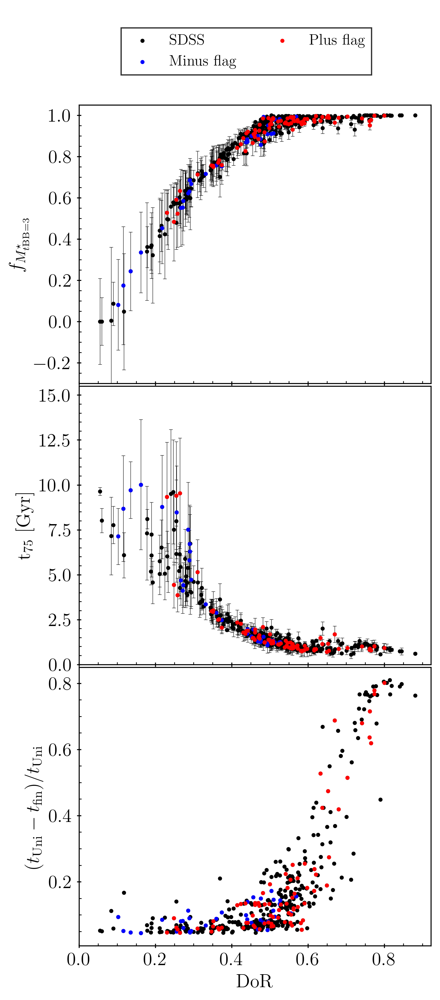

In [105]:
df_minus = df[df['alpha_flag']==-1]
df_plus = df[df['alpha_flag']==1]

fig, axs = plt.subplots(3, 1, sharex=True, figsize=(5, 12))
fig.subplots_adjust(hspace=0.01)

axs[0].set_ylim(top=1.05, bottom=-0.3)
err_mass_frac = np.nanstd([df['mass_frac_reg'].values, df['mass_frac_unr'].values, df['mass_frac_plus'], df['mass_frac_min']], axis=0)
axs[0].errorbar(df['dor'], df['mass_frac'], yerr=err_mass_frac, fmt='none', c='k', zorder=1, capsize=1.5, elinewidth=0.3, capthick=0.3)
axs[0].scatter(df['dor'], df['mass_frac'], s=5, c='black', label='SDSS')
axs[0].scatter(df_minus['dor'], df_minus['mass_frac'], s=5, c='blue', label='Minus flag')
axs[0].scatter(df_plus['dor'], df_plus['mass_frac'], s=5, c='red', label='Plus flag')
axs[0].set_ylabel(r'$f_{M^{\star}_{t\mathrm{BB}=3}}$')
axs[0].minorticks_on()
axs[0].tick_params(axis='both',which='major',direction='inout')
axs[0].tick_params(axis='both',which='minor',direction='in')

axs[1].set_ylim(top=15.5, bottom=0)
err_time_75 = np.nanstd([df['time_75_reg'].values, df['time_75_unr'].values, df['time_75_plus'], df['time_75_min']], axis=0)
axs[1].errorbar(df['dor'], df['time_75'], yerr=err_time_75, fmt='none', c='k', zorder=1, capsize=1.5, elinewidth=0.3, capthick=0.3)
axs[1].scatter(df['dor'], df['time_75'], s=5, c='black')
axs[1].scatter(df_minus['dor'], df_minus['time_75'], s=5, c='blue')
axs[1].scatter(df_plus['dor'], df_plus['time_75'], s=5, c='red')
axs[1].set_ylabel(r't$_{75}$ [Gyr]')
axs[1].minorticks_on()
axs[1].tick_params(axis='both',which='major',direction='inout')
axs[1].tick_params(axis='both',which='minor',direction='in')

axs[2].scatter(df['dor'],(np.array(df['univ_age'])-np.array(df['time_100']))/np.array(df['univ_age']), s=5, c='black')
axs[2].scatter(df_minus['dor'],(np.array(df_minus['univ_age'])-np.array(df_minus['time_100']))/np.array(df_minus['univ_age']), s=5, c='blue')
axs[2].scatter(df_plus['dor'],(np.array(df_plus['univ_age'])-np.array(df_plus['time_100']))/np.array(df_plus['univ_age']), s=5, c='red')
axs[2].set_xlabel('DoR')
axs[2].set_xticks([0, 0.2, 0.4, 0.6, 0.8])
axs[2].set_ylabel(r'$(t_{\mathrm{Uni}} - t_{\mathrm{fin}})/t_{\mathrm{Uni}}$')
axs[2].minorticks_on()
axs[2].tick_params(axis='both',which='major',direction='inout')
axs[2].tick_params(axis='both',which='minor',direction='in')

plt.figlegend(loc=[0.275,0.925], ncol=2, fontsize=12, fancybox=False, edgecolor='black');

#fig.savefig('/Users/johnmills/Summer project/paper_plots/dor_properties.pdf', bbox_inches='tight', dpi=300)

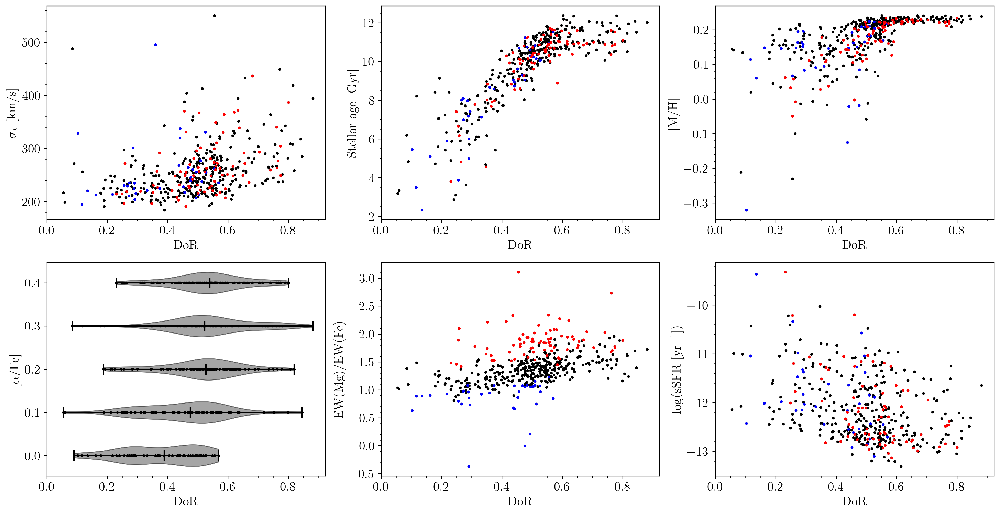

In [106]:
df_minus = df[df['alpha_flag']==-1]
df_plus = df[df['alpha_flag']==1]

fig, axs = plt.subplots(2, 3, figsize=(20, 10))

axs[0, 0].scatter(df['dor'], df['velDisp_ppxf'], s=5, c='k')
axs[0, 0].scatter(df_minus['dor'], df_minus['velDisp_ppxf'], s=5, c='blue')
axs[0, 0].scatter(df_plus['dor'], df_plus['velDisp_ppxf'], s=5, c='red')
axs[0, 0].set_xlabel('DoR')
axs[0, 0].set_ylabel(r'$\sigma_{\star}$ [km/s]')
axs[0, 0].minorticks_on()
axs[0, 0].set_xticks([0., 0.2, 0.4, 0.6, 0.8]);

axs[0, 1].scatter(df['dor'], df['age_mean'], s=5, c='k')
axs[0, 1].scatter(df_minus['dor'], df_minus['age_mean'], s=5, c='blue')
axs[0, 1].scatter(df_plus['dor'], df_plus['age_mean'], s=5, c='red')
axs[0, 1].set_xlabel('DoR')
axs[0, 1].set_ylabel('Stellar age [Gyr]')
axs[0, 1].minorticks_on()
axs[0, 1].set_xticks([0., 0.2, 0.4, 0.6, 0.8]);

axs[0, 2].scatter(df['dor'], df['[M/H]_mean'], s=5, c='k')
axs[0, 2].scatter(df_minus['dor'], df_minus['[M/H]_mean'], s=5, c='blue')
axs[0, 2].scatter(df_plus['dor'], df_plus['[M/H]_mean'], s=5, c='red')
axs[0, 2].set_xlabel('DoR')
axs[0, 2].set_ylabel('[M/H]')
axs[0, 2].minorticks_on()
axs[0, 2].set_xticks([0., 0.2, 0.4, 0.6, 0.8]);

parts = axs[1, 0].violinplot(dor_alphas, vert=False, showmedians=True, positions=dor_alphas_label, widths=0.05)
for pc in parts['bodies']:
    pc.set_facecolor('0.3')
    pc.set_edgecolor('black')
    pc.set_alpha(0.5)
for partname in ('cbars','cmins','cmaxes','cmedians'):
    vp = parts[partname]
    vp.set_edgecolor('k')
axs[1, 0].scatter(df['dor'], df['alpha'], s=5, c='k')
axs[1, 0].set_ylabel(r'[$\alpha$/Fe]')
axs[1, 0].set_xlabel('DoR')
axs[1, 0].minorticks_on()
axs[1, 0].tick_params(axis='y', which='minor', left=False)
axs[1, 0].set_xticks([0., 0.2, 0.4, 0.6, 0.8]);

axs[1, 1].scatter(df['dor'], df['Mgb_corr']/df['Fe_avg_corr'], s=5, c='k')
axs[1, 1].scatter(df_minus['dor'], df_minus['Mgb_corr']/df_minus['Fe_avg_corr'], s=5, c='blue')
axs[1, 1].scatter(df_plus['dor'], df_plus['Mgb_corr']/df_plus['Fe_avg_corr'], s=5, c='red')
axs[1, 1].set_xlabel('DoR')
axs[1, 1].set_ylabel('EW(Mg)/EW(Fe)')
axs[1, 1].minorticks_on()
axs[1, 1].set_xticks([0., 0.2, 0.4, 0.6, 0.8]);

axs[1, 2].scatter(df['dor'], df['logsSFR'], s=5, c='k')
axs[1, 2].scatter(df_minus['dor'], df_minus['logsSFR'], s=5, c='blue')
axs[1, 2].scatter(df_plus['dor'], df_plus['logsSFR'], s=5, c='red')
axs[1, 2].set_xlabel('DoR')
axs[1, 2].set_ylabel(r'$\log(\rm sSFR~[yr^{-1}])$')
axs[1, 2].minorticks_on()
axs[1, 2].set_xticks([0., 0.2, 0.4, 0.6, 0.8]);

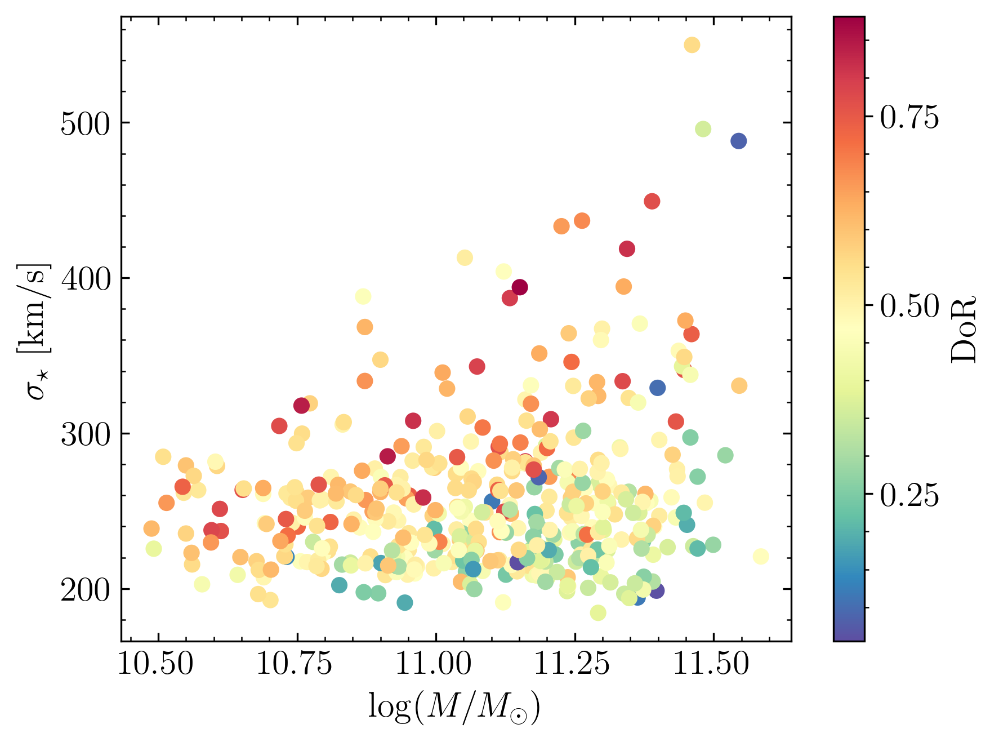

In [107]:
fig, ax = plt.subplots()

pc = ax.scatter(df['logM'], df['velDisp_ppxf'], c=df['dor'], cmap='Spectral_r')
ax.set_xlabel(r'$\log(M/M_{\odot})$')
ax.set_ylabel(r'$\sigma_{\star}$ [km/s]')
ax.minorticks_on()
ax.tick_params(axis='both',which='both',direction='in', right=True, top=True)

cb = fig.colorbar(pc, label='DoR', ticks=[0, 0.25, 0.5, 0.75])
cb.minorticks_on()

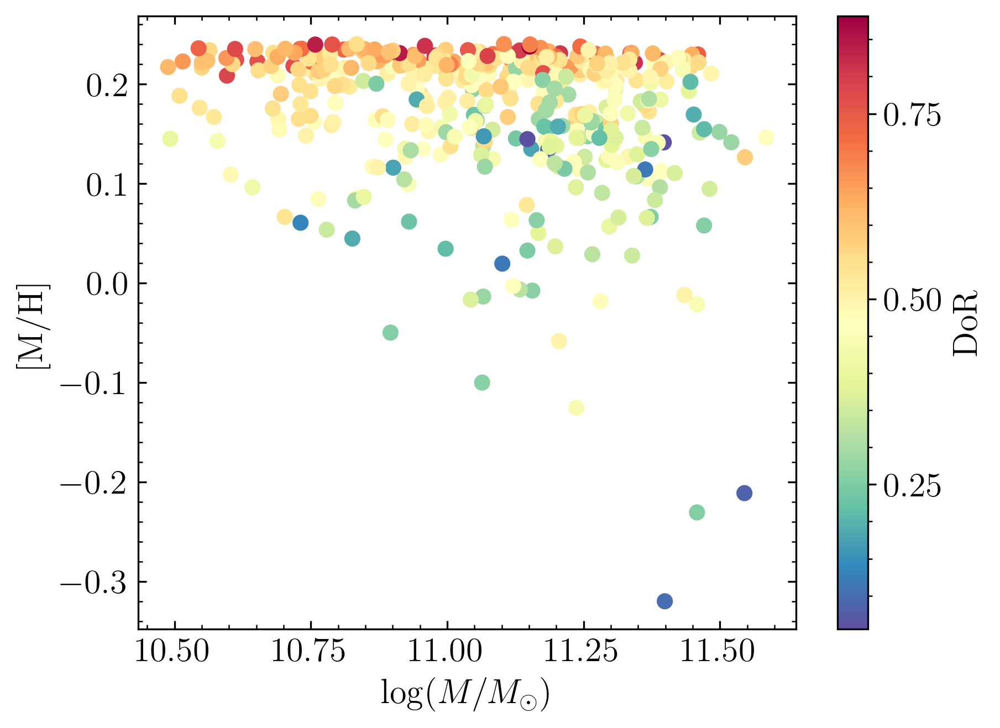

In [108]:
fig, ax = plt.subplots()

pc = ax.scatter(df['logM'], df['[M/H]_mean'], c=df['dor'], cmap='Spectral_r')
ax.set_xlabel(r'$\log(M/M_{\odot})$')
ax.set_ylabel(r'[M/H]')
ax.minorticks_on()
ax.tick_params(axis='both',which='both',direction='in', right=True, top=True)

cb = fig.colorbar(pc, label='DoR', ticks=[0, 0.25, 0.5, 0.75])
cb.minorticks_on()

In [109]:
df = df.sort_values(by='logM')

df1 = df[df['dor'] <= 0.3]
df2 = df[(df['dor'] > 0.3) & (df['dor'] <= 0.6)]
df3 = df[df['dor'] > 0.6]



# Define the bin edges
bins = np.arange(df['logM'].min(), df['logM'].max(), 0.1)

# Create new columns in each dataframe with the bin labels
df1['mass_bin'] = pd.cut(df1['logM'], bins=bins)
df2['mass_bin'] = pd.cut(df2['logM'], bins=bins)
df3['mass_bin'] = pd.cut(df3['logM'], bins=bins)


/var/folders/kr/72nydvwn1459_65gt4wly9fw0000gn/T/ipykernel_35325/3470219779.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1['mass_bin'] = pd.cut(df1['logM'], bins=bins)
/var/folders/kr/72nydvwn1459_65gt4wly9fw0000gn/T/ipykernel_35325/3470219779.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['mass_bin'] = pd.cut(df2['logM'], bins=bins)
/var/folders/kr/72nydvwn1459_65gt4wly9fw0000gn/T/ipykernel_35325/3470219779.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice

In [110]:
# For each dataframe, group by mass_bin and compute mean and std
# For each dataframe, group by mass_bin and compute mean and std
df1_grouped = df1.groupby('mass_bin')[['[M/H]_mean', 'dor', 'logM']].agg(['mean', 'std'])
df2_grouped = df2.groupby('mass_bin')[['[M/H]_mean', 'dor', 'logM']].agg(['mean', 'std'])
df3_grouped = df3.groupby('mass_bin')[['[M/H]_mean', 'dor', 'logM']].agg(['mean', 'std'])

/var/folders/kr/72nydvwn1459_65gt4wly9fw0000gn/T/ipykernel_35325/396381298.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df1_grouped = df1.groupby('mass_bin')[['[M/H]_mean', 'dor', 'logM']].agg(['mean', 'std'])
/var/folders/kr/72nydvwn1459_65gt4wly9fw0000gn/T/ipykernel_35325/396381298.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df2_grouped = df2.groupby('mass_bin')[['[M/H]_mean', 'dor', 'logM']].agg(['mean', 'std'])
/var/folders/kr/72nydvwn1459_65gt4wly9fw0000gn/T/ipykernel_35325/396381298.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future ve

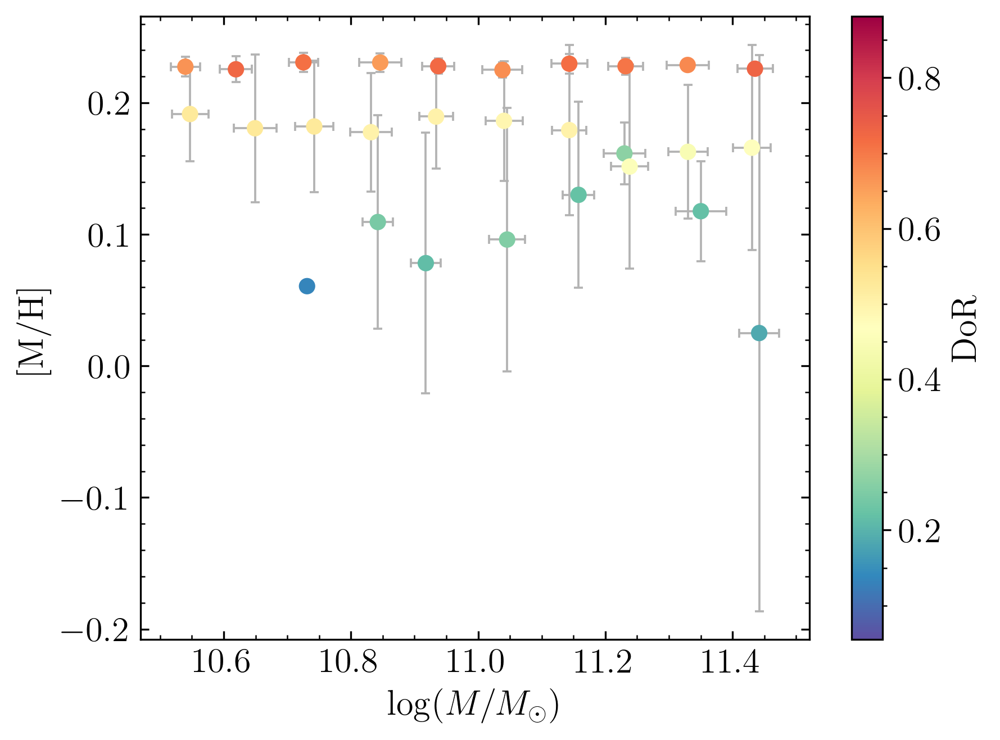

In [111]:
fig, ax = plt.subplots()

cmap = plt.get_cmap('Spectral_r')
norm = plt.Normalize(df['dor'].min(), df['dor'].max())

ax.errorbar(df1_grouped['logM']['mean'], df1_grouped['[M/H]_mean']['mean'], xerr=df1_grouped['logM']['std'], yerr=df1_grouped['[M/H]_mean']['std'], fmt='none', c='0.7', zorder=0, capsize=2, elinewidth=0.9, capthick=0.9)
ax.errorbar(df2_grouped['logM']['mean'], df2_grouped['[M/H]_mean']['mean'], xerr=df2_grouped['logM']['std'], yerr=df2_grouped['[M/H]_mean']['std'], fmt='none', c='0.7', zorder=0, capsize=2, elinewidth=0.9, capthick=0.9)
ax.errorbar(df3_grouped['logM']['mean'], df3_grouped['[M/H]_mean']['mean'], xerr=df3_grouped['logM']['std'], yerr=df3_grouped['[M/H]_mean']['std'], fmt='none', c='0.7', zorder=0, capsize=2, elinewidth=0.9, capthick=0.9)
ax.scatter(df1_grouped['logM']['mean'], df1_grouped['[M/H]_mean']['mean'], c=cmap(norm(df1_grouped['dor']['mean'])))
ax.scatter(df2_grouped['logM']['mean'], df2_grouped['[M/H]_mean']['mean'], c=cmap(norm(df2_grouped['dor']['mean'])))
ax.scatter(df3_grouped['logM']['mean'], df3_grouped['[M/H]_mean']['mean'], c=cmap(norm(df3_grouped['dor']['mean'])))

ax.set_xlabel(r'$\log(M/M_{\odot})$')
ax.set_ylabel(r'[M/H]')
ax.minorticks_on()
ax.tick_params(axis='both',which='both',direction='in', right=True, top=True)

cb = fig.colorbar(cm.ScalarMappable(norm=norm, cmap=cmap), ax=ax, label='DoR');
cb.minorticks_on()

In [112]:
# For each dataframe, group by mass_bin and compute mean and std
# For each dataframe, group by mass_bin and compute mean and std
df1_groupeda = df1.groupby('mass_bin')[['velDisp_ppxf', 'dor', 'logM']].agg(['mean', 'std'])
df2_groupeda = df2.groupby('mass_bin')[['velDisp_ppxf', 'dor', 'logM']].agg(['mean', 'std'])
df3_groupeda = df3.groupby('mass_bin')[['velDisp_ppxf', 'dor', 'logM']].agg(['mean', 'std'])

/var/folders/kr/72nydvwn1459_65gt4wly9fw0000gn/T/ipykernel_35325/1823798704.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df1_groupeda = df1.groupby('mass_bin')[['velDisp_ppxf', 'dor', 'logM']].agg(['mean', 'std'])
/var/folders/kr/72nydvwn1459_65gt4wly9fw0000gn/T/ipykernel_35325/1823798704.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df2_groupeda = df2.groupby('mass_bin')[['velDisp_ppxf', 'dor', 'logM']].agg(['mean', 'std'])
/var/folders/kr/72nydvwn1459_65gt4wly9fw0000gn/T/ipykernel_35325/1823798704.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a 

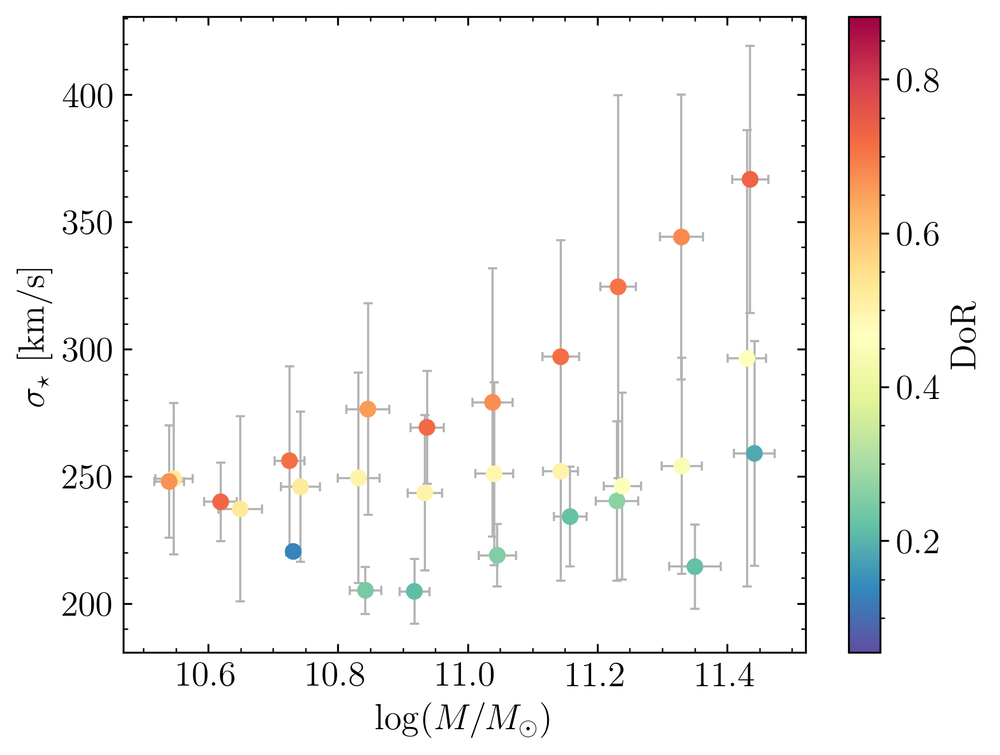

In [113]:
fig, ax = plt.subplots()

cmap = plt.get_cmap('Spectral_r')
norm = plt.Normalize(df['dor'].min(), df['dor'].max())

ax.errorbar(df1_groupeda['logM']['mean'], df1_groupeda['velDisp_ppxf']['mean'], xerr=df1_groupeda['logM']['std'], yerr=df1_groupeda['velDisp_ppxf']['std'], fmt='none', c='0.7', zorder=0, capsize=2, elinewidth=0.9, capthick=0.9)
ax.errorbar(df2_groupeda['logM']['mean'], df2_groupeda['velDisp_ppxf']['mean'], xerr=df2_groupeda['logM']['std'], yerr=df2_groupeda['velDisp_ppxf']['std'], fmt='none', c='0.7', zorder=0, capsize=2, elinewidth=0.9, capthick=0.9)
ax.errorbar(df3_groupeda['logM']['mean'], df3_groupeda['velDisp_ppxf']['mean'], xerr=df3_groupeda['logM']['std'], yerr=df3_groupeda['velDisp_ppxf']['std'], fmt='none', c='0.7', zorder=0, capsize=2, elinewidth=0.9, capthick=0.9)
ax.scatter(df1_groupeda['logM']['mean'], df1_groupeda['velDisp_ppxf']['mean'], c=cmap(norm(df1_groupeda['dor']['mean'])))
ax.scatter(df2_groupeda['logM']['mean'], df2_groupeda['velDisp_ppxf']['mean'], c=cmap(norm(df2_groupeda['dor']['mean'])))
ax.scatter(df3_groupeda['logM']['mean'], df3_groupeda['velDisp_ppxf']['mean'], c=cmap(norm(df3_groupeda['dor']['mean'])))

ax.set_xlabel(r'$\log(M/M_{\odot})$')
ax.set_ylabel(r'$\sigma_{\star}$ [km/s]')
ax.minorticks_on()
ax.tick_params(axis='both',which='both',direction='in', right=True, top=True)

cb = fig.colorbar(cm.ScalarMappable(norm=norm, cmap=cmap), ax=ax, label='DoR');
cb.minorticks_on()

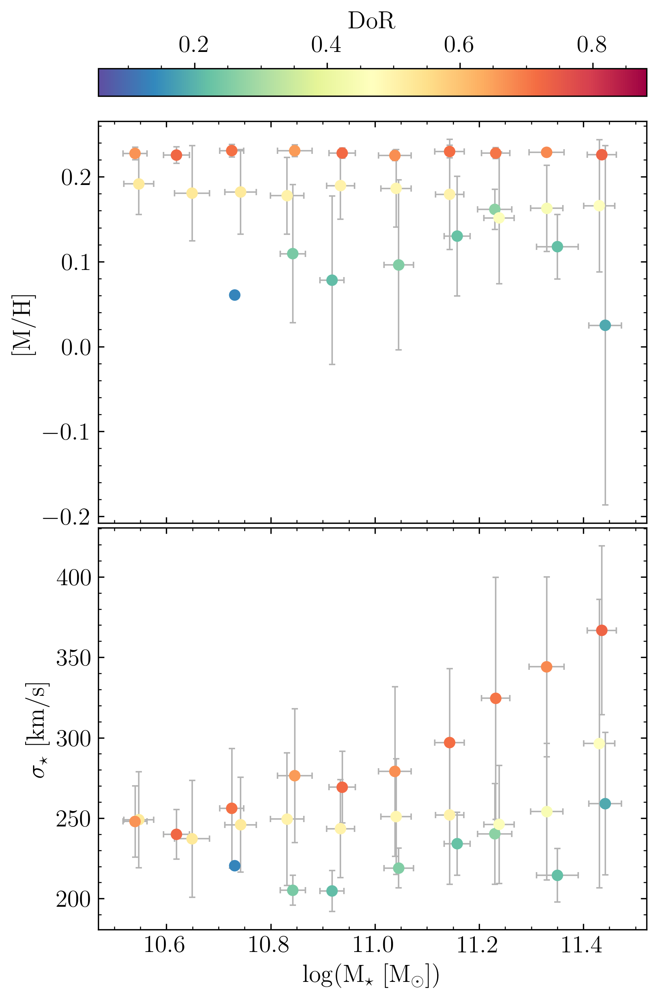

In [114]:
fig, axs = plt.subplots(2, 1, figsize=(6,10), sharex=True, height_ratios=[1.25, 1])
fig.subplots_adjust(hspace=0.01)
cmap = plt.get_cmap('Spectral_r')
norm = plt.Normalize(df['dor'].min(), df['dor'].max())

axs[0].errorbar(df1_grouped['logM']['mean'], df1_grouped['[M/H]_mean']['mean'], xerr=df1_grouped['logM']['std'], yerr=df1_grouped['[M/H]_mean']['std'], fmt='none', c='0.7', zorder=0, capsize=2, elinewidth=0.9, capthick=0.9)
axs[0].errorbar(df2_grouped['logM']['mean'], df2_grouped['[M/H]_mean']['mean'], xerr=df2_grouped['logM']['std'], yerr=df2_grouped['[M/H]_mean']['std'], fmt='none', c='0.7', zorder=0, capsize=2, elinewidth=0.9, capthick=0.9)
axs[0].errorbar(df3_grouped['logM']['mean'], df3_grouped['[M/H]_mean']['mean'], xerr=df3_grouped['logM']['std'], yerr=df3_grouped['[M/H]_mean']['std'], fmt='none', c='0.7', zorder=0, capsize=2, elinewidth=0.9, capthick=0.9)
axs[0].scatter(df1_grouped['logM']['mean'], df1_grouped['[M/H]_mean']['mean'], c=cmap(norm(df1_grouped['dor']['mean'])))
axs[0].scatter(df2_grouped['logM']['mean'], df2_grouped['[M/H]_mean']['mean'], c=cmap(norm(df2_grouped['dor']['mean'])))
axs[0].scatter(df3_grouped['logM']['mean'], df3_grouped['[M/H]_mean']['mean'], c=cmap(norm(df3_grouped['dor']['mean'])))

axs[0].set_ylabel(r'[M/H]')
axs[0].minorticks_on()
axs[0].tick_params(axis='both',which='both',direction='in', right=True, top=True)

axs[1].errorbar(df1_groupeda['logM']['mean'], df1_groupeda['velDisp_ppxf']['mean'], xerr=df1_groupeda['logM']['std'], yerr=df1_groupeda['velDisp_ppxf']['std'], fmt='none', c='0.7', zorder=0, capsize=2, elinewidth=0.9, capthick=0.9)
axs[1].errorbar(df2_groupeda['logM']['mean'], df2_groupeda['velDisp_ppxf']['mean'], xerr=df2_groupeda['logM']['std'], yerr=df2_groupeda['velDisp_ppxf']['std'], fmt='none', c='0.7', zorder=0, capsize=2, elinewidth=0.9, capthick=0.9)
axs[1].errorbar(df3_groupeda['logM']['mean'], df3_groupeda['velDisp_ppxf']['mean'], xerr=df3_groupeda['logM']['std'], yerr=df3_groupeda['velDisp_ppxf']['std'], fmt='none', c='0.7', zorder=0, capsize=2, elinewidth=0.9, capthick=0.9)
axs[1].scatter(df1_groupeda['logM']['mean'], df1_groupeda['velDisp_ppxf']['mean'], c=cmap(norm(df1_groupeda['dor']['mean'])))
axs[1].scatter(df2_groupeda['logM']['mean'], df2_groupeda['velDisp_ppxf']['mean'], c=cmap(norm(df2_groupeda['dor']['mean'])))
axs[1].scatter(df3_groupeda['logM']['mean'], df3_groupeda['velDisp_ppxf']['mean'], c=cmap(norm(df3_groupeda['dor']['mean'])))

axs[1].set_xlabel(r'$\log(\rm M_{\star}$ $\rm [M_{\odot}])$')
axs[1].set_ylabel(r'$\sigma_{\star}$ [km/s]')
axs[1].minorticks_on()
axs[1].tick_params(axis='both',which='both',direction='in', right=True, top=True)

cb = fig.colorbar(cm.ScalarMappable(norm=norm, cmap=cmap), ax=axs[0], label='DoR', location='top');
cb.minorticks_on()

fig.savefig('/Users/johnmills/Summer project/paper_plots/dor_mass_properties.pdf', bbox_inches='tight', dpi=300)

In [115]:
df3['mass_frac'].min()

0.93027

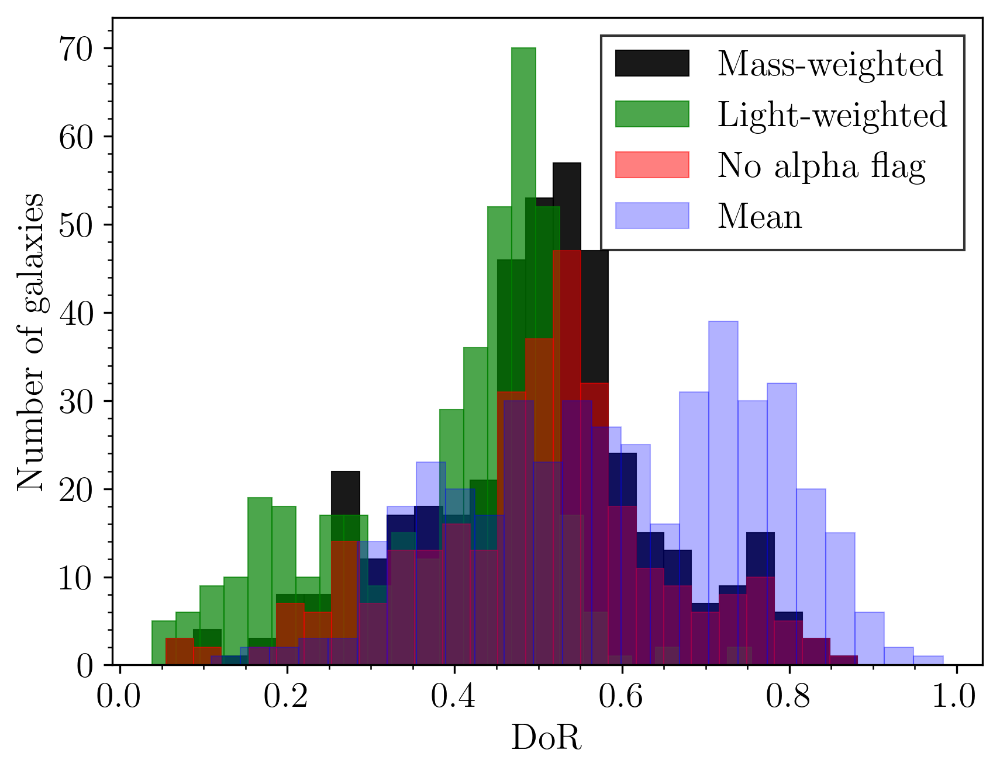

In [116]:
df_light = pd.read_csv('DoR_fit/ppxf_stel_pop_dor_light.csv')
df_noalpha = df[df['alpha_flag']==0]
fig, ax = plt.subplots()

ax.hist(df['dor'], bins=25, color='k', alpha=0.9, label='Mass-weighted', edgecolor='black', linewidth=0.5)
ax.hist(df_light['dor_2'], bins=25, color='g', alpha=0.7, label='Light-weighted', edgecolor='g', linewidth=0.5)
ax.hist(df_noalpha['dor'], bins=25, color='r', alpha=0.5, label='No alpha flag', edgecolor='r', linewidth=0.5)
ax.hist(df['dor_mean'], bins=25, color='b', alpha=0.3, label='Mean', edgecolor='b', linewidth=0.5)
ax.set_xlabel('DoR')
ax.set_ylabel('Number of galaxies')
ax.minorticks_on()
ax.legend(fancybox=False, edgecolor='black')

fig.savefig('/Users/johnmills/Summer project/paper_plots/dor_compare.pdf', bbox_inches='tight', dpi=300)

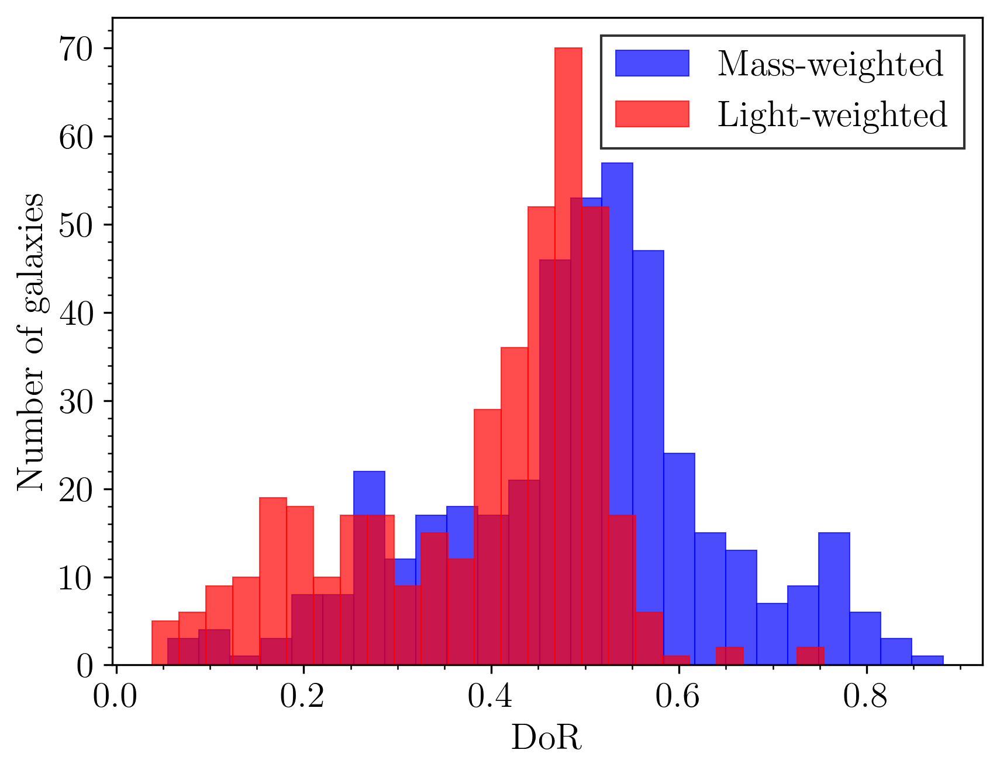

In [117]:
fig, ax = plt.subplots()

ax.hist(df['dor'], bins=25, color='b', alpha=0.7, label='Mass-weighted', edgecolor='b', linewidth=0.5)
ax.hist(df_light['dor_2'], bins=25, color='r', alpha=0.7, label='Light-weighted', edgecolor='r', linewidth=0.5)
ax.set_xlabel('DoR')
ax.set_ylabel('Number of galaxies')
ax.minorticks_on()
ax.legend(fancybox=False, edgecolor='black')

fig.savefig('/Users/johnmills/Summer project/paper_plots/light_mass.pdf', bbox_inches='tight', dpi=300)

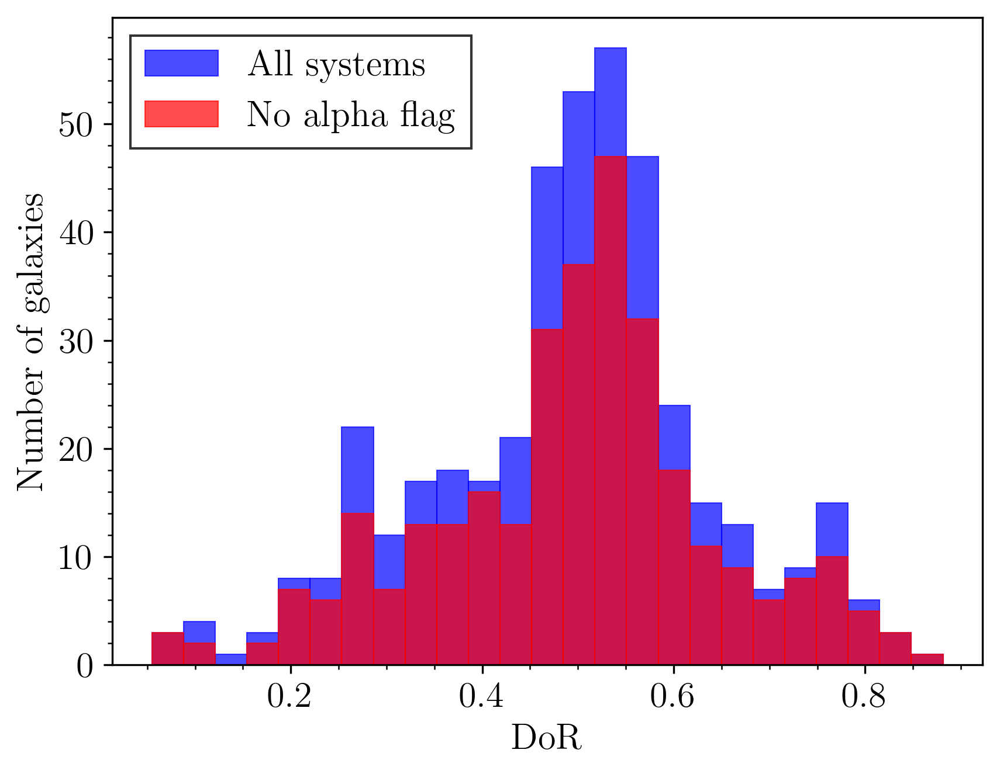

In [118]:
fig, ax = plt.subplots()

ax.hist(df['dor'], bins=25, color='b', alpha=0.7, label='All systems', edgecolor='b', linewidth=0.5)
ax.hist(df[df['alpha_flag']==0]['dor'], bins=25, color='r', alpha=0.7, label='No alpha flag', edgecolor='r', linewidth=0.5)
ax.set_xlabel('DoR')
ax.set_ylabel('Number of galaxies')
ax.minorticks_on()
ax.legend(fancybox=False, edgecolor='black')

fig.savefig('/Users/johnmills/Summer project/paper_plots/dor_alpha.pdf', bbox_inches='tight', dpi=300)

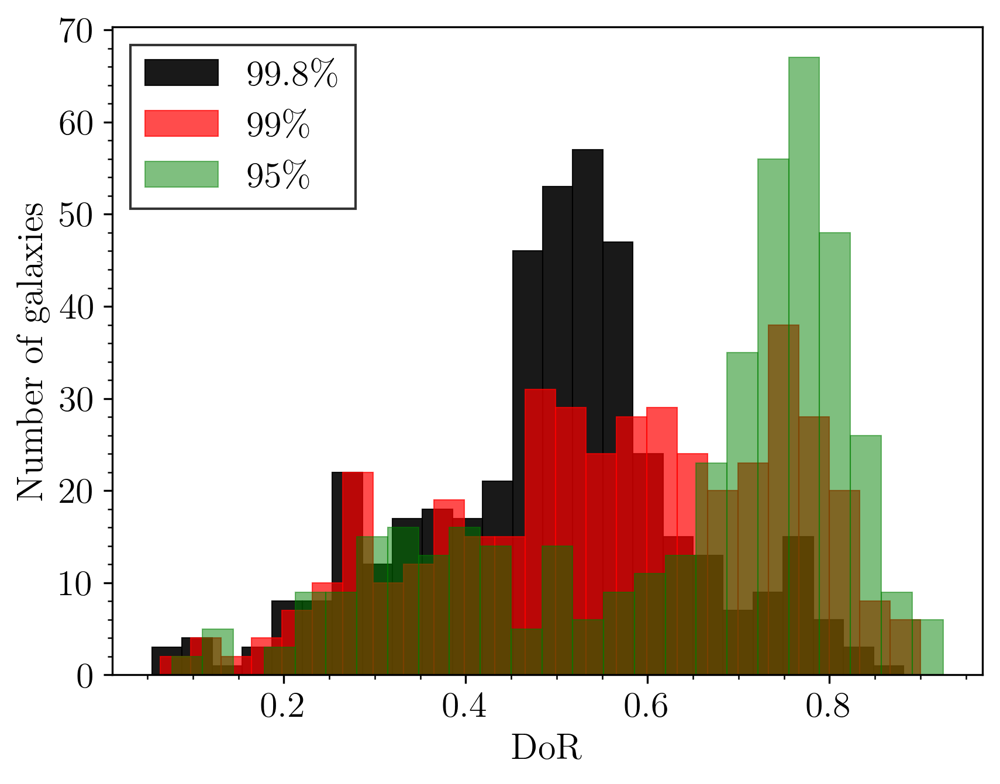

In [119]:
fig, ax = plt.subplots()

ax.hist(df['dor'], bins=25, color='k', alpha=0.9, label=r'99.8\%', edgecolor='black', linewidth=0.5)
ax.hist(df['dor_99'], bins=25, color='r', alpha=0.7, label=r'99\%', edgecolor='r', linewidth=0.5)
ax.hist(df['dor_95'], bins=25, color='g', alpha=0.5, label=r'95\%', edgecolor='g', linewidth=0.5)
ax.set_xlabel('DoR')
ax.set_ylabel('Number of galaxies')
ax.minorticks_on()
ax.legend(fancybox=False, edgecolor='black')

fig.savefig('/Users/johnmills/Summer project/paper_plots/dor_tfin.pdf', bbox_inches='tight', dpi=300)

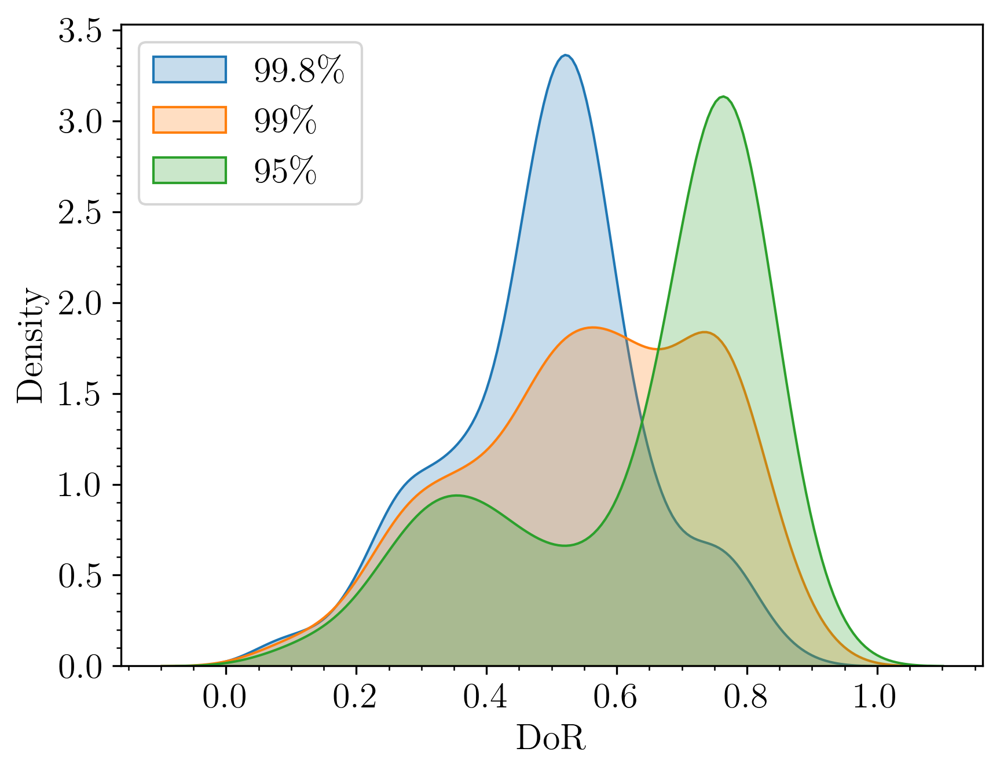

In [120]:

# Plot KDE for 'dor'
sns.kdeplot(df['dor'], label=r'99.8\%', fill=True)

# Plot KDE for 'dor_99'
sns.kdeplot(df['dor_99'], label=r'99\%', fill=True)

# Plot KDE for 'dor_95'
sns.kdeplot(df['dor_95'], label=r'95\%', fill=True)

plt.xlabel('DoR')
plt.ylabel('Density')
plt.minorticks_on()
plt.legend()

plt.savefig('/Users/johnmills/Summer project/paper_plots/dor_tfin.pdf', bbox_inches='tight', dpi=300)

plt.show()

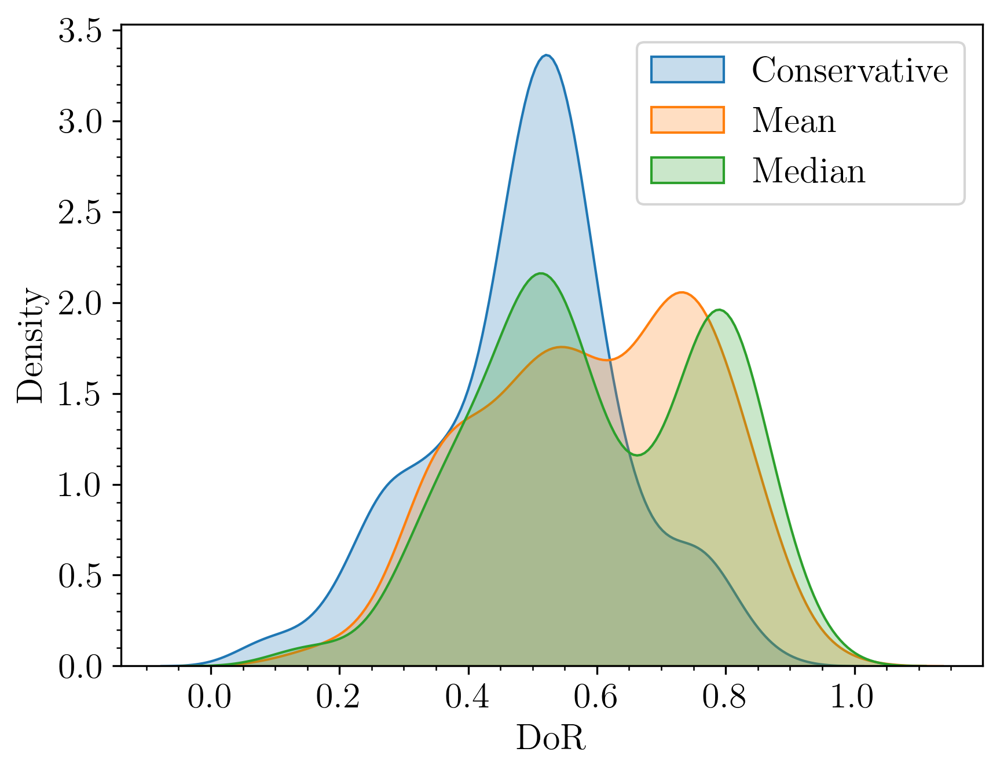

In [121]:

# Plot KDE for 'dor'
sns.kdeplot(df['dor'], label='Conservative', fill=True)

# Plot KDE for 'dor_99'
sns.kdeplot(df['dor_mean'], label='Mean', fill=True)

# Plot KDE for 'dor_95'
sns.kdeplot(df['dor_med'], label='Median', fill=True)

plt.xlabel('DoR')
plt.ylabel('Density')
plt.minorticks_on()
plt.legend()

plt.savefig('/Users/johnmills/Summer project/paper_plots/dor_compare.pdf', bbox_inches='tight', dpi=300)

plt.show()

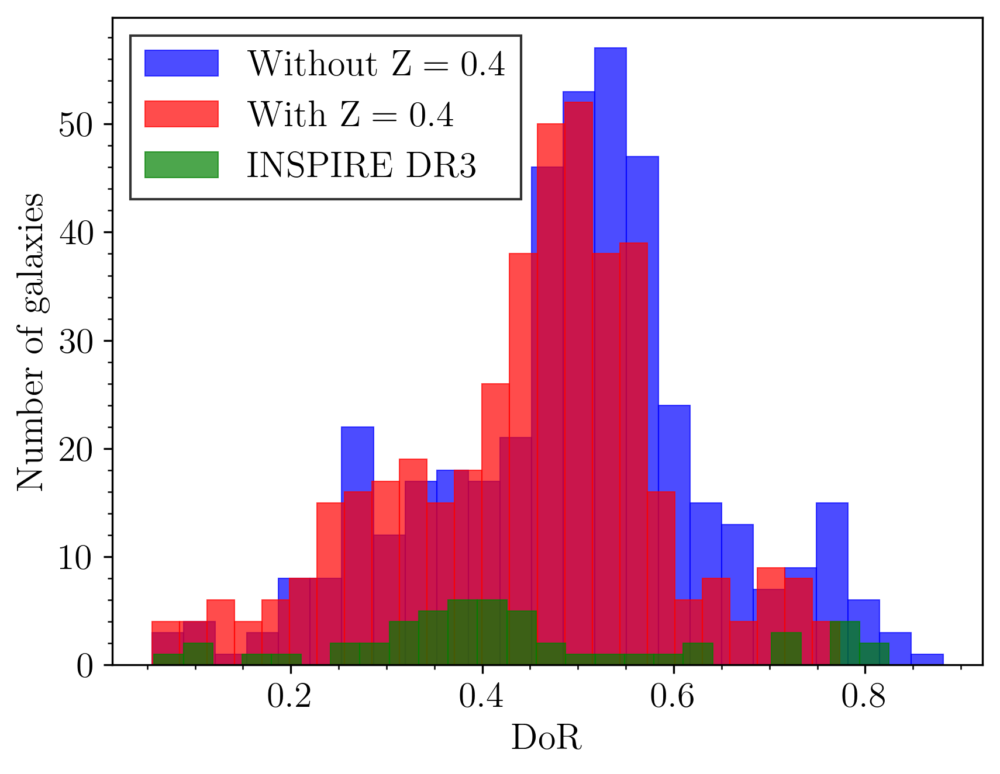

In [122]:
df_Z = pd.read_csv('/Users/johnmills/Summer project/DoR_fit/ppxf_stel_pop_test2_small.csv')

fig, ax = plt.subplots()

ax.hist(df['dor'], bins=25, color='b', alpha=0.7, label=r'Without $\mathrm{Z}=0.4$', edgecolor='b', linewidth=0.5)
ax.hist(df_Z['dor_2'], bins=25, color='r', alpha=0.7, label=r'With $\mathrm{Z}=0.4$', edgecolor='r', linewidth=0.5)
ax.hist(df_inspire['DoR'], bins=25, color='g', alpha=0.7, label='INSPIRE DR3', edgecolor='g', linewidth=0.5)

ax.set_xlabel('DoR')
ax.set_ylabel('Number of galaxies')
ax.minorticks_on()
ax.legend(fancybox=False, edgecolor='black')

fig.savefig('/Users/johnmills/Summer project/paper_plots/dor_Z.pdf', bbox_inches='tight', dpi=300)

In [123]:
df['dor'].min(), df['dor'].max()

(0.0548987891568517, 0.8813557976078031)

In [124]:
df_Z.head()
df_Z.columns
print(len(df_Z))

430


In [125]:
df_Z.drop(['logAge_boot', '[M/H]_boot'], inplace=True, axis=1)

KeyError: "['logAge_boot', '[M/H]_boot'] not found in axis"

In [ ]:
#Rename columns

df_Z = df_Z.rename(columns={'logAge': 'logAge_boot', '[M/H]': '[M/H]_boot'})
df_Z.columns

Index(['ra', 'dec', 'deVRad_r', 'deVRadErr_r', 'expRad_r', 'expRadErr_r', 'z',
       'zErr', 'velDisp', 'velDispErr', 'logM', 'errlogM', 'logSFR',
       'errlogSFR', 'logsSFR', 'errlogsSFR', 'petroR50Errkpc_r',
       'petroR50kpc_r', 'deVRadkpc_r', 'deVRadErrkpc_r', 'expRadkpc_r',
       'expRadErrkpc_r', 'fracDev_r', 'meanRadkpc_r', 'plate', 'mjd',
       'fiberid', 'velDisp_ppxf', 'Mgb', 'Fe_avg', 'Mgb_corr', 'Fe_avg_corr',
       'alpha', 'alpha_flag', 'sexa_id', 'objid', 'SNR', 'mass_frac',
       'time_75', 'time_90', 'time_100', 'dor_100', 'univ_age',
       'mass_frac_reg', 'time_75_reg', 'time_90_reg', 'time_100_reg',
       'dor_100_reg', 'mass_frac_unr', 'time_75_unr', 'time_90_unr',
       'time_100_unr', 'dor_100_unr', 'mass_frac_plus', 'time_75_plus',
       'time_90_plus', 'time_100_plus', 'dor_100_plus', 'mass_frac_min',
       'time_75_min', 'time_90_min', 'time_100_min', 'dor_100_min', 'dor',
       'velDisp_ppxf_err', 'velDisp_ppxf_res', 'velDisp_ppxf_err_res',
   

In [ ]:
ages_unr = []
Zs_unr = []

ages_plus = []
Zs_plus = []

ages_minus = []
Zs_minus = []

In [ ]:
for index, row in df_Z.iterrows():
    
    fitsfilea = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test2/'+row['sexa_id']+'_ppxfout_UNR.fits'
    fitsfileb = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test2/'+row['sexa_id']+'_ppxfout_plus.fits'
    fitsfilec = '/Users/johnmills/Summer project/stel_pop_fit/ppxf_fits_test2/'+row['sexa_id']+'_ppxfout_minus.fits'

    hdua = fits.open(fitsfilea)
    age_unr = hdua[0].header['HIERARCH mean_age_unr']
    Z_unr = hdua[0].header['HIERARCH mean_metal_unr']
    ages_unr.append(age_unr)
    Zs_unr.append(Z_unr)

    if exists(fitsfileb):
        hdub = fits.open(fitsfileb)
        age_plus = hdub[0].header['HIERARCH mean_age_unr']
        Z_plus = hdub[0].header['HIERARCH mean_metal_unr']
        ages_plus.append(age_plus)
        Zs_plus.append(Z_plus)
    else:
        ages_plus.append(np.nan)
        Zs_plus.append(np.nan)

    if exists(fitsfilec):
        hduc = fits.open(fitsfilec)
        age_minus = hduc[0].header['HIERARCH mean_age_unr']
        Z_minus = hduc[0].header['HIERARCH mean_metal_unr']
        ages_minus.append(age_minus)
        Zs_minus.append(Z_minus)
    else:
        ages_minus.append(np.nan)
        Zs_minus.append(np.nan)

In [ ]:
df_Z['logAge_noboot'] = ages_unr
df_Z['[M/H]_noboot'] = Zs_unr

df_Z['logAge_plus'] = ages_plus
df_Z['[M/H]_plus'] = Zs_plus

df_Z['logAge_minus'] = ages_minus
df_Z['[M/H]_minus'] = Zs_minus

df_Z.head()

,ra,dec,deVRad_r,deVRadErr_r,expRad_r,expRadErr_r,z,zErr,velDisp,velDispErr,...,delta_t_plus,delta_t_minus,delta_t,delta_t_mean,dor_mean,t_ass_err,dor_99,dor_95,logAge_boot,[M/H]_boot
0,193.718574,3.884190,0.088969,0.012747,0.117509,0.071370,0.047738,0.000016,221.7735,7.324764,...,0.46128,0.50100,0.71110,0.536538,0.760234,0.255576,0.777305,0.808368,10.083826,0.275429
1,241.144435,17.713478,0.606192,0.007863,0.667950,0.007383,0.033591,0.000014,248.8389,6.107972,...,NaN,0.46271,0.73658,0.554100,0.776907,0.196166,0.780903,0.806745,10.095000,0.333764
2,199.928792,36.047752,0.331085,0.011339,0.396583,0.008480,0.072182,0.000035,252.3812,15.482260,...,NaN,0.70694,2.58734,1.363953,0.499544,0.128982,0.396033,0.576033,10.034431,0.164147
3,174.013169,55.057750,0.552964,0.015943,0.606772,0.007021,0.058337,0.000021,210.3475,9.151752,...,0.99069,NaN,1.27227,0.686827,0.641524,0.187370,0.609458,0.726817,10.060090,0.066725
4,112.363555,40.170965,0.366426,0.011117,0.477405,0.009015,0.071903,0.000023,212.5120,10.947290,...,0.59248,0.72623,2.10581,1.002598,0.672490,0.256468,0.621787,0.630025,10.055182,0.311284


In [ ]:
df_Z.columns

Index(['ra', 'dec', 'deVRad_r', 'deVRadErr_r', 'expRad_r', 'expRadErr_r', 'z',
       'zErr', 'velDisp', 'velDispErr', 'logM', 'errlogM', 'logSFR',
       'errlogSFR', 'logsSFR', 'errlogsSFR', 'petroR50Errkpc_r',
       'petroR50kpc_r', 'deVRadkpc_r', 'deVRadErrkpc_r', 'expRadkpc_r',
       'expRadErrkpc_r', 'fracDev_r', 'meanRadkpc_r', 'plate', 'mjd',
       'fiberid', 'velDisp_ppxf', 'Mgb', 'Fe_avg', 'Mgb_corr', 'Fe_avg_corr',
       'alpha', 'alpha_flag', 'sexa_id', 'objid', 'SNR', 'mass_frac',
       'time_75', 'time_90', 'time_100', 'dor_100', 'univ_age',
       'mass_frac_reg', 'time_75_reg', 'time_90_reg', 'time_100_reg',
       'dor_100_reg', 'mass_frac_unr', 'time_75_unr', 'time_90_unr',
       'time_100_unr', 'dor_100_unr', 'mass_frac_plus', 'time_75_plus',
       'time_90_plus', 'time_100_plus', 'dor_100_plus', 'mass_frac_min',
       'time_75_min', 'time_90_min', 'time_100_min', 'dor_100_min', 'dor',
       'velDisp_ppxf_err', 'velDisp_ppxf_res', 'velDisp_ppxf_err_res',
   

In [ ]:
df_Z['logAge_err'] = np.nanstd([df_Z['logAge_noboot'].values, df_Z['logAge_boot'].values, df_Z['logAge_plus'].values, df_Z['logAge_minus'].values], axis=0).tolist()
df_Z['[M/H]_err'] = np.nanstd([df_Z['[M/H]_noboot'].values, df_Z['[M/H]_boot'].values, df_Z['[M/H]_plus'].values, df_Z['[M/H]_minus'].values], axis=0).tolist()

df_Z['logAge_mean'] = np.nanmean([df_Z['logAge_noboot'].values, df_Z['logAge_boot'].values, df_Z['logAge_plus'].values, df_Z['logAge_minus'].values], axis=0).tolist()
df_Z['[M/H]_mean'] = np.nanmean([df_Z['[M/H]_noboot'].values, df_Z['[M/H]_boot'].values, df_Z['[M/H]_plus'].values, df_Z['[M/H]_minus'].values], axis=0).tolist()
df_Z.head()

,ra,dec,deVRad_r,deVRadErr_r,expRad_r,expRadErr_r,z,zErr,velDisp,velDispErr,...,delta_t_plus,delta_t_minus,delta_t,delta_t_mean,dor_mean,t_ass_err,dor_99,dor_95,logAge_boot,[M/H]_boot
0,193.718574,3.884190,0.088969,0.012747,0.117509,0.071370,0.047738,0.000016,221.7735,7.324764,...,0.46128,0.50100,0.71110,0.536538,0.760234,0.255576,0.777305,0.808368,10.083826,0.275429
1,241.144435,17.713478,0.606192,0.007863,0.667950,0.007383,0.033591,0.000014,248.8389,6.107972,...,NaN,0.46271,0.73658,0.554100,0.776907,0.196166,0.780903,0.806745,10.095000,0.333764
2,199.928792,36.047752,0.331085,0.011339,0.396583,0.008480,0.072182,0.000035,252.3812,15.482260,...,NaN,0.70694,2.58734,1.363953,0.499544,0.128982,0.396033,0.576033,10.034431,0.164147
3,174.013169,55.057750,0.552964,0.015943,0.606772,0.007021,0.058337,0.000021,210.3475,9.151752,...,0.99069,NaN,1.27227,0.686827,0.641524,0.187370,0.609458,0.726817,10.060090,0.066725
4,112.363555,40.170965,0.366426,0.011117,0.477405,0.009015,0.071903,0.000023,212.5120,10.947290,...,0.59248,0.72623,2.10581,1.002598,0.672490,0.256468,0.621787,0.630025,10.055182,0.311284


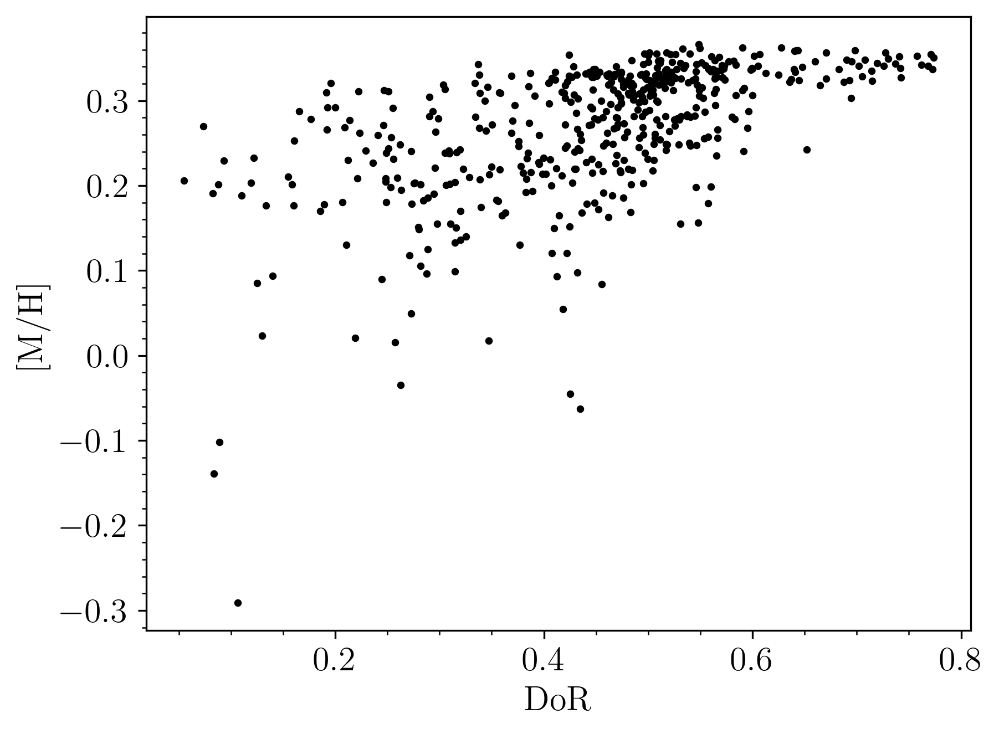

In [ ]:
fig, ax = plt.subplots()

ax.scatter(df_Z['dor'], df_Z['[M/H]_mean'], c='k', s=5)
ax.set_xlabel('DoR')
ax.set_ylabel('[M/H]')
ax.minorticks_on()


In [ ]:
df_Z['[M/H]_mean_2'].max()

0.2403795861214924

In [ ]:
df1 = df_Z[df_Z['dor'] <= 0.3]
df2 = df_Z[(df_Z['dor'] > 0.3) & (df['dor'] <= 0.6)]
df3 = df_Z[df_Z['dor'] > 0.6]



# Define the bin edges
bins = np.arange(df_Z['logM'].min(), df_Z['logM'].max(), 0.1)

# Create new columns in each dataframe with the bin labels
df1['mass_bin'] = pd.cut(df1['logM'], bins=bins)
df2['mass_bin'] = pd.cut(df2['logM'], bins=bins)
df3['mass_bin'] = pd.cut(df3['logM'], bins=bins)


/var/folders/kr/72nydvwn1459_65gt4wly9fw0000gn/T/ipykernel_4299/3409174726.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1['mass_bin'] = pd.cut(df1['logM'], bins=bins)
/var/folders/kr/72nydvwn1459_65gt4wly9fw0000gn/T/ipykernel_4299/3409174726.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['mass_bin'] = pd.cut(df2['logM'], bins=bins)
/var/folders/kr/72nydvwn1459_65gt4wly9fw0000gn/T/ipykernel_4299/3409174726.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice fr

In [ ]:
# For each dataframe, group by mass_bin and compute mean and std
# For each dataframe, group by mass_bin and compute mean and std
df1_grouped = df1.groupby('mass_bin')[['[M/H]_mean', 'dor', 'logM']].agg(['mean', 'std'])
df2_grouped = df2.groupby('mass_bin')[['[M/H]_mean', 'dor', 'logM']].agg(['mean', 'std'])
df3_grouped = df3.groupby('mass_bin')[['[M/H]_mean', 'dor', 'logM']].agg(['mean', 'std'])

/var/folders/kr/72nydvwn1459_65gt4wly9fw0000gn/T/ipykernel_4299/396381298.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df1_grouped = df1.groupby('mass_bin')[['[M/H]_mean', 'dor', 'logM']].agg(['mean', 'std'])
/var/folders/kr/72nydvwn1459_65gt4wly9fw0000gn/T/ipykernel_4299/396381298.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df2_grouped = df2.groupby('mass_bin')[['[M/H]_mean', 'dor', 'logM']].agg(['mean', 'std'])
/var/folders/kr/72nydvwn1459_65gt4wly9fw0000gn/T/ipykernel_4299/396381298.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future versi

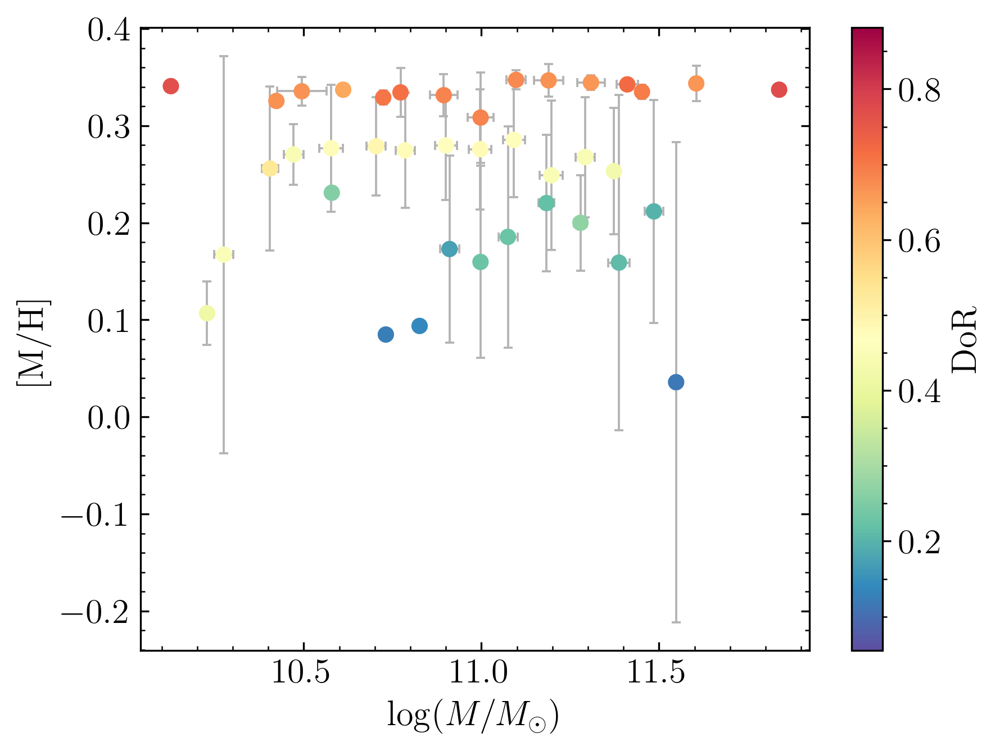

In [ ]:
fig, ax = plt.subplots()

cmap = plt.get_cmap('Spectral_r')
norm = plt.Normalize(df['dor'].min(), df['dor'].max())

ax.errorbar(df1_grouped['logM']['mean'], df1_grouped['[M/H]_mean']['mean'], xerr=df1_grouped['logM']['std'], yerr=df1_grouped['[M/H]_mean']['std'], fmt='none', c='0.7', zorder=0, capsize=2, elinewidth=0.9, capthick=0.9)
ax.errorbar(df2_grouped['logM']['mean'], df2_grouped['[M/H]_mean']['mean'], xerr=df2_grouped['logM']['std'], yerr=df2_grouped['[M/H]_mean']['std'], fmt='none', c='0.7', zorder=0, capsize=2, elinewidth=0.9, capthick=0.9)
ax.errorbar(df3_grouped['logM']['mean'], df3_grouped['[M/H]_mean']['mean'], xerr=df3_grouped['logM']['std'], yerr=df3_grouped['[M/H]_mean']['std'], fmt='none', c='0.7', zorder=0, capsize=2, elinewidth=0.9, capthick=0.9)
ax.scatter(df1_grouped['logM']['mean'], df1_grouped['[M/H]_mean']['mean'], c=cmap(norm(df1_grouped['dor']['mean'])))
ax.scatter(df2_grouped['logM']['mean'], df2_grouped['[M/H]_mean']['mean'], c=cmap(norm(df2_grouped['dor']['mean'])))
ax.scatter(df3_grouped['logM']['mean'], df3_grouped['[M/H]_mean']['mean'], c=cmap(norm(df3_grouped['dor']['mean'])))

ax.set_xlabel(r'$\log(M/M_{\odot})$')
ax.set_ylabel(r'[M/H]')
ax.minorticks_on()
ax.tick_params(axis='both',which='both',direction='in', right=True, top=True)

cb = fig.colorbar(cm.ScalarMappable(norm=norm, cmap=cmap), ax=ax, label='DoR');
cb.minorticks_on()

fig.savefig('/Users/johnmills/Summer project/paper_plots/dor_mass_properties_Z.pdf', bbox_inches='tight', dpi=300)

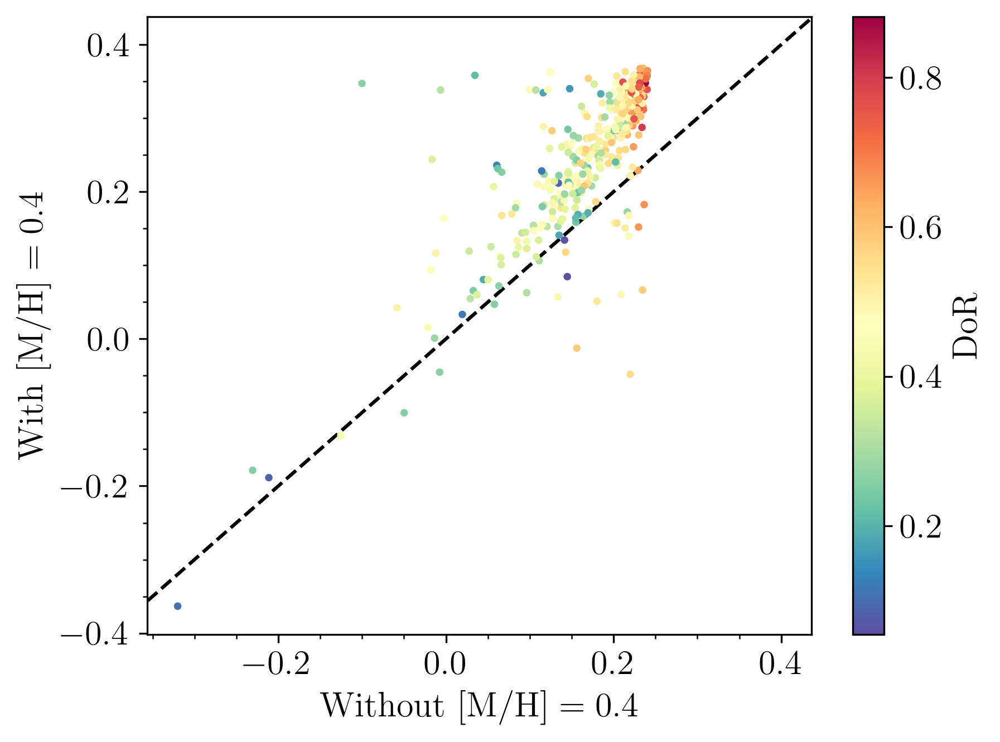

In [ ]:
fig, ax = plt.subplots()

pc = ax.scatter(df['[M/H]_mean'], df_Z['[M/H]'], c=df['dor'], s=5, cmap='Spectral_r')
ax.set_xlabel(r'Without $\textrm{[M/H]}=0.4$')
ax.set_ylabel(r'With $\textrm{[M/H]}=0.4$')
ax.minorticks_on()
ax.axline([0, 0], [0.4, 0.4], color='k', linestyle='--', zorder=0)
fig.colorbar(pc, label='DoR')

fig.savefig('/Users/johnmills/Summer project/paper_plots/Z_scatter.pdf', bbox_inches='tight', dpi=300)

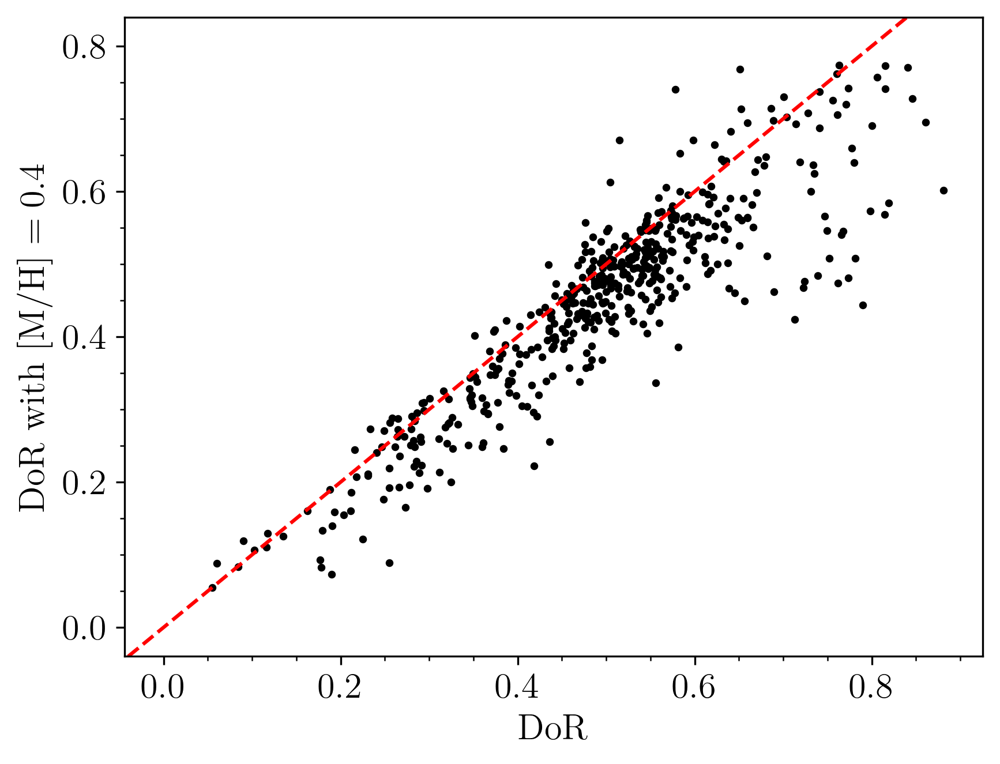

In [ ]:
fig, ax = plt.subplots()

ax.scatter(df['dor'], df_Z['dor'], c='k', s=5)
ax.set_xlabel('DoR')
ax.set_ylabel(r'DoR with $\textrm{[M/H]}=0.4$')
ax.minorticks_on()
ax.axline([0, 0], [0.8, 0.8], color='r', linestyle='--')

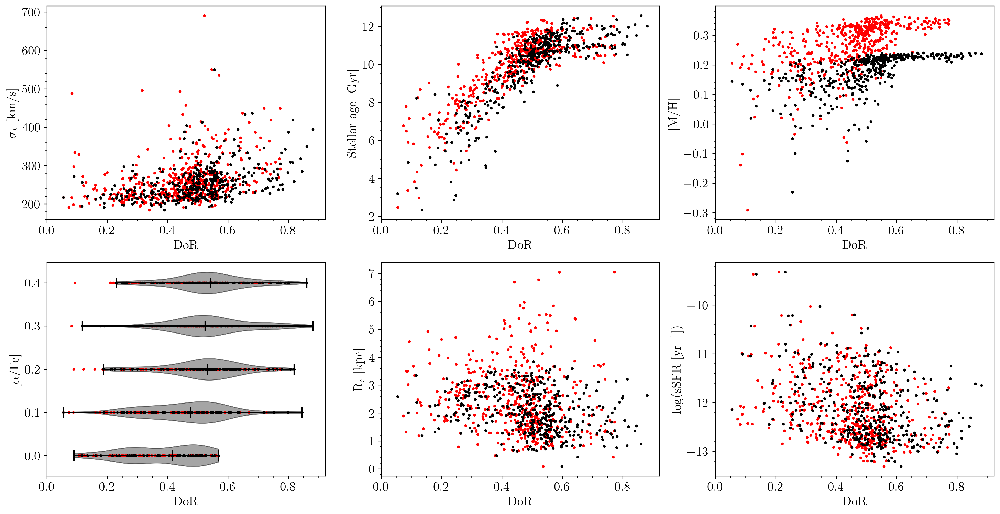

In [ ]:
fig, axs = plt.subplots(2, 3, figsize=(20, 10))

axs[0, 0].scatter(df_Z['dor'], df_Z['velDisp_ppxf'], s=5, c='r')
axs[0, 0].scatter(df['dor'], df['velDisp_ppxf'], s=5, c='k')
axs[0, 0].set_xlabel('DoR')
axs[0, 0].set_ylabel(r'$\sigma_{\star}$ [km/s]')
axs[0, 0].minorticks_on()
axs[0, 0].set_xticks([0., 0.2, 0.4, 0.6, 0.8]);

axs[0, 1].scatter(df_Z['dor'], 10**df_Z['logAge_mean']/(10**9), s=5, c='r')
axs[0, 1].scatter(df['dor'], df['age_mean'], s=5, c='k')
axs[0, 1].set_xlabel('DoR')
axs[0, 1].set_ylabel('Stellar age [Gyr]')
axs[0, 1].minorticks_on()
axs[0, 1].set_xticks([0., 0.2, 0.4, 0.6, 0.8]);

axs[0, 2].scatter(df_Z['dor'], df_Z['[M/H]_mean'], s=5, c='r')
axs[0, 2].scatter(df['dor'], df['[M/H]_mean'], s=5, c='k')
axs[0, 2].set_xlabel('DoR')
axs[0, 2].set_ylabel('[M/H]')
axs[0, 2].minorticks_on()
axs[0, 2].set_xticks([0., 0.2, 0.4, 0.6, 0.8]);

parts = axs[1, 0].violinplot(dor_alphas, vert=False, showmedians=True, positions=dor_alphas_label, widths=0.05)
for pc in parts['bodies']:
    pc.set_facecolor('0.3')
    pc.set_edgecolor('black')
    pc.set_alpha(0.5)
for partname in ('cbars','cmins','cmaxes','cmedians'):
    vp = parts[partname]
    vp.set_edgecolor('k')
axs[1, 0].scatter(df_Z['dor'], df_Z['alpha'], s=5, c='r')
axs[1, 0].scatter(df['dor'], df['alpha'], s=5, c='k')
axs[1, 0].set_ylabel(r'[$\alpha$/Fe]')
axs[1, 0].set_xlabel('DoR')
axs[1, 0].minorticks_on()
axs[1, 0].tick_params(axis='y', which='minor', left=False)
axs[1, 0].set_xticks([0., 0.2, 0.4, 0.6, 0.8]);


axs[1, 1].scatter(df_Z['dor'], df_Z['meanRadkpc_r'], s=5, c='r')
axs[1, 1].scatter(df['dor'], df['meanRadkpc_r'], s=5, c='k')
axs[1, 1].set_xlabel('DoR')
axs[1, 1].set_ylabel(r'$\rm R_{\rm e}$ [kpc]')
axs[1, 1].minorticks_on()
axs[1, 1].set_xticks([0., 0.2, 0.4, 0.6, 0.8]);

axs[1, 2].scatter(df_Z['dor'], df_Z['logsSFR'], s=5, c='r')
axs[1, 2].scatter(df['dor'], df['logsSFR'], s=5, c='k')
axs[1, 2].set_xlabel('DoR')
axs[1, 2].set_ylabel(r'$\log(\rm sSFR~[yr^{-1}])$')
axs[1, 2].minorticks_on()
axs[1, 2].set_xticks([0., 0.2, 0.4, 0.6, 0.8]);

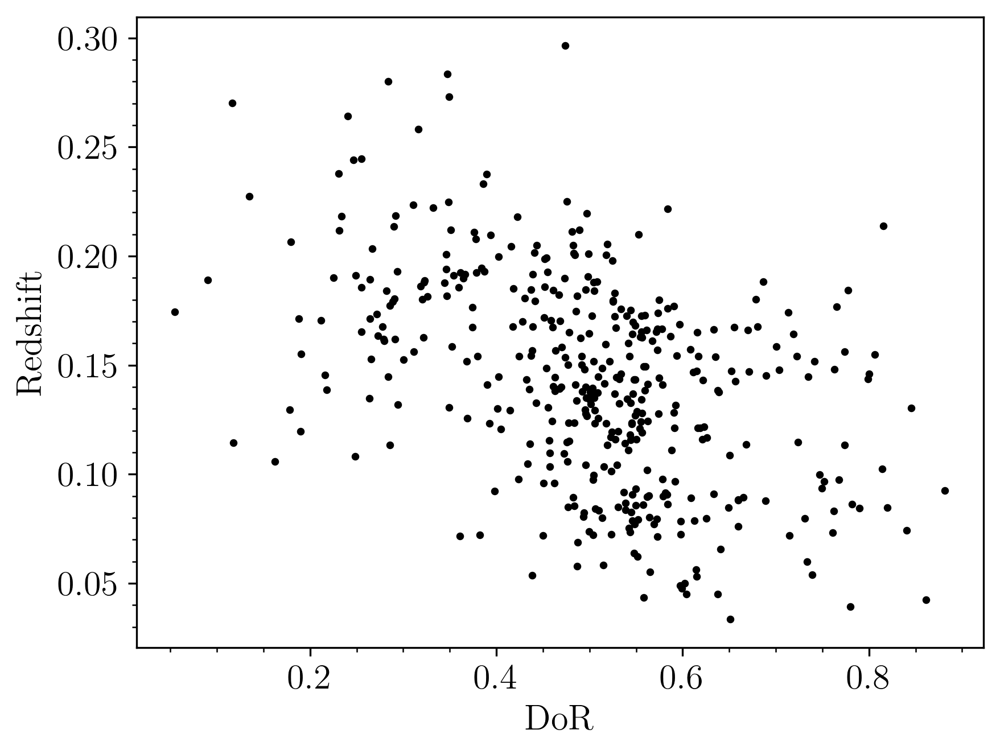

In [ ]:
fig, ax = plt.subplots()

ax.scatter(df['dor'], df['z'], c='k', s=5)
ax.set_xlabel('DoR')
ax.set_ylabel('Redshift')
ax.minorticks_on()


In [ ]:
df[df['dor'] > 0.3]['z'].min()

0.03359075

In [ ]:
print(len(df[df['dor'] < 0.3]))
print(len(df[df['dor'] > 0.6]))
print(430-56-81)

56
81
293


In [ ]:
print(df['dor'].min(), df['dor'].max())

0.0548987891568517 0.8813557976078031


In [ ]:
print(len(df[df['alpha_flag']!=0]))

116


In [ ]:
print(len(df[df['mass_frac']>0.75]))

359


In [ ]:
print(len(df[df['dor_mean'] < 0.3]))

16
